In [1]:
# Packages
import os
import pandas as pd
import numpy as np
import random
import torch
from sklearn.metrics import roc_auc_score
from opensoundscape.ml.shallow_classifier import quick_fit
import seaborn as sns
import matplotlib.pyplot as plt

from utils import create_train_sizes

In [2]:
# Parameters

SPECIES_LIST = ['human_vocal', 'engine', 'woodhouses_toad','pacific_chorus_frog','bullfrog','field_cricket','coyote']
AUDIO_DIR = "/Users/amy/Desktop/new_soundhub/audio"
RESULTS_DIR = "/Users/amy/Desktop/new_soundhub/results2"

MODEL_LIST = ['BirdNET', 'Perch']
BATCH_SIZE = 128
EPOCH = 'NA'
LEARNING_RATE = 'NA'

In [3]:
# Seed
torch.manual_seed(0)
random.seed(0)
np.random.seed(0)

In [4]:
for SPECIES in SPECIES_LIST:
    for MODEL in MODEL_LIST: 
        train_df = pd.read_csv(f"{AUDIO_DIR}/{SPECIES}/train_files.csv")
        test_df = pd.read_csv(f"{AUDIO_DIR}/{SPECIES}/test_files.csv")
        
        if MODEL == 'Perch':
            train_df['file'] = train_df['file'].str.replace('data', 'data_5s')
            test_df['file'] = test_df['file'].str.replace('data', 'data_5s')
            pd.set_option('display.max_colwidth', 100)
            print(train_df)
        train_df['file'] = train_df['file'].astype(str)
        test_df['file'] = test_df['file'].astype(str)
        
        train_df.set_index("file", inplace=True)
        test_df.set_index("file", inplace=True)
        
        # Create train sizes and store in a variable
        dataframes_list = create_train_sizes(train_df)

        # Load model
        model = torch.hub.load('kitzeslab/bioacoustics-model-zoo', MODEL, trust_repo=True)

        results = []

        # Iterate through train sizes and train/test
        for train_size, i in dataframes_list.items():
            train = pd.DataFrame(i)

            emb_train = model.embed(train, return_dfs=False, batch_size=BATCH_SIZE, num_workers=0)
            emb_val = model.embed(test_df, return_dfs=False, batch_size=BATCH_SIZE, num_workers=0)

            model.change_classes(['present'])

            quick_fit(model.network, emb_train, train.values, emb_val, test_df.values, steps=1000)

            predictions = model.network(torch.tensor(emb_val).float()).detach().numpy()
            score = roc_auc_score(test_df.values, predictions, average=None)

            results.append({'train_size': train_size, MODEL: score})

        # Train size 0 
        emb_val0 = model.embed(test_df, return_dfs=False, batch_size=BATCH_SIZE, num_workers=0)
        predictions0 = model.network(torch.tensor(emb_val0).float()).detach().numpy()
        score0 = roc_auc_score(test_df.values, predictions0, average=None)
        results.append({'train_size': 'train_size_0', MODEL: score0})

        results_df = pd.DataFrame(results)
        results_df.to_csv(f"{RESULTS_DIR}/{SPECIES}-{MODEL}-{BATCH_SIZE}-{EPOCH}-{LEARNING_RATE}.csv", index=False)

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main


File BirdNET_GLOBAL_6K_V2.4_Labels_af.txt already exists; skipping download.
downloading model from URL...
File BirdNET_GLOBAL_6K_V2.4_Model_FP16.tflite already exists; skipping download.


/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures module for examples of constructor functions
                    
  warnings.warn(
/opt/h

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.06020711734890938, Val Loss: 0.09622419625520706
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.025245485827326775, Val Loss: 0.07879675924777985
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.014486994594335556, Val Loss: 0.07699602097272873
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.00960073433816433, Val Loss: 0.07803474366664886
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.006913384422659874, Val Loss: 0.0798087865114212
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.005254628602415323, Val Loss: 0.08176456391811371
val AU ROC: 0.996
val MAP: 0.996
Epoch 700/1000, Loss: 0.004148345440626144, Val Loss: 0.08372315019369125
val AU ROC: 0.996
val MAP: 0.996
Epoch 800/1000, Loss: 0.0033683141227811575, Val Loss: 0.08562223613262177
val AU ROC: 0.996
val MAP: 0.996
Epoch 900/1000, Loss: 0.0027947076596319675, Val Loss: 0.0874420627951622
val AU ROC: 0.996
val MAP: 0.996
Epoch 1000/1000, Loss: 0.00235891342163

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05594277381896973, Val Loss: 0.09942563623189926
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.02318648062646389, Val Loss: 0.08415405452251434
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.013223499990999699, Val Loss: 0.083307646214962
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.008730093948543072, Val Loss: 0.08496101945638657
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.006270290818065405, Val Loss: 0.08719725906848907
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.004757029470056295, Val Loss: 0.08952771872282028
val AU ROC: 0.996
val MAP: 0.996
Epoch 700/1000, Loss: 0.0037502478808164597, Val Loss: 0.09180326759815216
val AU ROC: 0.996
val MAP: 0.996
Epoch 800/1000, Loss: 0.0030416983645409346, Val Loss: 0.09397833049297333
val AU ROC: 0.996
val MAP: 0.996
Epoch 900/1000, Loss: 0.0025214869529008865, Val Loss: 0.09604312479496002
val AU ROC: 0.996
val MAP: 0.996
Epoch 1000/1000, Loss: 0.0021267151460

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.053743876516819, Val Loss: 0.10853615403175354
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.02152521349489689, Val Loss: 0.09255699068307877
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.012142481282353401, Val Loss: 0.0906844288110733
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.007974966429173946, Val Loss: 0.09144521504640579
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.005710802040994167, Val Loss: 0.09291628003120422
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.004324076231569052, Val Loss: 0.09457910060882568
val AU ROC: 0.996
val MAP: 0.996
Epoch 700/1000, Loss: 0.0034041483886539936, Val Loss: 0.09626129269599915
val AU ROC: 0.996
val MAP: 0.996
Epoch 800/1000, Loss: 0.002758106216788292, Val Loss: 0.09790094941854477
val AU ROC: 0.996
val MAP: 0.996
Epoch 900/1000, Loss: 0.002284502610564232, Val Loss: 0.09947656840085983
val AU ROC: 0.996
val MAP: 0.996
Epoch 1000/1000, Loss: 0.0019255358492955

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05533141642808914, Val Loss: 0.0989803895354271
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.02186002768576145, Val Loss: 0.07877028733491898
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.01226845383644104, Val Loss: 0.07434036582708359
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.008035434409976006, Val Loss: 0.07313282787799835
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.005743852350860834, Val Loss: 0.07297595590353012
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.004343606065958738, Val Loss: 0.07324071228504181
val AU ROC: 0.996
val MAP: 0.996
Epoch 700/1000, Loss: 0.003416299819946289, Val Loss: 0.07369253784418106
val AU ROC: 0.996
val MAP: 0.996
Epoch 800/1000, Loss: 0.002765828976407647, Val Loss: 0.07422975450754166
val AU ROC: 0.996
val MAP: 0.996
Epoch 900/1000, Loss: 0.0022894730791449547, Val Loss: 0.07480403780937195
val AU ROC: 0.996
val MAP: 0.996
Epoch 1000/1000, Loss: 0.001928718877024

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.048715025186538696, Val Loss: 0.14532925188541412
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.018958400934934616, Val Loss: 0.13394512236118317
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.010596910491585732, Val Loss: 0.1350582242012024
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.006927101872861385, Val Loss: 0.1380656212568283
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.004945623222738504, Val Loss: 0.1413668543100357
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.0037367362529039383, Val Loss: 0.14458924531936646
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.0029370763804763556, Val Loss: 0.1476396769285202
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.002376582007855177, Val Loss: 0.15050430595874786
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.0019663891289383173, Val Loss: 0.15319347381591797
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.0016558964271

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0386662557721138, Val Loss: 0.16807959973812103
val AU ROC: 0.992
val MAP: 0.992
Epoch 200/1000, Loss: 0.014951859600841999, Val Loss: 0.14676588773727417
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.008352359756827354, Val Loss: 0.1425599902868271
val AU ROC: 0.992
val MAP: 0.992
Epoch 400/1000, Loss: 0.00545943807810545, Val Loss: 0.14222392439842224
val AU ROC: 0.992
val MAP: 0.992
Epoch 500/1000, Loss: 0.0038978278171271086, Val Loss: 0.14319337904453278
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.0029451691079884768, Val Loss: 0.1446750909090042
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.0023148979526013136, Val Loss: 0.14636307954788208
val AU ROC: 0.992
val MAP: 0.992
Epoch 800/1000, Loss: 0.0018731545424088836, Val Loss: 0.14812347292900085
val AU ROC: 0.992
val MAP: 0.992
Epoch 900/1000, Loss: 0.0015498778084293008, Val Loss: 0.14989331364631653
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.001305104000

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

                                                                                             file  \
0    /Users/amy/Desktop/new_soundhub/audio/human_vocal/data_5s/neg/human_vocal-neg-humvoc_117.wav   
1    /Users/amy/Desktop/new_soundhub/audio/human_vocal/data_5s/neg/human_vocal-neg-humvoc_158.wav   
2    /Users/amy/Desktop/new_soundhub/audio/human_vocal/data_5s/neg/human_vocal-neg-humvoc_604.wav   
3    /Users/amy/Desktop/new_soundhub/audio/human_vocal/data_5s/neg/human_vocal-neg-humvoc_453.wav   
4    /Users/amy/Desktop/new_soundhub/audio/human_vocal/data_5s/neg/human_vocal-neg-humvoc_164.wav   
..                                                                                            ...   
115  /Users/amy/Desktop/new_soundhub/audio/human_vocal/data_5s/pos/human_vocal-pos-humvoc_210.wav   
116  /Users/amy/Desktop/new_soundhub/audio/human_vocal/data_5s/pos/human_vocal-pos-humvoc_494.wav   
117  /Users/amy/Desktop/new_soundhub/audio/human_vocal/data_5s/pos/human_vocal-pos-humvoc_5

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/tensorflow_hub/__init__.py:61: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import parse_version
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function 

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:08:18.233151: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x3b0e1a130 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2025-01-29 14:08:18.233170: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version
2025-01-29 14:08:18.469047: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-01-29 14:08:18.476334: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
2025-01-29 14:08:20.125233: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
2025-01-29 14:08:20.140896: E ./tensorflow/compiler/xla/stream_executor/stream_executor_internal.h:124] SetPriority unimplemented for this stream.
/opt/homeb

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:08:43.682904: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert


Epoch 100/1000, Loss: 0.3183576464653015, Val Loss: 0.31997150182724
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.1820128858089447, Val Loss: 0.21046440303325653
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.11940046399831772, Val Loss: 0.16599208116531372
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.08509746938943863, Val Loss: 0.1439703404903412
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.06408081203699112, Val Loss: 0.13181935250759125
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.05017963424324989, Val Loss: 0.12472211569547653
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.040458012372255325, Val Loss: 0.12048343569040298
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.033364955335855484, Val Loss: 0.11797712743282318
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.02801431529223919, Val Loss: 0.11657500267028809
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.02386798895895481, Val Lo

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:08:54.384650: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.31122732162475586, Val Loss: 0.3164484202861786
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.17635127902030945, Val Loss: 0.20446690917015076
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.11490759998559952, Val Loss: 0.1584719568490982
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.08149364590644836, Val Loss: 0.13568493723869324
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06114403158426285, Val Loss: 0.12327302992343903
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.0477481335401535, Val Loss: 0.11619699746370316
val AU ROC: 0.996
val MAP: 0.996
Epoch 700/1000, Loss: 0.038415614515542984, Val Loss: 0.11212535202503204
val AU ROC: 0.996
val MAP: 0.996
Epoch 800/1000, Loss: 0.03162738308310509, Val Loss: 0.10985641181468964
val AU ROC: 0.996
val MAP: 0.996
Epoch 900/1000, Loss: 0.026519475504755974, Val Loss: 0.10872136056423187
val AU ROC: 0.996
val MAP: 0.996
Epoch 1000/1000, Loss: 0.02256936952471733, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:09:25.763389: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.30384060740470886, Val Loss: 0.34525468945503235
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.16877348721027374, Val Loss: 0.2565509080886841
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.10836581885814667, Val Loss: 0.24098606407642365
val AU ROC: 0.992
val MAP: 0.992
Epoch 400/1000, Loss: 0.07598300278186798, Val Loss: 0.24969755113124847
val AU ROC: 0.988
val MAP: 0.988
Epoch 500/1000, Loss: 0.0565108060836792, Val Loss: 0.266719788312912
val AU ROC: 0.988
val MAP: 0.988
Epoch 600/1000, Loss: 0.04382964223623276, Val Loss: 0.2862958014011383
val AU ROC: 0.988
val MAP: 0.988
Epoch 700/1000, Loss: 0.0350729338824749, Val Loss: 0.3062498867511749
val AU ROC: 0.988
val MAP: 0.988
Epoch 800/1000, Loss: 0.028749611228704453, Val Loss: 0.32574257254600525
val AU ROC: 0.984
val MAP: 0.984
Epoch 900/1000, Loss: 0.024019993841648102, Val Loss: 0.34446537494659424
val AU ROC: 0.975
val MAP: 0.975
Epoch 1000/1000, Loss: 0.020380698144435883, Val Lo

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:09:53.806488: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.3087104558944702, Val Loss: 0.34571048617362976
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.1710921972990036, Val Loss: 0.2526475191116333
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.10926250368356705, Val Loss: 0.23460513353347778
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.07623043656349182, Val Loss: 0.2408965677022934
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.056461628526449203, Val Loss: 0.25571030378341675
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.04364517703652382, Val Loss: 0.27342525124549866
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.0348300002515316, Val Loss: 0.2918452024459839
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.02848607301712036, Val Loss: 0.31006452441215515
val AU ROC: 0.987
val MAP: 0.987
Epoch 900/1000, Loss: 0.02375481277704239, Val Loss: 0.3277128338813782
val AU ROC: 0.987
val MAP: 0.987
Epoch 1000/1000, Loss: 0.020123371854424477, Val Los

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:10:17.928997: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.28134042024612427, Val Loss: 0.33793869614601135
val AU ROC: 0.992
val MAP: 0.992
Epoch 200/1000, Loss: 0.14889565110206604, Val Loss: 0.23274898529052734
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.09284156560897827, Val Loss: 0.1910528689622879
val AU ROC: 0.992
val MAP: 0.992
Epoch 400/1000, Loss: 0.06387053430080414, Val Loss: 0.17066441476345062
val AU ROC: 0.992
val MAP: 0.992
Epoch 500/1000, Loss: 0.04688204079866409, Val Loss: 0.15940386056900024
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.03601643070578575, Val Loss: 0.15271587669849396
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.028613930568099022, Val Loss: 0.14857633411884308
val AU ROC: 0.992
val MAP: 0.992
Epoch 800/1000, Loss: 0.023323724046349525, Val Loss: 0.1459706872701645
val AU ROC: 0.992
val MAP: 0.992
Epoch 900/1000, Loss: 0.019399266690015793, Val Loss: 0.14434316754341125
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.016399454325437546, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:10:37.896521: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2505878210067749, Val Loss: 0.3510057330131531
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.12472202628850937, Val Loss: 0.24881596863269806
val AU ROC: 0.988
val MAP: 0.988
Epoch 300/1000, Loss: 0.07516276836395264, Val Loss: 0.20628853142261505
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.05068141967058182, Val Loss: 0.18476428091526031
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.0367332324385643, Val Loss: 0.1725427210330963
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.027980968356132507, Val Loss: 0.16510505974292755
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.02209678664803505, Val Loss: 0.16039392352104187
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.017931759357452393, Val Loss: 0.15735647082328796
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.014864069409668446, Val Loss: 0.15540525317192078
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.012532112188637257, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

File BirdNET_GLOBAL_6K_V2.4_Labels_af.txt already exists; skipping download.
downloading model from URL...
File BirdNET_GLOBAL_6K_V2.4_Model_FP16.tflite already exists; skipping download.


Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1553480178117752, Val Loss: 0.13812203705310822
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08215726912021637, Val Loss: 0.0960598960518837
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.050944603979587555, Val Loss: 0.08100668340921402
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03477555140852928, Val Loss: 0.07419192045927048
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.02534855343401432, Val Loss: 0.07104021310806274
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.019363172352313995, Val Loss: 0.06976602971553802
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.015313480980694294, Val Loss: 0.06953456252813339
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.012436594814062119, Val Loss: 0.06991424411535263
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.010313199833035469, Val Loss: 0.07066571712493896
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.008697074837982655

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.13927137851715088, Val Loss: 0.13587144017219543
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.07035613059997559, Val Loss: 0.10731955617666245
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.0427485890686512, Val Loss: 0.10068453848361969
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.02892044000327587, Val Loss: 0.09992850571870804
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.020988136529922485, Val Loss: 0.10130906105041504
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.015994707122445107, Val Loss: 0.10355500876903534
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.012632493861019611, Val Loss: 0.10615233331918716
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.010251049883663654, Val Loss: 0.10887150466442108
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.008496586233377457, Val Loss: 0.11160445213317871
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00716285035014152

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.11357418447732925, Val Loss: 0.1361750364303589
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.052906256169080734, Val Loss: 0.10056006908416748
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.03128805384039879, Val Loss: 0.08806058019399643
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.02094678021967411, Val Loss: 0.08169694989919662
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.015134441666305065, Val Loss: 0.07782337069511414
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.011511585675179958, Val Loss: 0.07520192861557007
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.009084620513021946, Val Loss: 0.07329946756362915
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.007370223291218281, Val Loss: 0.0718492865562439
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.006108949892222881, Val Loss: 0.07070315629243851
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00515079731121659

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.11115186661481857, Val Loss: 0.14479833841323853
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.05101905018091202, Val Loss: 0.1093982681632042
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.029944494366645813, Val Loss: 0.09705297648906708
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.019963739439845085, Val Loss: 0.09106343239545822
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.01438821293413639, Val Loss: 0.08764661103487015
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.010926400311291218, Val Loss: 0.08550753444433212
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.008613395504653454, Val Loss: 0.08408970385789871
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.00698239728808403, Val Loss: 0.08311633765697479
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.00578408595174551, Val Loss: 0.08243478089570999
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.004874737933278084

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.12430515140295029, Val Loss: 0.19845208525657654
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.056142497807741165, Val Loss: 0.17286285758018494
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.03270171210169792, Val Loss: 0.16773177683353424
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.02172071486711502, Val Loss: 0.1673048436641693
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.015622274950146675, Val Loss: 0.1684112846851349
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.011848801746964455, Val Loss: 0.1700882911682129
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.00933296699076891, Val Loss: 0.17197738587856293
val AU ROC: 0.995
val MAP: 0.995
Epoch 800/1000, Loss: 0.007561623118817806, Val Loss: 0.1739281564950943
val AU ROC: 0.995
val MAP: 0.995
Epoch 900/1000, Loss: 0.006261483766138554, Val Loss: 0.17587344348430634
val AU ROC: 0.995
val MAP: 0.995
Epoch 1000/1000, Loss: 0.005275518633425236, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.08307426422834396, Val Loss: 0.20102421939373016
val AU ROC: 0.995
val MAP: 0.995
Epoch 200/1000, Loss: 0.03498050197958946, Val Loss: 0.18111595511436462
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.019899262115359306, Val Loss: 0.174941748380661
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.01308158878237009, Val Loss: 0.17223785817623138
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.009359725750982761, Val Loss: 0.17088741064071655
val AU ROC: 0.995
val MAP: 0.995
Epoch 600/1000, Loss: 0.007078121416270733, Val Loss: 0.17018626630306244
val AU ROC: 0.995
val MAP: 0.995
Epoch 700/1000, Loss: 0.005565290339291096, Val Loss: 0.16983816027641296
val AU ROC: 0.995
val MAP: 0.995
Epoch 800/1000, Loss: 0.004503769334405661, Val Loss: 0.1696987748146057
val AU ROC: 0.995
val MAP: 0.995
Epoch 900/1000, Loss: 0.0037264295388013124, Val Loss: 0.16969053447246552
val AU ROC: 0.993
val MAP: 0.993
Epoch 1000/1000, Loss: 0.00313785835169255

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.07203912734985352, Val Loss: 0.2942260205745697
val AU ROC: 0.968
val MAP: 0.968
Epoch 200/1000, Loss: 0.02931584045290947, Val Loss: 0.27775734663009644
val AU ROC: 0.970
val MAP: 0.970
Epoch 300/1000, Loss: 0.01648326776921749, Val Loss: 0.2739907503128052
val AU ROC: 0.972
val MAP: 0.972
Epoch 400/1000, Loss: 0.010781369172036648, Val Loss: 0.27340197563171387
val AU ROC: 0.979
val MAP: 0.979
Epoch 500/1000, Loss: 0.007693686988204718, Val Loss: 0.27393922209739685
val AU ROC: 0.979
val MAP: 0.979
Epoch 600/1000, Loss: 0.005809216760098934, Val Loss: 0.27494269609451294
val AU ROC: 0.979
val MAP: 0.979
Epoch 700/1000, Loss: 0.004562978632748127, Val Loss: 0.27615028619766235
val AU ROC: 0.977
val MAP: 0.977
Epoch 800/1000, Loss: 0.0036900811828672886, Val Loss: 0.2774439752101898
val AU ROC: 0.979
val MAP: 0.979
Epoch 900/1000, Loss: 0.0030516390688717365, Val Loss: 0.2787668704986572
val AU ROC: 0.979
val MAP: 0.979
Epoch 1000/1000, Loss: 0.00256868684664368

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0286252498626709, Val Loss: 0.2752392888069153
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.011157047003507614, Val Loss: 0.25293976068496704
val AU ROC: 0.988
val MAP: 0.988
Epoch 300/1000, Loss: 0.006251011975109577, Val Loss: 0.2457762062549591
val AU ROC: 0.988
val MAP: 0.988
Epoch 400/1000, Loss: 0.004092031624168158, Val Loss: 0.2426917850971222
val AU ROC: 0.987
val MAP: 0.987
Epoch 500/1000, Loss: 0.0029241666197776794, Val Loss: 0.24126383662223816
val AU ROC: 0.987
val MAP: 0.987
Epoch 600/1000, Loss: 0.00221078610047698, Val Loss: 0.2406516969203949
val AU ROC: 0.987
val MAP: 0.987
Epoch 700/1000, Loss: 0.0017383832018822432, Val Loss: 0.24048998951911926
val AU ROC: 0.987
val MAP: 0.987
Epoch 800/1000, Loss: 0.00140707241371274, Val Loss: 0.24059665203094482
val AU ROC: 0.987
val MAP: 0.987
Epoch 900/1000, Loss: 0.0011644790647551417, Val Loss: 0.24087128043174744
val AU ROC: 0.987
val MAP: 0.987
Epoch 1000/1000, Loss: 0.00098077568691223

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

                                                                                   file  \
0    /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/neg/engine-neg-engine_506.wav   
1    /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/neg/engine-neg-engine_116.wav   
2    /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/neg/engine-neg-engine_517.wav   
3    /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/neg/engine-neg-engine_243.wav   
4    /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/neg/engine-neg-engine_467.wav   
..                                                                                  ...   
155   /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/pos/engine-pos-engine_73.wav   
156  /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/pos/engine-pos-engine_340.wav   
157  /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/pos/engine-pos-engine_631.wav   
158  /Users/amy/Desktop/new_soundhub/audio/engine/data_5s/pos/engine-pos-engine_117.wav   

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

  0%|          | 0/2 [00:00<?, ?it/s]

2025-01-29 14:11:59.491178: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
2025-01-29 14:12:25.276813: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:12:36.350142: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert


Epoch 100/1000, Loss: 0.4442720413208008, Val Loss: 0.3904493451118469
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.33347639441490173, Val Loss: 0.2831486463546753
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.26813656091690063, Val Loss: 0.2280525267124176
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.22387513518333435, Val Loss: 0.19486145675182343
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.19138455390930176, Val Loss: 0.17312735319137573
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.16629283130168915, Val Loss: 0.15816818177700043
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.14623703062534332, Val Loss: 0.14752760529518127
val AU ROC: 0.990
val MAP: 0.990
Epoch 800/1000, Loss: 0.12980444729328156, Val Loss: 0.1397877037525177
val AU ROC: 0.990
val MAP: 0.990
Epoch 900/1000, Loss: 0.11608630418777466, Val Loss: 0.13407805562019348
val AU ROC: 0.990
val MAP: 0.990
Epoch 1000/1000, Loss: 0.10446520149707794, Val Los

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

2025-01-29 14:13:12.233968: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.440175861120224, Val Loss: 0.39036503434181213
val AU ROC: 0.993
val MAP: 0.993
Epoch 200/1000, Loss: 0.32729190587997437, Val Loss: 0.2812284231185913
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.26101016998291016, Val Loss: 0.226758673787117
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.21625636518001556, Val Loss: 0.19478215277194977
val AU ROC: 0.992
val MAP: 0.992
Epoch 500/1000, Loss: 0.1835130900144577, Val Loss: 0.17424342036247253
val AU ROC: 0.987
val MAP: 0.987
Epoch 600/1000, Loss: 0.1583200842142105, Val Loss: 0.16037777066230774
val AU ROC: 0.987
val MAP: 0.987
Epoch 700/1000, Loss: 0.13826777040958405, Val Loss: 0.1507638841867447
val AU ROC: 0.987
val MAP: 0.987
Epoch 800/1000, Loss: 0.12191414088010788, Val Loss: 0.1440192312002182
val AU ROC: 0.984
val MAP: 0.984
Epoch 900/1000, Loss: 0.1083291694521904, Val Loss: 0.1392877995967865
val AU ROC: 0.984
val MAP: 0.984
Epoch 1000/1000, Loss: 0.09687892347574234, Val Loss: 0.1

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:13:28.309769: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.4383905231952667, Val Loss: 0.3866395354270935
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.32195165753364563, Val Loss: 0.27187013626098633
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.2529773414134979, Val Loss: 0.21420764923095703
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.20627164840698242, Val Loss: 0.18042701482772827
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.17217038571834564, Val Loss: 0.15876837074756622
val AU ROC: 0.995
val MAP: 0.995
Epoch 600/1000, Loss: 0.1461019515991211, Val Loss: 0.14412549138069153
val AU ROC: 0.995
val MAP: 0.995
Epoch 700/1000, Loss: 0.12555494904518127, Val Loss: 0.1339162141084671
val AU ROC: 0.990
val MAP: 0.990
Epoch 800/1000, Loss: 0.10899841040372849, Val Loss: 0.1266770362854004
val AU ROC: 0.990
val MAP: 0.990
Epoch 900/1000, Loss: 0.09542972594499588, Val Loss: 0.12150935083627701
val AU ROC: 0.987
val MAP: 0.987
Epoch 1000/1000, Loss: 0.08415759354829788, Val Loss

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:14:02.366615: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.43611422181129456, Val Loss: 0.39671558141708374
val AU ROC: 0.995
val MAP: 0.995
Epoch 200/1000, Loss: 0.3140708804130554, Val Loss: 0.2855025827884674
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.24262572824954987, Val Loss: 0.22957904636859894
val AU ROC: 0.990
val MAP: 0.990
Epoch 400/1000, Loss: 0.19521766901016235, Val Loss: 0.19678306579589844
val AU ROC: 0.990
val MAP: 0.990
Epoch 500/1000, Loss: 0.1613065004348755, Val Loss: 0.17577804625034332
val AU ROC: 0.987
val MAP: 0.987
Epoch 600/1000, Loss: 0.13582497835159302, Val Loss: 0.16161616146564484
val AU ROC: 0.987
val MAP: 0.987
Epoch 700/1000, Loss: 0.11600589752197266, Val Loss: 0.15178334712982178
val AU ROC: 0.987
val MAP: 0.987
Epoch 800/1000, Loss: 0.10019776225090027, Val Loss: 0.1448558270931244
val AU ROC: 0.987
val MAP: 0.987
Epoch 900/1000, Loss: 0.08734579384326935, Val Loss: 0.13996276259422302
val AU ROC: 0.987
val MAP: 0.987
Epoch 1000/1000, Loss: 0.07673883438110352, Val Lo

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:14:34.327077: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.42475342750549316, Val Loss: 0.3957813084125519
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.3023320734500885, Val Loss: 0.2858344614505768
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.23108255863189697, Val Loss: 0.23074448108673096
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.1840197890996933, Val Loss: 0.1985175460577011
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.15056836605072021, Val Loss: 0.17794980108737946
val AU ROC: 0.995
val MAP: 0.995
Epoch 600/1000, Loss: 0.125616192817688, Val Loss: 0.16407376527786255
val AU ROC: 0.995
val MAP: 0.995
Epoch 700/1000, Loss: 0.10636912286281586, Val Loss: 0.15434958040714264
val AU ROC: 0.995
val MAP: 0.995
Epoch 800/1000, Loss: 0.09115592390298843, Val Loss: 0.14735466241836548
val AU ROC: 0.992
val MAP: 0.992
Epoch 900/1000, Loss: 0.07890389859676361, Val Loss: 0.14223814010620117
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.06888653337955475, Val Loss:

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:15:02.414507: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.4095419943332672, Val Loss: 0.4205206036567688
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.28852325677871704, Val Loss: 0.3131777346134186
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.22106964886188507, Val Loss: 0.2584957480430603
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.1768704503774643, Val Loss: 0.22589559853076935
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.1451825201511383, Val Loss: 0.20457331836223602
val AU ROC: 0.990
val MAP: 0.990
Epoch 600/1000, Loss: 0.1212775930762291, Val Loss: 0.1897694170475006
val AU ROC: 0.990
val MAP: 0.990
Epoch 700/1000, Loss: 0.10267610847949982, Val Loss: 0.17907001078128815
val AU ROC: 0.990
val MAP: 0.990
Epoch 800/1000, Loss: 0.08789246529340744, Val Loss: 0.17111973464488983
val AU ROC: 0.990
val MAP: 0.990
Epoch 900/1000, Loss: 0.07595272362232208, Val Loss: 0.16509683430194855
val AU ROC: 0.990
val MAP: 0.990
Epoch 1000/1000, Loss: 0.06618119031190872, Val Loss: 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.35610276460647583, Val Loss: 0.48907288908958435
val AU ROC: 0.938
val MAP: 0.938
Epoch 200/1000, Loss: 0.22198092937469482, Val Loss: 0.42196744680404663
val AU ROC: 0.947
val MAP: 0.947
Epoch 300/1000, Loss: 0.1544845998287201, Val Loss: 0.39538806676864624
val AU ROC: 0.952
val MAP: 0.952
Epoch 400/1000, Loss: 0.11431331932544708, Val Loss: 0.38142600655555725
val AU ROC: 0.954
val MAP: 0.954
Epoch 500/1000, Loss: 0.08809497207403183, Val Loss: 0.37286895513534546
val AU ROC: 0.957
val MAP: 0.957
Epoch 600/1000, Loss: 0.06995826214551926, Val Loss: 0.36724942922592163
val AU ROC: 0.959
val MAP: 0.959
Epoch 700/1000, Loss: 0.05687712877988815, Val Loss: 0.3634641170501709
val AU ROC: 0.959
val MAP: 0.959
Epoch 800/1000, Loss: 0.04713049530982971, Val Loss: 0.3609146177768707
val AU ROC: 0.959
val MAP: 0.959
Epoch 900/1000, Loss: 0.039673030376434326, Val Loss: 0.35923656821250916
val AU ROC: 0.959
val MAP: 0.959
Epoch 1000/1000, Loss: 0.03383878245949745, Val 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-29 14:15:47.310601: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2755488455295563, Val Loss: 0.5007461309432983
val AU ROC: 0.922
val MAP: 0.922
Epoch 200/1000, Loss: 0.14509382843971252, Val Loss: 0.4363431930541992
val AU ROC: 0.925
val MAP: 0.925
Epoch 300/1000, Loss: 0.08951560407876968, Val Loss: 0.4109223783016205
val AU ROC: 0.929
val MAP: 0.929
Epoch 400/1000, Loss: 0.06101340055465698, Val Loss: 0.40028271079063416
val AU ROC: 0.930
val MAP: 0.930
Epoch 500/1000, Loss: 0.0444660522043705, Val Loss: 0.3961903154850006
val AU ROC: 0.930
val MAP: 0.930
Epoch 600/1000, Loss: 0.03397512063384056, Val Loss: 0.39534083008766174
val AU ROC: 0.930
val MAP: 0.930
Epoch 700/1000, Loss: 0.026878919452428818, Val Loss: 0.3962256908416748
val AU ROC: 0.931
val MAP: 0.931
Epoch 800/1000, Loss: 0.021836888045072556, Val Loss: 0.398086816072464
val AU ROC: 0.934
val MAP: 0.934
Epoch 900/1000, Loss: 0.01811394840478897, Val Loss: 0.4005144536495209
val AU ROC: 0.934
val MAP: 0.934
Epoch 1000/1000, Loss: 0.015279209241271019, Val Loss:

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

File BirdNET_GLOBAL_6K_V2.4_Labels_af.txt already exists; skipping download.
downloading model from URL...
File BirdNET_GLOBAL_6K_V2.4_Model_FP16.tflite already exists; skipping download.


/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.024755334481596947, Val Loss: 0.038487594574689865
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.01099256332963705, Val Loss: 0.026135677471756935
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.006502331700176001, Val Loss: 0.021607903763651848
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.0043930537067353725, Val Loss: 0.019228974357247353
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0032073035836219788, Val Loss: 0.017732039093971252
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0024637016467750072, Val Loss: 0.01668286696076393
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.001961636124178767, Val Loss: 0.015893856063485146
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.001604079850949347, Val Loss: 0.015270804055035114
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0013389445375651121, Val Loss: 0.014761088415980339
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0243770033121109, Val Loss: 0.04204794764518738
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.010821852833032608, Val Loss: 0.029615771025419235
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.006400140002369881, Val Loss: 0.024815641343593597
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004323246423155069, Val Loss: 0.022212624549865723
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0031557364854961634, Val Loss: 0.0205351822078228
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0024236440658569336, Val Loss: 0.01933731511235237
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0019293861696496606, Val Loss: 0.01842299848794937
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0015774454222992063, Val Loss: 0.01769234426319599
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.001316529931500554, Val Loss: 0.017088748514652252
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0011168

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.027204785495996475, Val Loss: 0.04125535488128662
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.012202336452901363, Val Loss: 0.028531622141599655
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.00725030479952693, Val Loss: 0.023785360157489777
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004908938426524401, Val Loss: 0.021289905533194542
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003588056657463312, Val Loss: 0.019723357632756233
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.002758017275482416, Val Loss: 0.0186271071434021
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0021968658547848463, Val Loss: 0.01780303381383419
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0017969053005799651, Val Loss: 0.017152097076177597
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0015001794090494514, Val Loss: 0.01661905273795128
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.001273

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0258010420948267, Val Loss: 0.04157911241054535
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.011523734778165817, Val Loss: 0.028750816360116005
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.0068181888200342655, Val Loss: 0.023889299482107162
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004603423178195953, Val Loss: 0.021327614784240723
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0033582616597414017, Val Loss: 0.019715690985322
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.002577774925157428, Val Loss: 0.01858452707529068
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.002051116432994604, Val Loss: 0.017731916159391403
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.001676273881457746, Val Loss: 0.017056649550795555
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0013985042460262775, Val Loss: 0.016502469778060913
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0011860

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.02938632294535637, Val Loss: 0.04433385655283928
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.013356061652302742, Val Loss: 0.030598023906350136
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.007987935096025467, Val Loss: 0.025330539792776108
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.005426916293799877, Val Loss: 0.022542856633663177
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003974576946347952, Val Loss: 0.02080634981393814
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.003059021895751357, Val Loss: 0.01960490271449089
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.002438803669065237, Val Loss: 0.018711518496274948
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0019961127545684576, Val Loss: 0.018011998385190964
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0016673555364832282, Val Loss: 0.017442993819713593
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00141

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0326898954808712, Val Loss: 0.04654066264629364
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.014931383542716503, Val Loss: 0.030981868505477905
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.008957266807556152, Val Loss: 0.025047635659575462
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.006099381484091282, Val Loss: 0.021931253373622894
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.004475007764995098, Val Loss: 0.020012229681015015
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0034490383695811033, Val Loss: 0.018701378256082535
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.002752856118604541, Val Loss: 0.017738761380314827
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.002255253493785858, Val Loss: 0.016993770375847816
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.001885244040749967, Val Loss: 0.01639406941831112
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.001601

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.029141001403331757, Val Loss: 0.04480656981468201
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.013089367188513279, Val Loss: 0.03095509298145771
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.007767427247017622, Val Loss: 0.0257718525826931
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.005252161528915167, Val Loss: 0.023075509816408157
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003834693692624569, Val Loss: 0.021402591839432716
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0029449036810547113, Val Loss: 0.020243726670742035
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.002343930769711733, Val Loss: 0.01937997341156006
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.001915921806357801, Val Loss: 0.01870235800743103
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0015986365033313632, Val Loss: 0.01815059408545494
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00135587

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.02790483832359314, Val Loss: 0.041989099234342575
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.012350726872682571, Val Loss: 0.027869857847690582
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.0072847087867558, Val Loss: 0.02270089089870453
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.0049115135334432125, Val Loss: 0.020011257380247116
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0035801499616354704, Val Loss: 0.018332183361053467
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0027465715538710356, Val Loss: 0.017162684351205826
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0021844797302037477, Val Loss: 0.016287848353385925
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0017846322152763605, Val Loss: 0.015600103884935379
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.001488428795710206, Val Loss: 0.015039658173918724
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.02787105366587639, Val Loss: 0.044161904603242874
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.01249142549932003, Val Loss: 0.03016066923737526
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.007411247119307518, Val Loss: 0.025067457929253578
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.00501195527613163, Val Loss: 0.0224341731518507
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003659519599750638, Val Loss: 0.020801657810807228
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0028102907817810774, Val Loss: 0.01967051811516285
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.002236568368971348, Val Loss: 0.018826870247721672
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0018279373180121183, Val Loss: 0.018164468929171562
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0015249693533405662, Val Loss: 0.017624493688344955
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0012931

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.027718670666217804, Val Loss: 0.04155049845576286
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.012492921203374863, Val Loss: 0.028203481808304787
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.007395982276648283, Val Loss: 0.02334546484053135
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004990289453417063, Val Loss: 0.020883934572339058
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003637234680354595, Val Loss: 0.019386913627386093
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0027893460355699062, Val Loss: 0.018366102129220963
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0022175265476107597, Val Loss: 0.017614789307117462
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0018107794458046556, Val Loss: 0.017031345516443253
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0015095843700692058, Val Loss: 0.016560185700654984
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.024889159947633743, Val Loss: 0.04023950546979904
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.010895256884396076, Val Loss: 0.026664743199944496
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.006404513027518988, Val Loss: 0.021623609587550163
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004311906173825264, Val Loss: 0.01894468627870083
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003140215529128909, Val Loss: 0.01724640093743801
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0024072907399386168, Val Loss: 0.016052348539233208
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.00191340665332973, Val Loss: 0.015154445543885231
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0015622228384017944, Val Loss: 0.014446825720369816
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0013021999038755894, Val Loss: 0.013869591988623142
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0011

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.027561895549297333, Val Loss: 0.043364688754081726
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.012294957414269447, Val Loss: 0.028459539636969566
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.007267845328897238, Val Loss: 0.022820640355348587
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004906821064651012, Val Loss: 0.01985396444797516
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0035794333089143038, Val Loss: 0.017997127026319504
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0027470134664326906, Val Loss: 0.016705365851521492
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0021851002238690853, Val Loss: 0.01574179343879223
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0017850479343906045, Val Loss: 0.014986922033131123
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.00148861319757998, Val Loss: 0.0143739003688097
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0012

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.02678554877638817, Val Loss: 0.04360219091176987
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.011749956756830215, Val Loss: 0.028934186324477196
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.00690575921908021, Val Loss: 0.023609373718500137
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.0046482873149216175, Val Loss: 0.020833831280469894
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003384440205991268, Val Loss: 0.019095394760370255
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0025939871557056904, Val Loss: 0.017881646752357483
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0020614105742424726, Val Loss: 0.016972314566373825
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0016827731160447001, Val Loss: 0.016256796196103096
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0014024999691173434, Val Loss: 0.015673307701945305
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.024985402822494507, Val Loss: 0.04092848300933838
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.010935195721685886, Val Loss: 0.027763934805989265
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.006421722937375307, Val Loss: 0.023000452667474747
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004321360029280186, Val Loss: 0.02052583172917366
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003145987167954445, Val Loss: 0.018978124484419823
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0024109443183988333, Val Loss: 0.01789807714521885
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0019157363567501307, Val Loss: 0.01708889566361904
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.001563692232593894, Val Loss: 0.016452068462967873
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0013031023554503918, Val Loss: 0.015932602807879448
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0011

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.028459643945097923, Val Loss: 0.04535158723592758
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.012525658123195171, Val Loss: 0.030274594202637672
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.007365325931459665, Val Loss: 0.024805249646306038
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004961414262652397, Val Loss: 0.022010527551174164
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003615317400544882, Val Loss: 0.020295696333050728
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.002772932406514883, Val Loss: 0.019119523465633392
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0022049378603696823, Val Loss: 0.01825147122144699
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0018008630722761154, Val Loss: 0.01757708191871643
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0015015603275969625, Val Loss: 0.017033157870173454
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.001

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.026248276233673096, Val Loss: 0.045116279274225235
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.011360449716448784, Val Loss: 0.030907874926924706
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.006634551100432873, Val Loss: 0.02587438002228737
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004447536077350378, Val Loss: 0.023297617211937904
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003228776389732957, Val Loss: 0.021704621613025665
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.00246919272467494, Val Loss: 0.020604697987437248
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0019588239956647158, Val Loss: 0.019789010286331177
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0015968254301697016, Val Loss: 0.019153358414769173
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0013293202500790358, Val Loss: 0.01863975264132023
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.001

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.022065062075853348, Val Loss: 0.04941854625940323
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.009490672498941422, Val Loss: 0.0430806502699852
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.005540953017771244, Val Loss: 0.04232827574014664
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.003714085789397359, Val Loss: 0.042632460594177246
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0026961592957377434, Val Loss: 0.043214719742536545
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0020617495756596327, Val Loss: 0.043866436928510666
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0016355030238628387, Val Loss: 0.04451989009976387
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.001333183841779828, Val Loss: 0.045151736587285995
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.001109786331653595, Val Loss: 0.04575469344854355
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.000939

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.021206332370638847, Val Loss: 0.04759884998202324
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.009184293448925018, Val Loss: 0.041152920573949814
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.0053743827156722546, Val Loss: 0.04021942615509033
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.003606288693845272, Val Loss: 0.040380120277404785
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0026194911915808916, Val Loss: 0.04084936901926994
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0020038841757923365, Val Loss: 0.0414092130959034
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0015900129219517112, Val Loss: 0.041985876858234406
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0012963276822119951, Val Loss: 0.0425519198179245
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0010792625835165381, Val Loss: 0.04309738799929619
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00091

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.02905757911503315, Val Loss: 0.056736983358860016
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.012773346155881882, Val Loss: 0.047311313450336456
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.007547630928456783, Val Loss: 0.04578541964292526
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.005101505201309919, Val Loss: 0.04587652161717415
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.00372601137496531, Val Loss: 0.04643926024436951
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0028625389095395803, Val Loss: 0.04715045168995857
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0022789507638663054, Val Loss: 0.04789799451828003
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0018630899721756577, Val Loss: 0.04863889887928963
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0015545965870842338, Val Loss: 0.049356479197740555
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0013184

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0231404360383749, Val Loss: 0.050570350140333176
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.009985384531319141, Val Loss: 0.04483378678560257
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.005831116810441017, Val Loss: 0.044514283537864685
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.003907222766429186, Val Loss: 0.04513620212674141
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.002834906568750739, Val Loss: 0.04596481844782829
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0021667226683348417, Val Loss: 0.04681619629263878
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0017179074930027127, Val Loss: 0.047636885195970535
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0013997323112562299, Val Loss: 0.0484122671186924
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.001164696179330349, Val Loss: 0.049140606075525284
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00098547

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.026624049991369247, Val Loss: 0.05495457351207733
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.011527673341333866, Val Loss: 0.04841824620962143
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.006755839567631483, Val Loss: 0.0482274554669857
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.004540653433650732, Val Loss: 0.04912953823804855
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.00330251338891685, Val Loss: 0.05025888979434967
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.002528949175029993, Val Loss: 0.05140039324760437
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0020081941038370132, Val Loss: 0.05249306932091713
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0016382464673370123, Val Loss: 0.053521666675806046
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0013645428698509932, Val Loss: 0.05448579043149948
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0011555172

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.023275932297110558, Val Loss: 0.05787176638841629
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.010235637426376343, Val Loss: 0.05112742632627487
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.006000657100230455, Val Loss: 0.05040479823946953
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.004023680463433266, Val Loss: 0.05086345970630646
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.002919075544923544, Val Loss: 0.051633283495903015
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0022303303703665733, Val Loss: 0.05247672274708748
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.001767729059793055, Val Loss: 0.053316280245780945
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.001439781510271132, Val Loss: 0.054125405848026276
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0011976618552580476, Val Loss: 0.0548960417509079
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00101304

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.021911408752202988, Val Loss: 0.059282053261995316
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.009370950981974602, Val Loss: 0.05308989807963371
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.005440032109618187, Val Loss: 0.05258353427052498
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0036318786442279816, Val Loss: 0.05315901339054108
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0026289494708180428, Val Loss: 0.05400749295949936
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.002006088849157095, Val Loss: 0.05491142347455025
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.001588713377714157, Val Loss: 0.055801354348659515
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0012932937825098634, Val Loss: 0.05665455013513565
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0010753731476143003, Val Loss: 0.05746500566601753
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.000909

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.022786136716604233, Val Loss: 0.05699553340673447
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.009941919706761837, Val Loss: 0.04965122044086456
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.0058043175376951694, Val Loss: 0.048914071172475815
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.003883305238559842, Val Loss: 0.04949371516704559
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.002813560888171196, Val Loss: 0.050424475222826004
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.002147950232028961, Val Loss: 0.051439132541418076
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0017014422919601202, Val Loss: 0.052449341863393784
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0013852588599547744, Val Loss: 0.05342439189553261
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0011518965475261211, Val Loss: 0.05435483157634735
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0009

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.017639875411987305, Val Loss: 0.060519684106111526
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.0074144452810287476, Val Loss: 0.056376900523900986
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.004265488125383854, Val Loss: 0.057250525802373886
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.002832526108250022, Val Loss: 0.05886973813176155
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0020430313888937235, Val Loss: 0.06055538356304169
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0015549417585134506, Val Loss: 0.06215813383460045
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0012289655860513449, Val Loss: 0.0636482685804367
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0009988510282710195, Val Loss: 0.06502803415060043
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0008294266881421208, Val Loss: 0.06630813330411911
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0007

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.02100091613829136, Val Loss: 0.060904815793037415
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.008988240733742714, Val Loss: 0.05279824137687683
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.005196609068661928, Val Loss: 0.051769617944955826
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.0034574090968817472, Val Loss: 0.05224926024675369
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0024959733709692955, Val Loss: 0.053156815469264984
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.001900618663057685, Val Loss: 0.05418260395526886
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0015026372857391834, Val Loss: 0.05522026866674423
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0012215487658977509, Val Loss: 0.05623076111078262
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0010145364794880152, Val Loss: 0.05720025300979614
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00085

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.016960565000772476, Val Loss: 0.06392485648393631
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.007111184298992157, Val Loss: 0.05966385453939438
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.004080781247466803, Val Loss: 0.06030653044581413
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.002704666228964925, Val Loss: 0.061745401471853256
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0019478544127196074, Val Loss: 0.06329476833343506
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0014806337421759963, Val Loss: 0.06479249894618988
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.001169028808362782, Val Loss: 0.0661998838186264
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0009492544340901077, Val Loss: 0.06751296669244766
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0007876601302996278, Val Loss: 0.06873837858438492
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00066482

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.017275197431445122, Val Loss: 0.06008848920464516
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.007126367185264826, Val Loss: 0.05397285521030426
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.0040635718032717705, Val Loss: 0.05371095612645149
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.0026836206670850515, Val Loss: 0.05456942692399025
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0019280972192063928, Val Loss: 0.05569877102971077
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0014630920486524701, Val Loss: 0.056870657950639725
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0011536452220752835, Val Loss: 0.05801324173808098
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0009357503731735051, Val Loss: 0.05910426005721092
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0007757667335681617, Val Loss: 0.06013873964548111
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0006

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.011362047865986824, Val Loss: 0.08156074583530426
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.0047261375002563, Val Loss: 0.08065880089998245
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.002703595906496048, Val Loss: 0.08268284052610397
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.00178821780718863, Val Loss: 0.08498752862215042
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0012858423870056868, Val Loss: 0.08718150109052658
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0009762083063833416, Val Loss: 0.08920230716466904
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0007699470152147114, Val Loss: 0.09105551987886429
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0006246861885301769, Val Loss: 0.09276079386472702
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0005179159925319254, Val Loss: 0.0943387821316719
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00043680370

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.013199110515415668, Val Loss: 0.08691716194152832
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.005420329514890909, Val Loss: 0.0854175016283989
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.0030860488768666983, Val Loss: 0.08764157444238663
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.002035913523286581, Val Loss: 0.09027803689241409
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.001461496576666832, Val Loss: 0.09281925112009048
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.0011082469718530774, Val Loss: 0.09517493844032288
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.0008732906426303089, Val Loss: 0.09734416753053665
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.0007079554488882422, Val Loss: 0.09934596717357635
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.0005866187857463956, Val Loss: 0.10120239108800888
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.00049454

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

                                                                                                    file  \
0    /Users/amy/Desktop/new_soundhub/audio/woodhouses_toad/data_5s/neg/woodhouses_toad-neg-t-11113588...   
1    /Users/amy/Desktop/new_soundhub/audio/woodhouses_toad/data_5s/neg/woodhouses_toad-neg-t-11113588...   
2    /Users/amy/Desktop/new_soundhub/audio/woodhouses_toad/data_5s/neg/woodhouses_toad-neg-t-11031961...   
3    /Users/amy/Desktop/new_soundhub/audio/woodhouses_toad/data_5s/neg/woodhouses_toad-neg-t-11113588...   
4    /Users/amy/Desktop/new_soundhub/audio/woodhouses_toad/data_5s/neg/woodhouses_toad-neg-t-11113588...   
..                                                                                                   ...   
595  /Users/amy/Desktop/new_soundhub/audio/woodhouses_toad/data_5s/pos/woodhouses_toad-pos-t-11105570...   
596  /Users/amy/Desktop/new_soundhub/audio/woodhouses_toad/data_5s/pos/woodhouses_toad-pos-t-11105570...   
597  /Users/amy/Desktop/new_

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

  0%|          | 0/5 [00:00<?, ?it/s]

2025-01-29 14:27:22.661534: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
2025-01-29 14:29:04.385741: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior

  0%|          | 0/2 [00:00<?, ?it/s]

2025-01-29 14:29:50.457263: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert


Epoch 100/1000, Loss: 0.17250849306583405, Val Loss: 0.17751246690750122
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08537803590297699, Val Loss: 0.10085015743970871
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05476898327469826, Val Loss: 0.0762447789311409
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.03946173936128616, Val Loss: 0.06467793881893158
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.030341975390911102, Val Loss: 0.05804178863763809
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.024313701316714287, Val Loss: 0.053745467215776443
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.020047353580594063, Val Loss: 0.0507369227707386
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0168794896453619, Val Loss: 0.0485156774520874
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.01444234512746334, Val Loss: 0.04681428149342537
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.012515587732195854, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

2025-01-29 14:31:39.757774: W tensorflow/compiler/tf2xla/kernels/assert_op.cc:38] Ignoring Assert operator jax2tf_infer_fn_/assert_equal_1/Assert/AssertGuard/Assert
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/si

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1688719093799591, Val Loss: 0.17267026007175446
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08387508988380432, Val Loss: 0.0979638546705246
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05391630902886391, Val Loss: 0.07394125312566757
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03889375925064087, Val Loss: 0.0626399964094162
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.02992255426943302, Val Loss: 0.05615563690662384
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.02398150973021984, Val Loss: 0.051959991455078125
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.01977143995463848, Val Loss: 0.04902578517794609
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.016642820090055466, Val Loss: 0.046863820403814316
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0142348762601614, Val Loss: 0.04521220922470093
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.012331001460552216, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17470082640647888, Val Loss: 0.1783534735441208
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08646387606859207, Val Loss: 0.1007496789097786
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05548675358295441, Val Loss: 0.07600920647382736
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.040000032633543015, Val Loss: 0.06447288393974304
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.03076937235891819, Val Loss: 0.057912908494472504
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.024662762880325317, Val Loss: 0.05370457470417023
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.020337045192718506, Val Loss: 0.05078394338488579
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.017122499644756317, Val Loss: 0.0486459918320179
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014647969044744968, Val Loss: 0.04702164977788925
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.012690922245383263

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17216765880584717, Val Loss: 0.17676383256912231
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08517394959926605, Val Loss: 0.10027521848678589
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05459713935852051, Val Loss: 0.07590268552303314
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.039302993565797806, Val Loss: 0.06456584483385086
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.030190082266926765, Val Loss: 0.05815409868955612
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.02416616678237915, Val Loss: 0.054077085107564926
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.019903291016817093, Val Loss: 0.0512823611497879
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.016738908365368843, Val Loss: 0.04926852509379387
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014305737800896168, Val Loss: 0.04776735231280327
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0123835885897278

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16933897137641907, Val Loss: 0.1731778234243393
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08405832201242447, Val Loss: 0.09903451055288315
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05397142842411995, Val Loss: 0.07536418735980988
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.038886625319719315, Val Loss: 0.06433695554733276
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.029883773997426033, Val Loss: 0.05809497833251953
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.02392568811774254, Val Loss: 0.054126396775245667
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.01970602385699749, Val Loss: 0.05140937119722366
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.016572080552577972, Val Loss: 0.04945613071322441
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014161597937345505, Val Loss: 0.048005085438489914
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0122571187093853

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17279638350009918, Val Loss: 0.17635132372379303
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08579707890748978, Val Loss: 0.09979146718978882
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05516539886593819, Val Loss: 0.07534845918416977
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03979772701859474, Val Loss: 0.06392975151538849
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.030609292909502983, Val Loss: 0.05742860212922096
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.024517152458429337, Val Loss: 0.05326313152909279
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.02019643597304821, Val Loss: 0.05038641020655632
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.016984516754746437, Val Loss: 0.04829936847090721
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014512776397168636, Val Loss: 0.04673391953110695
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.01255941484123468

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1751362383365631, Val Loss: 0.17857001721858978
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08728696405887604, Val Loss: 0.10105790197849274
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05626155436038971, Val Loss: 0.07613524049520493
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.04064416140317917, Val Loss: 0.06442294269800186
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.03128023073077202, Val Loss: 0.057721976190805435
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.025059398263692856, Val Loss: 0.053410910069942474
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.020641831681132317, Val Loss: 0.05042235180735588
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.01735554076731205, Val Loss: 0.04824560135602951
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014825699850916862, Val Loss: 0.046605516225099564
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0128262303769588

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17351044714450836, Val Loss: 0.17643234133720398
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08679953217506409, Val Loss: 0.09958559274673462
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.056035518646240234, Val Loss: 0.07480045408010483
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.04049144312739372, Val Loss: 0.06311527639627457
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.03114914335310459, Val Loss: 0.05640888214111328
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.024935131892561913, Val Loss: 0.05208184942603111
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.020520951598882675, Val Loss: 0.04907429963350296
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.01723804883658886, Val Loss: 0.04687828570604324
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014712340198457241, Val Loss: 0.04521951451897621
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.01271772291511297

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17556066811084747, Val Loss: 0.17910954356193542
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08715900033712387, Val Loss: 0.10024596005678177
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.05609050393104553, Val Loss: 0.0745711624622345
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.040482934564352036, Val Loss: 0.06230337917804718
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.031131068244576454, Val Loss: 0.055173713713884354
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.024920154362916946, Val Loss: 0.05052703991532326
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.020511427894234657, Val Loss: 0.047271717339754105
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.01723356731235981, Val Loss: 0.04487867280840874
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014711922034621239, Val Loss: 0.04305926337838173
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.012720284052193

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1687227189540863, Val Loss: 0.17439626157283783
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08431711047887802, Val Loss: 0.09880923479795456
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.054419804364442825, Val Loss: 0.07401199638843536
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03931722790002823, Val Loss: 0.06211552768945694
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.030237749218940735, Val Loss: 0.055199138820171356
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0241969283670187, Val Loss: 0.050702519714832306
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.01990555413067341, Val Loss: 0.04756610840559006
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.016714483499526978, Val Loss: 0.045273423194885254
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014260098338127136, Val Loss: 0.04354141280055046
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0123224202543497

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1744820922613144, Val Loss: 0.1822676956653595
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08589435368776321, Val Loss: 0.10265501588582993
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05488918349146843, Val Loss: 0.07688260823488235
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03937515988945961, Val Loss: 0.06478941440582275
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.030127888545393944, Val Loss: 0.0579521507024765
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.024022437632083893, Val Loss: 0.05363920331001282
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.01971307583153248, Val Loss: 0.050719574093818665
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.01652502454817295, Val Loss: 0.04864504188299179
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.014082606881856918, Val Loss: 0.047118980437517166
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.012160033918917179,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.169475257396698, Val Loss: 0.1802382469177246
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08303764462471008, Val Loss: 0.1015390008687973
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.052827779203653336, Val Loss: 0.07581235468387604
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03773806244134903, Val Loss: 0.06367942690849304
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.028772592544555664, Val Loss: 0.05681940168142319
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.022874772548675537, Val Loss: 0.05250651016831398
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.018726365640759468, Val Loss: 0.04960240051150322
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.015666861087083817, Val Loss: 0.04755183681845665
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.01332918182015419, Val Loss: 0.046053413301706314
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.01149333268404007, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16894429922103882, Val Loss: 0.17971457540988922
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.0831836685538292, Val Loss: 0.10145935416221619
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.05300856754183769, Val Loss: 0.07567807286977768
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03789088875055313, Val Loss: 0.06349045783281326
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.02889482118189335, Val Loss: 0.0565987154841423
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.022971823811531067, Val Loss: 0.05227016285061836
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.018803946673870087, Val Loss: 0.049360085278749466
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.015729572623968124, Val Loss: 0.04730938747525215
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.01338055357336998, Val Loss: 0.04581434279680252
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.011535977944731712,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16823074221611023, Val Loss: 0.17862485349178314
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08289893716573715, Val Loss: 0.10013622790575027
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.05278666317462921, Val Loss: 0.07431454956531525
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03768061846494675, Val Loss: 0.06219186633825302
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.028686560690402985, Val Loss: 0.05541113018989563
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.02276463992893696, Val Loss: 0.051213424652814865
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.01859908550977707, Val Loss: 0.04844234138727188
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.015528662130236626, Val Loss: 0.04653340205550194
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.013185005635023117, Val Loss: 0.045180387794971466
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0113468365743756

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1700049489736557, Val Loss: 0.18078486621379852
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.08341339230537415, Val Loss: 0.101182721555233
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.05309634283185005, Val Loss: 0.07519032806158066
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03792434558272362, Val Loss: 0.06305255740880966
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.02888846956193447, Val Loss: 0.056291211396455765
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.022932277992367744, Val Loss: 0.05211862549185753
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.018737832084298134, Val Loss: 0.049370769411325455
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.01564343087375164, Val Loss: 0.04748152941465378
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.013280147686600685, Val Loss: 0.04614470899105072
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.011426007375121117,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16668251156806946, Val Loss: 0.17921008169651031
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.0820009708404541, Val Loss: 0.10166256874799728
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05226103216409683, Val Loss: 0.07645688205957413
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03732107952237129, Val Loss: 0.06474076956510544
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.02840353734791279, Val Loss: 0.05825085937976837
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.022520417347550392, Val Loss: 0.054272256791591644
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.018377678468823433, Val Loss: 0.05167163535952568
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.015323166735470295, Val Loss: 0.04989829659461975
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.012992314994335175, Val Loss: 0.04865487292408943
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.01116542425006628

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16701918840408325, Val Loss: 0.18178676068782806
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.08165691792964935, Val Loss: 0.10501447319984436
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05191310867667198, Val Loss: 0.08109685033559799
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.037032585591077805, Val Loss: 0.07067587226629257
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.028164362534880638, Val Loss: 0.0653701052069664
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.022316714748740196, Val Loss: 0.062448013573884964
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.01819957047700882, Val Loss: 0.06078772246837616
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.015164145268499851, Val Loss: 0.059855613857507706
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.012848119251430035, Val Loss: 0.05937058851122856
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.011033194139599

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1685805320739746, Val Loss: 0.1837942749261856
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.08269042521715164, Val Loss: 0.10592618584632874
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.05263159051537514, Val Loss: 0.08163322508335114
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.037520524114370346, Val Loss: 0.07100627571344376
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.028495000675320625, Val Loss: 0.06557215005159378
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.022542094811797142, Val Loss: 0.06256585568189621
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.018354281783103943, Val Loss: 0.0608489103615284
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.015270891599357128, Val Loss: 0.059878043830394745
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.012921866029500961, Val Loss: 0.05936621502041817
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.01108395773917436

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16109424829483032, Val Loss: 0.1770063042640686
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.07776498794555664, Val Loss: 0.1027643233537674
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.04870515316724777, Val Loss: 0.07938948273658752
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.03425915166735649, Val Loss: 0.06900887936353683
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.02574053406715393, Val Loss: 0.06357114762067795
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.020190782845020294, Val Loss: 0.06044973433017731
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.016329754143953323, Val Loss: 0.05856304243206978
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.01351438369601965, Val Loss: 0.057394638657569885
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.011387227103114128, Val Loss: 0.0566711500287056
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.009734490886330605, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.15797656774520874, Val Loss: 0.18018023669719696
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.07429803162813187, Val Loss: 0.10427962988615036
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.04563332721590996, Val Loss: 0.08053801208734512
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.03164156153798103, Val Loss: 0.07020553946495056
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.023520421236753464, Val Loss: 0.06496629118919373
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.018298491835594177, Val Loss: 0.0620974600315094
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.014704487286508083, Val Loss: 0.0604785680770874
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.012107094749808311, Val Loss: 0.059576645493507385
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.010159176774322987, Val Loss: 0.05911147966980934
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.00865518487989902

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1610868275165558, Val Loss: 0.1826157569885254
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.07558867335319519, Val Loss: 0.10547871142625809
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.046345047652721405, Val Loss: 0.08159556984901428
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.03209489583969116, Val Loss: 0.07135269045829773
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.023834925144910812, Val Loss: 0.06626070290803909
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.018529944121837616, Val Loss: 0.06354895234107971
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.01488244067877531, Val Loss: 0.062082190066576004
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.012248583137989044, Val Loss: 0.06132324039936066
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.010274671018123627, Val Loss: 0.060991231352090836
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.0087514296174049

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.158335343003273, Val Loss: 0.1818227916955948
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.0738481730222702, Val Loss: 0.10644374787807465
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.0450897254049778, Val Loss: 0.08314590156078339
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.031126001849770546, Val Loss: 0.07311923056840897
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.023058658465743065, Val Loss: 0.06810615956783295
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.017892509698867798, Val Loss: 0.0654185488820076
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.014349262230098248, Val Loss: 0.06395412236452103
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.01179596222937107, Val Loss: 0.06318970024585724
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.009885681793093681, Val Loss: 0.06285059452056885
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.008413641713559628, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.15840525925159454, Val Loss: 0.1849282681941986
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.07364597171545029, Val Loss: 0.10872025787830353
val AU ROC: 0.997
val MAP: 0.997
Epoch 300/1000, Loss: 0.04492533579468727, Val Loss: 0.0851387232542038
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.03098456561565399, Val Loss: 0.07495316863059998
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.022928012534976006, Val Loss: 0.0698452889919281
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.01776839792728424, Val Loss: 0.06710591912269592
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.014230726286768913, Val Loss: 0.06562074273824692
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.01168304868042469, Val Loss: 0.06485838443040848
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.009778594598174095, Val Loss: 0.0645381435751915
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.00831248052418232, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.15368469059467316, Val Loss: 0.18167638778686523
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.06974915415048599, Val Loss: 0.10670256614685059
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.04183635115623474, Val Loss: 0.08357339352369308
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.028546614572405815, Val Loss: 0.07366406917572021
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.020983869209885597, Val Loss: 0.06876002997159958
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.01619417779147625, Val Loss: 0.06618265062570572
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.012935499660670757, Val Loss: 0.06483133882284164
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.010601197369396687, Val Loss: 0.0641825869679451
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.008862694725394249, Val Loss: 0.06396094709634781
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00752774905413389

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1489342600107193, Val Loss: 0.1809624433517456
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.06675552576780319, Val Loss: 0.10802261531352997
val AU ROC: 0.997
val MAP: 0.997
Epoch 300/1000, Loss: 0.03959934413433075, Val Loss: 0.0861092135310173
val AU ROC: 0.997
val MAP: 0.997
Epoch 400/1000, Loss: 0.026773834601044655, Val Loss: 0.07707925140857697
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.019534926861524582, Val Loss: 0.07285765558481216
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.014985324814915657, Val Loss: 0.07083094865083694
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.011911069042980671, Val Loss: 0.0699366107583046
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.009722048416733742, Val Loss: 0.06967556476593018
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.008100158534944057, Val Loss: 0.06978893280029297
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.0068603684194386005

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1488337516784668, Val Loss: 0.18107037246227264
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.06669668108224869, Val Loss: 0.10731099545955658
val AU ROC: 0.997
val MAP: 0.997
Epoch 300/1000, Loss: 0.039569005370140076, Val Loss: 0.08480141311883926
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.02674839273095131, Val Loss: 0.07537350803613663
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.019508184865117073, Val Loss: 0.07086160033941269
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.014957256615161896, Val Loss: 0.06860657036304474
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.011882658116519451, Val Loss: 0.06752241402864456
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.009694111533463001, Val Loss: 0.06709731370210648
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.008073181845247746, Val Loss: 0.06706482172012329
val AU ROC: 0.997
val MAP: 0.997
Epoch 1000/1000, Loss: 0.0068346620537340

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.15131771564483643, Val Loss: 0.18684814870357513
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.06787896901369095, Val Loss: 0.11008813232183456
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.040151722729206085, Val Loss: 0.08614268898963928
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.027042675763368607, Val Loss: 0.07586782425642014
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.01965830661356449, Val Loss: 0.07077015191316605
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.015031483955681324, Val Loss: 0.06806749850511551
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.011914966627955437, Val Loss: 0.06661961227655411
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.00970238633453846, Val Loss: 0.06588701158761978
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.008067385293543339, Val Loss: 0.0655875876545906
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.00682050595059990

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.15456022322177887, Val Loss: 0.1909172087907791
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.0690261572599411, Val Loss: 0.11318298429250717
val AU ROC: 0.997
val MAP: 0.997
Epoch 300/1000, Loss: 0.04053260013461113, Val Loss: 0.08893832564353943
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.0271436907351017, Val Loss: 0.07853464782238007
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.019650964066386223, Val Loss: 0.07335488498210907
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.014981087297201157, Val Loss: 0.07058706134557724
val AU ROC: 0.997
val MAP: 0.997
Epoch 700/1000, Loss: 0.011848393827676773, Val Loss: 0.06908240169286728
val AU ROC: 0.997
val MAP: 0.997
Epoch 800/1000, Loss: 0.009631404653191566, Val Loss: 0.06829855591058731
val AU ROC: 0.997
val MAP: 0.997
Epoch 900/1000, Loss: 0.00799722783267498, Val Loss: 0.06795204430818558
val AU ROC: 0.997
val MAP: 0.997
Epoch 1000/1000, Loss: 0.006753529887646437, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.13993194699287415, Val Loss: 0.19197194278240204
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.05994931980967522, Val Loss: 0.11969192326068878
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.03451196476817131, Val Loss: 0.09750626236200333
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.022869599983096123, Val Loss: 0.08797375112771988
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.016453465446829796, Val Loss: 0.08319412171840668
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.012492543086409569, Val Loss: 0.08061584830284119
val AU ROC: 0.996
val MAP: 0.996
Epoch 700/1000, Loss: 0.009852321818470955, Val Loss: 0.07919804006814957
val AU ROC: 0.996
val MAP: 0.996
Epoch 800/1000, Loss: 0.007992109283804893, Val Loss: 0.0784478485584259
val AU ROC: 0.996
val MAP: 0.996
Epoch 900/1000, Loss: 0.006625493057072163, Val Loss: 0.0781063362956047
val AU ROC: 0.996
val MAP: 0.996
Epoch 1000/1000, Loss: 0.00558797689154744

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1442779153585434, Val Loss: 0.19656483829021454
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.06062166765332222, Val Loss: 0.1228739395737648
val AU ROC: 0.997
val MAP: 0.997
Epoch 300/1000, Loss: 0.034431397914886475, Val Loss: 0.0998503565788269
val AU ROC: 0.997
val MAP: 0.997
Epoch 400/1000, Loss: 0.022620704025030136, Val Loss: 0.08973225206136703
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.016179632395505905, Val Loss: 0.08450809121131897
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.012233042158186436, Val Loss: 0.08157582581043243
val AU ROC: 0.997
val MAP: 0.997
Epoch 700/1000, Loss: 0.009616944007575512, Val Loss: 0.07986655086278915
val AU ROC: 0.997
val MAP: 0.997
Epoch 800/1000, Loss: 0.007781716994941235, Val Loss: 0.0788702443242073
val AU ROC: 0.997
val MAP: 0.997
Epoch 900/1000, Loss: 0.006437976844608784, Val Loss: 0.07831677794456482
val AU ROC: 0.997
val MAP: 0.997
Epoch 1000/1000, Loss: 0.005420752801001072

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

File BirdNET_GLOBAL_6K_V2.4_Labels_af.txt already exists; skipping download.
downloading model from URL...
File BirdNET_GLOBAL_6K_V2.4_Model_FP16.tflite already exists; skipping download.


/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03808961808681488, Val Loss: 0.05478860065340996
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.0170990489423275, Val Loss: 0.03962978720664978
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.01021459698677063, Val Loss: 0.03617659583687782
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0069447779096663, Val Loss: 0.035240281373262405
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0050897421315312386, Val Loss: 0.035139553248882294
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.003919132519513369, Val Loss: 0.03537560626864433
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0031254326459020376, Val Loss: 0.035759929567575455
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.002558591775596142, Val Loss: 0.03621043637394905
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0021374726202338934, Val Loss: 0.03668808564543724
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.001814737333

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03690583258867264, Val Loss: 0.05100993812084198
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.016433345153927803, Val Loss: 0.038265299052000046
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009773937985301018, Val Loss: 0.035663146525621414
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.00662781810387969, Val Loss: 0.035184912383556366
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0048493496142327785, Val Loss: 0.03538157045841217
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0037297650706022978, Val Loss: 0.03583109378814697
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0029720142483711243, Val Loss: 0.03637832775712013
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0024315021000802517, Val Loss: 0.03695836290717125
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.002030333736911416, Val Loss: 0.037542156875133514
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.001723

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0363280214369297, Val Loss: 0.052145734429359436
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.016211824491620064, Val Loss: 0.03931887447834015
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009635581634938717, Val Loss: 0.03674478083848953
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0065275575034320354, Val Loss: 0.036309801042079926
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.004771735053509474, Val Loss: 0.036548927426338196
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0036673119757324457, Val Loss: 0.03703761100769043
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0029203565791249275, Val Loss: 0.03762061148881912
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0023879222571849823, Val Loss: 0.038233574479818344
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0019929774571210146, Val Loss: 0.03884783387184143
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00169

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03732576221227646, Val Loss: 0.05226602032780647
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.016713816672563553, Val Loss: 0.03901923447847366
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009959349408745766, Val Loss: 0.036175619810819626
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006757994182407856, Val Loss: 0.03556286543607712
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004945823922753334, Val Loss: 0.03567435219883919
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0038043551612645388, Val Loss: 0.03606463968753815
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0030315183103084564, Val Loss: 0.036567967385053635
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0024801951367408037, Val Loss: 0.037113893777132034
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0020709531381726265, Val Loss: 0.03767019137740135
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.001757

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03270510584115982, Val Loss: 0.04905864596366882
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.014569036662578583, Val Loss: 0.037430357187986374
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.008643482811748981, Val Loss: 0.03501034900546074
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0058475397527217865, Val Loss: 0.034546565264463425
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004270701203495264, Val Loss: 0.03470831364393234
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0032801940105855465, Val Loss: 0.035105932503938675
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.002610914409160614, Val Loss: 0.03559598699212074
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0021342106629163027, Val Loss: 0.0361182801425457
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0017807692056521773, Val Loss: 0.0366457998752594
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00151039

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03926846385002136, Val Loss: 0.05530940368771553
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.017543097957968712, Val Loss: 0.04013969749212265
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.01044477242976427, Val Loss: 0.03675993159413338
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.007085753139108419, Val Loss: 0.03589583560824394
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.005184654146432877, Val Loss: 0.03585558757185936
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.003987066447734833, Val Loss: 0.03614143654704094
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0031762125436216593, Val Loss: 0.03656693920493126
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.002597793471068144, Val Loss: 0.03705181926488876
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.002168493578210473, Val Loss: 0.03755832463502884
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0018397769890

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.038862310349941254, Val Loss: 0.05305172875523567
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.0172433964908123, Val Loss: 0.038493599742650986
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.01023721694946289, Val Loss: 0.035405371338129044
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006935490295290947, Val Loss: 0.034724194556474686
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.005071544554084539, Val Loss: 0.03481501713395119
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0038990862667560577, Val Loss: 0.035201385617256165
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0031058962922543287, Val Loss: 0.035707294940948486
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.002540316665545106, Val Loss: 0.036258429288864136
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0021206422243267298, Val Loss: 0.03682088106870651
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.001799

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03713534399867058, Val Loss: 0.05266084894537926
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.016412954777479172, Val Loss: 0.038767844438552856
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.009705726988613605, Val Loss: 0.03568365424871445
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006552431266754866, Val Loss: 0.034893639385700226
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004778100643306971, Val Loss: 0.034852441400289536
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0036654104478657246, Val Loss: 0.03510511294007301
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0029146072920411825, Val Loss: 0.03548211604356766
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0023804251104593277, Val Loss: 0.035911064594984055
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0019847629591822624, Val Loss: 0.03635834529995918
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00168

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03568653017282486, Val Loss: 0.050523728132247925
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.015691041946411133, Val Loss: 0.03823041543364525
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009255526587367058, Val Loss: 0.0357244610786438
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0062394835986196995, Val Loss: 0.035264503210783005
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004545843694359064, Val Loss: 0.03544963151216507
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0034851962700486183, Val Loss: 0.03587311878800392
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0027701605577021837, Val Loss: 0.036386892199516296
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0022617806680500507, Val Loss: 0.036929901689291
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0018854031804949045, Val Loss: 0.03747499734163284
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00159780

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.037172582000494, Val Loss: 0.053386446088552475
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.01628055050969124, Val Loss: 0.038937486708164215
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009578694589436054, Val Loss: 0.03556292876601219
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006448543630540371, Val Loss: 0.03459274396300316
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004694641102105379, Val Loss: 0.034423861652612686
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0035977144725620747, Val Loss: 0.03457948565483093
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.002858854830265045, Val Loss: 0.034879740327596664
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0023338329046964645, Val Loss: 0.035246334969997406
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0019452683627605438, Val Loss: 0.03564193472266197
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00164844

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03464758023619652, Val Loss: 0.05382147431373596
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.015357418917119503, Val Loss: 0.03973075747489929
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009072291664779186, Val Loss: 0.03625268116593361
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006120269186794758, Val Loss: 0.03514659032225609
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004461769945919514, Val Loss: 0.034857943654060364
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0034227045252919197, Val Loss: 0.03491224721074104
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.002721860073506832, Val Loss: 0.035126298666000366
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0022233205381780863, Val Loss: 0.03541846573352814
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0018540485762059689, Val Loss: 0.03574890270829201
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00157174

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.034532949328422546, Val Loss: 0.05317124351859093
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.015222900547087193, Val Loss: 0.03956887871026993
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.008949251845479012, Val Loss: 0.036343999207019806
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006016070488840342, Val Loss: 0.03541935607790947
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004374291282147169, Val Loss: 0.03527062386274338
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.003348792437463999, Val Loss: 0.035438403487205505
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0026588249020278454, Val Loss: 0.03574788197875023
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.002168969949707389, Val Loss: 0.03612254559993744
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.001806776039302349, Val Loss: 0.03652571514248848
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.001530253

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03483430668711662, Val Loss: 0.05097319185733795
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.015394520945847034, Val Loss: 0.03706052526831627
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009059241972863674, Val Loss: 0.03371207416057587
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006092712748795748, Val Loss: 0.03269783779978752
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004430931061506271, Val Loss: 0.0324714295566082
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0033923794981092215, Val Loss: 0.03256848454475403
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.002693401649594307, Val Loss: 0.03281259536743164
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.002197061665356159, Val Loss: 0.033126410096883774
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0018300054362043738, Val Loss: 0.033472690731287
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0015497847925

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.039039839059114456, Val Loss: 0.057430826127529144
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.017114130780100822, Val Loss: 0.04092225432395935
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.010058947838842869, Val Loss: 0.036814041435718536
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006762742064893246, Val Loss: 0.03546842560172081
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004917163867503405, Val Loss: 0.03507465869188309
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0037639413494616747, Val Loss: 0.035082779824733734
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0029878823552280664, Val Loss: 0.03528033196926117
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.002436881884932518, Val Loss: 0.03557238727807999
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0020294697023928165, Val Loss: 0.035912223160266876
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00171

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.037829846143722534, Val Loss: 0.056563492864370346
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.016489310190081596, Val Loss: 0.04075514152646065
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009655404835939407, Val Loss: 0.036590609699487686
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006475590169429779, Val Loss: 0.0350957065820694
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0047001829370856285, Val Loss: 0.03454438969492912
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.003593092318624258, Val Loss: 0.034404005855321884
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0028492449782788754, Val Loss: 0.03446539118885994
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.002321770880371332, Val Loss: 0.03463310748338699
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0019321255385875702, Val Loss: 0.034859076142311096
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.001634

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03562659025192261, Val Loss: 0.053601715713739395
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.01565072499215603, Val Loss: 0.038937292993068695
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009199291467666626, Val Loss: 0.03502218797802925
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.006182727869600058, Val Loss: 0.03359568119049072
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0044936188496649265, Val Loss: 0.033059392124414444
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0034382848534733057, Val Loss: 0.0329144112765789
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0027282501105219126, Val Loss: 0.03296296298503876
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.002224253723397851, Val Loss: 0.03311433270573616
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0018516852287575603, Val Loss: 0.033322446048259735
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0015673

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03778300806879997, Val Loss: 0.05363266542553902
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.016411112621426582, Val Loss: 0.037420693784952164
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.009576281532645226, Val Loss: 0.032931212335824966
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0064051467925310135, Val Loss: 0.031186841428279877
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0046395608223974705, Val Loss: 0.030434945598244667
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0035411175340414047, Val Loss: 0.030126018449664116
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.00280448398552835, Val Loss: 0.030041147023439407
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0022828762885183096, Val Loss: 0.030079077929258347
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.001898121670819819, Val Loss: 0.030187949538230896
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03408176451921463, Val Loss: 0.05658759921789169
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.014616234228014946, Val Loss: 0.03987237811088562
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.008490925654768944, Val Loss: 0.03506781533360481
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.005666972137987614, Val Loss: 0.03306381404399872
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.004099659621715546, Val Loss: 0.03209022805094719
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.003126428695395589, Val Loss: 0.03158918395638466
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0024745543487370014, Val Loss: 0.03133547306060791
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0020134111400693655, Val Loss: 0.031223198398947716
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0016734374221414328, Val Loss: 0.03119688294827938
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.001414579

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03511369600892067, Val Loss: 0.05820680037140846
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.014852780848741531, Val Loss: 0.04205424338579178
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.008586582727730274, Val Loss: 0.03791376203298569
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.005717344116419554, Val Loss: 0.036512646824121475
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004130668938159943, Val Loss: 0.036075323820114136
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.003147573908790946, Val Loss: 0.03605324774980545
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.0024900143034756184, Val Loss: 0.03623116388916969
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.002025347901508212, Val Loss: 0.03651126101613045
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.0016829764936119318, Val Loss: 0.03684478998184204
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.001422417

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.034763153642416, Val Loss: 0.06084930896759033
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.015040100552141666, Val Loss: 0.0417373962700367
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.008724602870643139, Val Loss: 0.035934243351221085
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.00581296905875206, Val Loss: 0.03344842419028282
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.004199988674372435, Val Loss: 0.03222726285457611
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.003200128208845854, Val Loss: 0.031598471105098724
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0025313831865787506, Val Loss: 0.0312841571867466
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.002058783546090126, Val Loss: 0.031151385977864265
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0017106765881180763, Val Loss: 0.031129833310842514
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.001445783651

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03009709343314171, Val Loss: 0.059090156108140945
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.012882173992693424, Val Loss: 0.04188341647386551
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.007444429211318493, Val Loss: 0.03667546063661575
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.00495233153924346, Val Loss: 0.03448731452226639
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0035754097625613213, Val Loss: 0.03344772011041641
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0027230617124587297, Val Loss: 0.03294440731406212
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.002153367968276143, Val Loss: 0.03272458165884018
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0017509825993329287, Val Loss: 0.03266732394695282
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.001454647514037788, Val Loss: 0.03270874172449112
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0012292006

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.028705131262540817, Val Loss: 0.06028458848595619
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.012133673764765263, Val Loss: 0.042810384184122086
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.006979990750551224, Val Loss: 0.03747738152742386
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.004632694646716118, Val Loss: 0.03517951816320419
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003340092720463872, Val Loss: 0.034044165164232254
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0025415660347789526, Val Loss: 0.03345774486660957
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0020085317082703114, Val Loss: 0.03316539525985718
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.001632424653507769, Val Loss: 0.03304427117109299
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0013556561898440123, Val Loss: 0.03302888944745064
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0011452

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.024410631507635117, Val Loss: 0.06109491363167763
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.010204901918768883, Val Loss: 0.04344341531395912
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.005862057209014893, Val Loss: 0.03802153840661049
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0038906000554561615, Val Loss: 0.03568977490067482
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.002805550117045641, Val Loss: 0.034543465822935104
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.002135095652192831, Val Loss: 0.0339563824236393
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0016875306610018015, Val Loss: 0.03366795927286148
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.001371592516079545, Val Loss: 0.03355270251631737
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.001139036612585187, Val Loss: 0.03354381024837494
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0009622069

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.023185350000858307, Val Loss: 0.07644397020339966
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.009711315855383873, Val Loss: 0.058727532625198364
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.00558454031124711, Val Loss: 0.0523199625313282
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.003707646857947111, Val Loss: 0.04917164146900177
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0026737593580037355, Val Loss: 0.047395192086696625
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.002034718170762062, Val Loss: 0.04631673917174339
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0016079790657386184, Val Loss: 0.0456371046602726
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0013067730469629169, Val Loss: 0.04520420730113983
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0010851018596440554, Val Loss: 0.044932927936315536
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00091651

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.01925531029701233, Val Loss: 0.08190135657787323
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.00802928488701582, Val Loss: 0.0655667632818222
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.004609363619238138, Val Loss: 0.05978400632739067
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.003057402092963457, Val Loss: 0.057014916092157364
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.0022035138681530952, Val Loss: 0.05550245940685272
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0016761042643338442, Val Loss: 0.05462352931499481
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0013240919215604663, Val Loss: 0.05410341918468475
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0010757239069789648, Val Loss: 0.05380309373140335
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0008930043550208211, Val Loss: 0.05364533141255379
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.000754082

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.019112247973680496, Val Loss: 0.08581800758838654
val AU ROC: 0.998
val MAP: 0.998
Epoch 200/1000, Loss: 0.007864845916628838, Val Loss: 0.06873401999473572
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.004492278676480055, Val Loss: 0.06236027553677559
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0029716426506638527, Val Loss: 0.05911434814333916
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0021379052195698023, Val Loss: 0.057207465171813965
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.0016241521807387471, Val Loss: 0.05599435791373253
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.0012818104587495327, Val Loss: 0.055185407400131226
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.001040570787154138, Val Loss: 0.05463123321533203
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.0008632623357698321, Val Loss: 0.054247353225946426
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.0007

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.017610114067792892, Val Loss: 0.09145718812942505
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.0072627319023013115, Val Loss: 0.07709884643554688
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.00414661830291152, Val Loss: 0.07193352282047272
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.0027413112111389637, Val Loss: 0.06941567361354828
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.001971172634512186, Val Loss: 0.0680183693766594
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.0014967937022447586, Val Loss: 0.06719466298818588
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.0011808194685727358, Val Loss: 0.06670066714286804
val AU ROC: 0.997
val MAP: 0.997
Epoch 800/1000, Loss: 0.0009582581114955246, Val Loss: 0.06641161441802979
val AU ROC: 0.997
val MAP: 0.997
Epoch 900/1000, Loss: 0.0007947724079713225, Val Loss: 0.0662572905421257
val AU ROC: 0.997
val MAP: 0.997
Epoch 1000/1000, Loss: 0.000670592

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.017025059089064598, Val Loss: 0.09048563241958618
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.0069623286835849285, Val Loss: 0.07844536751508713
val AU ROC: 0.997
val MAP: 0.997
Epoch 300/1000, Loss: 0.003964608535170555, Val Loss: 0.07434015721082687
val AU ROC: 0.997
val MAP: 0.997
Epoch 400/1000, Loss: 0.0026173857040703297, Val Loss: 0.07243429124355316
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.001880352501757443, Val Loss: 0.07143548130989075
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.0014268462546169758, Val Loss: 0.07089134305715561
val AU ROC: 0.997
val MAP: 0.997
Epoch 700/1000, Loss: 0.0011251062387600541, Val Loss: 0.07060366123914719
val AU ROC: 0.997
val MAP: 0.997
Epoch 800/1000, Loss: 0.0009126922814175487, Val Loss: 0.07047252357006073
val AU ROC: 0.997
val MAP: 0.997
Epoch 900/1000, Loss: 0.0007566512213088572, Val Loss: 0.07044243812561035
val AU ROC: 0.997
val MAP: 0.997
Epoch 1000/1000, Loss: 0.000638

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.01836816594004631, Val Loss: 0.09790487587451935
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.0074661411345005035, Val Loss: 0.0845838263630867
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.0042417761869728565, Val Loss: 0.08013070374727249
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.0027966948691755533, Val Loss: 0.07810698449611664
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.0020073947962373495, Val Loss: 0.07707324624061584
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.001522257924079895, Val Loss: 0.07653004676103592
val AU ROC: 0.996
val MAP: 0.996
Epoch 700/1000, Loss: 0.0011997094843536615, Val Loss: 0.07626037299633026
val AU ROC: 0.996
val MAP: 0.996
Epoch 800/1000, Loss: 0.0009727530414238572, Val Loss: 0.0761556476354599
val AU ROC: 0.996
val MAP: 0.996
Epoch 900/1000, Loss: 0.0008062036940827966, Val Loss: 0.07615633308887482
val AU ROC: 0.996
val MAP: 0.996
Epoch 1000/1000, Loss: 0.00067983

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.014925694093108177, Val Loss: 0.1244533509016037
val AU ROC: 0.997
val MAP: 0.997
Epoch 200/1000, Loss: 0.006145469844341278, Val Loss: 0.11376417428255081
val AU ROC: 0.998
val MAP: 0.998
Epoch 300/1000, Loss: 0.0035025018732994795, Val Loss: 0.11032132804393768
val AU ROC: 0.998
val MAP: 0.998
Epoch 400/1000, Loss: 0.0023118590470403433, Val Loss: 0.10887730866670609
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.001660061301663518, Val Loss: 0.1082356795668602
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.001259068725630641, Val Loss: 0.1079825833439827
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.0009922436438500881, Val Loss: 0.10794004052877426
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.0008044646820053458, Val Loss: 0.10802031308412552
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.0006666732369922101, Val Loss: 0.10817554593086243
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.0005620756

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

                                                                                                    file  \
0    /Users/amy/Desktop/new_soundhub/audio/pacific_chorus_frog/data_5s/neg/pacific_chorus_frog-neg-t-...   
1    /Users/amy/Desktop/new_soundhub/audio/pacific_chorus_frog/data_5s/neg/pacific_chorus_frog-neg-t-...   
2    /Users/amy/Desktop/new_soundhub/audio/pacific_chorus_frog/data_5s/neg/pacific_chorus_frog-neg-t-...   
3    /Users/amy/Desktop/new_soundhub/audio/pacific_chorus_frog/data_5s/neg/pacific_chorus_frog-neg-t-...   
4    /Users/amy/Desktop/new_soundhub/audio/pacific_chorus_frog/data_5s/neg/pacific_chorus_frog-neg-t-...   
..                                                                                                   ...   
595  /Users/amy/Desktop/new_soundhub/audio/pacific_chorus_frog/data_5s/pos/pacific_chorus_frog-pos-t-...   
596  /Users/amy/Desktop/new_soundhub/audio/pacific_chorus_frog/data_5s/pos/pacific_chorus_frog-pos-t-...   
597  /Users/amy/Desktop/new_

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17806611955165863, Val Loss: 0.1770167201757431
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08876978605985641, Val Loss: 0.09109199047088623
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.05664629489183426, Val Loss: 0.0616195872426033
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.04036176577210426, Val Loss: 0.04750636965036392
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.03063405677676201, Val Loss: 0.03954092785716057
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.02423444204032421, Val Loss: 0.03459008410573006
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0197454784065485, Val Loss: 0.03131549060344696
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.016448471695184708, Val Loss: 0.029056085273623466
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.013941208831965923, Val Loss: 0.02745092660188675
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.01198163628578186, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17484551668167114, Val Loss: 0.17347881197929382
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08703920245170593, Val Loss: 0.08947085589170456
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.05543771758675575, Val Loss: 0.0606849305331707
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03943885862827301, Val Loss: 0.046931710094213486
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.029895206913352013, Val Loss: 0.039195481687784195
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.023623809218406677, Val Loss: 0.03440782427787781
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.019228966906666756, Val Loss: 0.0312575101852417
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.016003848984837532, Val Loss: 0.0290970616042614
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.013553178869187832, Val Loss: 0.027573244646191597
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0116392793133854

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17419695854187012, Val Loss: 0.17202572524547577
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08695504069328308, Val Loss: 0.08876632899045944
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.055431924760341644, Val Loss: 0.06024082750082016
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03943318501114845, Val Loss: 0.04662054404616356
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.029878033325076103, Val Loss: 0.03895927593111992
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.02359686978161335, Val Loss: 0.03421453759074211
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.019195662811398506, Val Loss: 0.031087875366210938
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.015966949984431267, Val Loss: 0.02893892675638199
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.013514592312276363, Val Loss: 0.027418626472353935
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.01160023082047

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17565199732780457, Val Loss: 0.17503002285957336
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08750267326831818, Val Loss: 0.09027193486690521
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.055782344192266464, Val Loss: 0.061245765537023544
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03969181701540947, Val Loss: 0.04737934097647667
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.030076535418629646, Val Loss: 0.039570990949869156
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.023752927780151367, Val Loss: 0.03472760692238808
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.019321070984005928, Val Loss: 0.03152955323457718
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.016069775447249413, Val Loss: 0.029326101765036583
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.01360041182488203, Val Loss: 0.027762508019804955
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.011673007160

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17396079003810883, Val Loss: 0.17489655315876007
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.08651421219110489, Val Loss: 0.09036412835121155
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.055045876652002335, Val Loss: 0.06131203845143318
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.039083048701286316, Val Loss: 0.0473816953599453
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.029546653851866722, Val Loss: 0.03950280323624611
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.023278364911675453, Val Loss: 0.034589387476444244
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.018888911232352257, Val Loss: 0.03132374584674835
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.015672199428081512, Val Loss: 0.029055653139948845
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.013232278637588024, Val Loss: 0.027430277317762375
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.011330641806

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1759995073080063, Val Loss: 0.17595495283603668
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08728796988725662, Val Loss: 0.09072651714086533
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.055477336049079895, Val Loss: 0.061487700790166855
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03936481848359108, Val Loss: 0.047473978251218796
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.029740817844867706, Val Loss: 0.03954881802201271
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.023415006697177887, Val Loss: 0.034606028348207474
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.01898622140288353, Val Loss: 0.031319454312324524
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.015742039307951927, Val Loss: 0.029034748673439026
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.01328263059258461, Val Loss: 0.027395134791731834
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.011366941966

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17102447152137756, Val Loss: 0.1730221062898636
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.08433305472135544, Val Loss: 0.08973592519760132
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.05341220647096634, Val Loss: 0.0614209808409214
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03783191367983818, Val Loss: 0.04800311475992203
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.02855484001338482, Val Loss: 0.04049788415431976
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.022466499358415604, Val Loss: 0.03586241230368614
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.01820729859173298, Val Loss: 0.03280647099018097
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.015088810585439205, Val Loss: 0.03069859743118286
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.012725566513836384, Val Loss: 0.02919730730354786
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.01088542677462101, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1714966744184494, Val Loss: 0.1730221062898636
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.0848044827580452, Val Loss: 0.08980903774499893
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.05382827669382095, Val Loss: 0.061465974897146225
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03818511217832565, Val Loss: 0.04801436886191368
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.028851930052042007, Val Loss: 0.040484435856342316
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.02271680347621441, Val Loss: 0.03583270683884621
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.018419455736875534, Val Loss: 0.032766543328762054
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.015270031057298183, Val Loss: 0.030652431771159172
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.012881596572697163, Val Loss: 0.029147431254386902
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.011020814068615

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17243742942810059, Val Loss: 0.17441211640834808
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.08490753173828125, Val Loss: 0.0906732976436615
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.05374179035425186, Val Loss: 0.06233242154121399
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03804147616028786, Val Loss: 0.04893624782562256
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.02869521453976631, Val Loss: 0.041459329426288605
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.022564304992556572, Val Loss: 0.036852627992630005
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.018277915194630623, Val Loss: 0.03382483497262001
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.015141543932259083, Val Loss: 0.03174437955021858
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.012766153551638126, Val Loss: 0.030269721522927284
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.010917545296251

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1732569932937622, Val Loss: 0.1760023683309555
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.0854995995759964, Val Loss: 0.09162291884422302
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.05418052151799202, Val Loss: 0.0628492683172226
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03836626186966896, Val Loss: 0.04917297884821892
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.028938643634319305, Val Loss: 0.041498832404613495
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.02275039069354534, Val Loss: 0.03674140200018883
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.01842324621975422, Val Loss: 0.03359120711684227
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.015257393009960651, Val Loss: 0.03140711784362793
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.01286027580499649, Val Loss: 0.029842115938663483
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.01099530141800642, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17231988906860352, Val Loss: 0.1761007308959961
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08444742858409882, Val Loss: 0.09184061735868454
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.05315322056412697, Val Loss: 0.06308943778276443
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.037418119609355927, Val Loss: 0.0493927001953125
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.02808910422027111, Val Loss: 0.04168234020471573
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.02200016938149929, Val Loss: 0.03688426688313484
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.017764346674084663, Val Loss: 0.0336935855448246
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.014678922481834888, Val Loss: 0.031470831483602524
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.012351193465292454, Val Loss: 0.029869426041841507
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.010545632801949978

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1745624542236328, Val Loss: 0.17899039387702942
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.0855422392487526, Val Loss: 0.09310798346996307
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.05383489653468132, Val Loss: 0.06391813606023788
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.037874091416597366, Val Loss: 0.05004233121871948
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.028405528515577316, Val Loss: 0.04224231839179993
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.022225582972168922, Val Loss: 0.03739316016435623
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.017928453162312508, Val Loss: 0.03417026251554489
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.014800681732594967, Val Loss: 0.031925447285175323
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.012443075887858868, Val Loss: 0.030307883396744728
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.010616013780236

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1706438809633255, Val Loss: 0.1753595769405365
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08375418931245804, Val Loss: 0.09174124151468277
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.052657920867204666, Val Loss: 0.06306491047143936
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03700152039527893, Val Loss: 0.049377478659152985
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.027729041874408722, Val Loss: 0.041673094034194946
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.021687546744942665, Val Loss: 0.03688305243849754
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.017491938546299934, Val Loss: 0.033701665699481964
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.014440393075346947, Val Loss: 0.03148864954710007
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.012141184881329536, Val Loss: 0.02989703230559826
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.01035963557660

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17383767664432526, Val Loss: 0.1774808019399643
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08523702621459961, Val Loss: 0.09225989878177643
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.0534791499376297, Val Loss: 0.06304240971803665
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03748665377497673, Val Loss: 0.04909932240843773
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.028023792430758476, Val Loss: 0.04124846309423447
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.02186698094010353, Val Loss: 0.03636414185166359
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.017598135396838188, Val Loss: 0.03311719745397568
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.014498491771519184, Val Loss: 0.03085598349571228
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.012166938744485378, Val Loss: 0.02922738716006279
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.010363372974097729,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17150914669036865, Val Loss: 0.17462193965911865
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08413344621658325, Val Loss: 0.09082512557506561
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.05264798924326897, Val Loss: 0.06212255358695984
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03679077327251434, Val Loss: 0.048451412469148636
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.027432095259428024, Val Loss: 0.040771231055259705
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.021362876519560814, Val Loss: 0.03600630909204483
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.01716756448149681, Val Loss: 0.03284977003931999
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.014129124581813812, Val Loss: 0.030661119148135185
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.011848336085677147, Val Loss: 0.029093336313962936
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0100869098678

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17238536477088928, Val Loss: 0.1755174696445465
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.08452890813350677, Val Loss: 0.09141416847705841
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.05295258387923241, Val Loss: 0.0626365914940834
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03704947978258133, Val Loss: 0.048909395933151245
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.027652723714709282, Val Loss: 0.04118075594305992
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.021550849080085754, Val Loss: 0.03637554123997688
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.01732817105948925, Val Loss: 0.033186256885528564
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.014267113991081715, Val Loss: 0.030971044674515724
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.011967705562710762, Val Loss: 0.029381630942225456
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.010190895758569

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.172077938914299, Val Loss: 0.17671480774879456
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.0837678536772728, Val Loss: 0.09204499423503876
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.052176583558321, Val Loss: 0.06309662014245987
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.03635187819600105, Val Loss: 0.04922381043434143
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.027047747746109962, Val Loss: 0.04135164991021156
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.021030714735388756, Val Loss: 0.036408260464668274
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.016880415380001068, Val Loss: 0.033088505268096924
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.013879666104912758, Val Loss: 0.030751332640647888
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.011630263179540634, Val Loss: 0.02904815599322319
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.009895010851323605

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1678910255432129, Val Loss: 0.1773449033498764
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.07984483242034912, Val Loss: 0.09332150220870972
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.048910338431596756, Val Loss: 0.06444402039051056
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.033716291189193726, Val Loss: 0.05052933841943741
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.024919094517827034, Val Loss: 0.04259173199534416
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.019291585311293602, Val Loss: 0.03758389875292778
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.015439379960298538, Val Loss: 0.034208159893751144
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.012669069692492485, Val Loss: 0.03182509168982506
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.010600367560982704, Val Loss: 0.03008577972650528
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.009008983150124

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16770407557487488, Val Loss: 0.17915098369121552
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.07848256081342697, Val Loss: 0.09399088472127914
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.04765445366501808, Val Loss: 0.06515367329120636
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.03267191722989082, Val Loss: 0.051469795405864716
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.024052290245890617, Val Loss: 0.04378281161189079
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.018562709912657738, Val Loss: 0.03901076316833496
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.014818043448030949, Val Loss: 0.035850390791893005
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.012133052572607994, Val Loss: 0.033663492649793625
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.01013322826474905, Val Loss: 0.032103683799505234
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.0085983565077

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16197943687438965, Val Loss: 0.17847806215286255
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.07464469224214554, Val Loss: 0.09418658912181854
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.04499552398920059, Val Loss: 0.06557610630989075
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.030725017189979553, Val Loss: 0.05194225162267685
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.022562967613339424, Val Loss: 0.04424313083291054
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.01738486997783184, Val Loss: 0.039434317499399185
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.013862107880413532, Val Loss: 0.03622731566429138
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.011341086588799953, Val Loss: 0.033990439027547836
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.009466036222875118, Val Loss: 0.03238033130764961
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00802848301827

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16041646897792816, Val Loss: 0.17850662767887115
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.07418397814035416, Val Loss: 0.09456457197666168
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.04480266571044922, Val Loss: 0.06598883867263794
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.030620982870459557, Val Loss: 0.052362244576215744
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.022494425997138023, Val Loss: 0.04466548189520836
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.017333023250102997, Val Loss: 0.03985699266195297
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.01381941419094801, Val Loss: 0.03664913773536682
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.011304107494652271, Val Loss: 0.03441062197089195
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.009433089755475521, Val Loss: 0.03279842063784599
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.007998587563633

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.15670830011367798, Val Loss: 0.17523692548274994
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.07193302363157272, Val Loss: 0.09322509914636612
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.043256234377622604, Val Loss: 0.06516305357217789
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.029476705938577652, Val Loss: 0.05167809873819351
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.021606428548693657, Val Loss: 0.04400022327899933
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.016620514914393425, Val Loss: 0.0391647033393383
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.013233373872935772, Val Loss: 0.03591180965304375
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.010812765918672085, Val Loss: 0.03362170606851578
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0090147964656353, Val Loss: 0.03195629268884659
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00763797247782349

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.15711772441864014, Val Loss: 0.17817017436027527
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.07185431569814682, Val Loss: 0.09598550945520401
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.04308184236288071, Val Loss: 0.06776723265647888
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.029284080490469933, Val Loss: 0.054092004895210266
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.02142304554581642, Val Loss: 0.0462341345846653
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.01645522005856037, Val Loss: 0.04124109819531441
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.01308757346123457, Val Loss: 0.03785344213247299
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.010685115121304989, Val Loss: 0.03544817492365837
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.00890308152884245, Val Loss: 0.03368385136127472
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.007540012709796429,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1536169797182083, Val Loss: 0.1822449117898941
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.06921909749507904, Val Loss: 0.09901362657546997
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.04112730175256729, Val Loss: 0.06993547827005386
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.027806788682937622, Val Loss: 0.05557375028729439
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.020278066396713257, Val Loss: 0.04716367647051811
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.015545906499028206, Val Loss: 0.04171889275312424
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.01234965305775404, Val Loss: 0.037954386323690414
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.010075036436319351, Val Loss: 0.0352289117872715
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.008390728384256363, Val Loss: 0.03318792209029198
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.007103909272700548

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1510741263628006, Val Loss: 0.18026812374591827
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.06777404248714447, Val Loss: 0.09880735725164413
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.04010757431387901, Val Loss: 0.0700976625084877
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.027040259912610054, Val Loss: 0.055804748088121414
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.019681338220834732, Val Loss: 0.047380480915308
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.015068566426634789, Val Loss: 0.04189585894346237
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.011959100142121315, Val Loss: 0.03808391094207764
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.009749478660523891, Val Loss: 0.03530976176261902
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.008115047588944435, Val Loss: 0.03322111442685127
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.006867394782602787

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1486465334892273, Val Loss: 0.18523050844669342
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.06577136367559433, Val Loss: 0.10188595205545425
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.038643933832645416, Val Loss: 0.07211766391992569
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.02594020776450634, Val Loss: 0.057180847972631454
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.01882525160908699, Val Loss: 0.04834640398621559
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.014382252469658852, Val Loss: 0.04259023815393448
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.011395552195608616, Val Loss: 0.038592223078012466
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.009277677163481712, Val Loss: 0.03568655624985695
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.007713817525655031, Val Loss: 0.03350229561328888
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.006521670147776

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.14666539430618286, Val Loss: 0.1930905133485794
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.06369505077600479, Val Loss: 0.11166135221719742
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.03692764788866043, Val Loss: 0.08304833620786667
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.02456938475370407, Val Loss: 0.06873462349176407
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.017723826691508293, Val Loss: 0.06020577624440193
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.01348385214805603, Val Loss: 0.05456692352890968
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.010650900192558765, Val Loss: 0.05057336017489433
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.008651337586343288, Val Loss: 0.04760374128818512
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0071801235899329185, Val Loss: 0.04531403258442879
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00606178399175405

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1491055190563202, Val Loss: 0.19182634353637695
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.06466292589902878, Val Loss: 0.10926205664873123
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.03741256892681122, Val Loss: 0.0803544893860817
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.024849258363246918, Val Loss: 0.0659046471118927
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.01790144294500351, Val Loss: 0.057287465780973434
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.013604330830276012, Val Loss: 0.05158000811934471
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.010736710391938686, Val Loss: 0.04752803593873978
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.008714737370610237, Val Loss: 0.04450623318552971
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.007228331174701452, Val Loss: 0.04216865450143814
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.006099343299865723

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.14564721286296844, Val Loss: 0.190201997756958
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.06319481134414673, Val Loss: 0.11032478511333466
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.03646973520517349, Val Loss: 0.0822204127907753
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.024173632264137268, Val Loss: 0.06814147531986237
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.01738889142870903, Val Loss: 0.05973012372851372
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.013199947774410248, Val Loss: 0.054145678877830505
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.010408271104097366, Val Loss: 0.05016879364848137
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.008441994898021221, Val Loss: 0.04719187691807747
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.006997742690145969, Val Loss: 0.044879041612148285
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00590160116553306

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.13339440524578094, Val Loss: 0.2024974524974823
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.05550801008939743, Val Loss: 0.1229984387755394
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.03153061121702194, Val Loss: 0.09459713101387024
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.020740652456879616, Val Loss: 0.0801086574792862
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.014853333123028278, Val Loss: 0.07129938155412674
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.011242382228374481, Val Loss: 0.0653543770313263
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.008846266195178032, Val Loss: 0.06105593219399452
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.007163628935813904, Val Loss: 0.05779226869344711
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.005930539220571518, Val Loss: 0.05522247403860092
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.004996333736926317,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

File BirdNET_GLOBAL_6K_V2.4_Labels_af.txt already exists; skipping download.
downloading model from URL...
File BirdNET_GLOBAL_6K_V2.4_Model_FP16.tflite already exists; skipping download.


/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05072730407118797, Val Loss: 0.05637868866324425
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.02930973283946514, Val Loss: 0.03871597722172737
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.019653087481856346, Val Loss: 0.031172797083854675
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.01417029369622469, Val Loss: 0.026935415342450142
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.010728691704571247, Val Loss: 0.024296754971146584
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.00842096097767353, Val Loss: 0.022526051849126816
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.006795091554522514, Val Loss: 0.021260231733322144
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.005604187026619911, Val Loss: 0.02030946873128414
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0047040777280926704, Val Loss: 0.019568264484405518
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.004005959

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.056887660175561905, Val Loss: 0.06184743717312813
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.03359558805823326, Val Loss: 0.04204417020082474
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.022806968539953232, Val Loss: 0.03372902050614357
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.016541121527552605, Val Loss: 0.028991905972361565
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.01255328394472599, Val Loss: 0.025980966165661812
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.009858973324298859, Val Loss: 0.023934857919812202
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.00795313436537981, Val Loss: 0.022460011765360832
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0065544964745640755, Val Loss: 0.021344130858778954
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.005496693309396505, Val Loss: 0.020467884838581085
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00467635

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05557064712047577, Val Loss: 0.060901954770088196
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.032359834760427475, Val Loss: 0.04184303060173988
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.021740607917308807, Val Loss: 0.03396633639931679
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.01567814126610756, Val Loss: 0.029688449576497078
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.011865743435919285, Val Loss: 0.027098488062620163
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.009307479485869408, Val Loss: 0.02539302594959736
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0075050531886518, Val Loss: 0.02418769709765911
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.006185335572808981, Val Loss: 0.023289231583476067
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.005188498180359602, Val Loss: 0.02259342558681965
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.004415912553

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.050385456532239914, Val Loss: 0.054303526878356934
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.02874717302620411, Val Loss: 0.03761827200651169
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.01891356334090233, Val Loss: 0.030380569398403168
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.013431686908006668, Val Loss: 0.02637362852692604
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.010055000893771648, Val Loss: 0.02391638793051243
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.007825818844139576, Val Loss: 0.022272609174251556
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.006274569313973188, Val Loss: 0.021097389981150627
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.005149319767951965, Val Loss: 0.02021711692214012
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.004305392038077116, Val Loss: 0.019535796716809273
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.003654940

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.054042693227529526, Val Loss: 0.058272648602724075
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.03100559487938881, Val Loss: 0.041041530668735504
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.020540518686175346, Val Loss: 0.03358682245016098
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.01464940421283245, Val Loss: 0.0294685959815979
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.01099348347634077, Val Loss: 0.026945196092128754
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.008569546975195408, Val Loss: 0.02526084892451763
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.006878408137708902, Val Loss: 0.02406066469848156
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.00564957782626152, Val Loss: 0.02316560037434101
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.004726751707494259, Val Loss: 0.02247672714293003
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00401480030268

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05602950230240822, Val Loss: 0.05852128192782402
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.031812045723199844, Val Loss: 0.04113940894603729
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.02089102752506733, Val Loss: 0.03392425552010536
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.014880047179758549, Val Loss: 0.02989877387881279
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.011193789541721344, Val Loss: 0.027389653027057648
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.008755985647439957, Val Loss: 0.025708306580781937
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.007051972206681967, Val Loss: 0.024515556171536446
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.005809561349451542, Val Loss: 0.02363128401339054
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.004873109050095081, Val Loss: 0.022953476756811142
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0041481135

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0519532673060894, Val Loss: 0.05791349336504936
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.028493810445070267, Val Loss: 0.04122915863990784
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.018311982974410057, Val Loss: 0.03420251980423927
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.012874281965196133, Val Loss: 0.030396314337849617
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.009602290578186512, Val Loss: 0.028077958151698112
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.007465799804776907, Val Loss: 0.02653391845524311
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.005986149422824383, Val Loss: 0.025435805320739746
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.004914860241115093, Val Loss: 0.024617576971650124
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.004111842252314091, Val Loss: 0.02398735098540783
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0034928531

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.047775521874427795, Val Loss: 0.053306519985198975
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.025820298120379448, Val Loss: 0.03605586662888527
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.016248269006609917, Val Loss: 0.028435636311769485
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.011189577169716358, Val Loss: 0.02403864450752735
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.008214384317398071, Val Loss: 0.021187614649534225
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.00631497148424387, Val Loss: 0.019194185733795166
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.005023296922445297, Val Loss: 0.017721205949783325
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.004101123195141554, Val Loss: 0.016585536301136017
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.003417140804231167, Val Loss: 0.01568031497299671
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0028941

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.047965340316295624, Val Loss: 0.056298330426216125
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.025418458506464958, Val Loss: 0.03707132115960121
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.016027826815843582, Val Loss: 0.02886216528713703
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.011120771989226341, Val Loss: 0.024312766268849373
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.008219650946557522, Val Loss: 0.02148381993174553
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.00635078689083457, Val Loss: 0.019567489624023438
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.00506966607645154, Val Loss: 0.01818237267434597
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.004149255342781544, Val Loss: 0.017130689695477486
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.00346337235532701, Val Loss: 0.016301246359944344
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0029369920

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.046037521213293076, Val Loss: 0.054674770683050156
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.024210967123508453, Val Loss: 0.03696581348776817
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.015154719352722168, Val Loss: 0.0295370202511549
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.010471991263329983, Val Loss: 0.025396760553121567
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.007719980552792549, Val Loss: 0.02280585840344429
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.005953541956841946, Val Loss: 0.02104116417467594
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.004745705984532833, Val Loss: 0.019759660586714745
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0038796470034867525, Val Loss: 0.018782848492264748
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.003235239302739501, Val Loss: 0.018010098487138748
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0027413

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.044200800359249115, Val Loss: 0.05665284022688866
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.02236737683415413, Val Loss: 0.03954814746975899
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.01371389627456665, Val Loss: 0.03216065093874931
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.00936293974518776, Val Loss: 0.027928194031119347
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.00685016019269824, Val Loss: 0.02519833855330944
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.005256527103483677, Val Loss: 0.023288564756512642
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.004175946582108736, Val Loss: 0.021872645244002342
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0034056762233376503, Val Loss: 0.020777329802513123
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.002834985265508294, Val Loss: 0.01990210823714733
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00239895796

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04281829670071602, Val Loss: 0.05947379395365715
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.02151349186897278, Val Loss: 0.041615989059209824
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.013168774545192719, Val Loss: 0.03374824300408363
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.008988292887806892, Val Loss: 0.029243582859635353
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.006575173232704401, Val Loss: 0.02633056230843067
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.005044754594564438, Val Loss: 0.024286983534693718
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.004007068928331137, Val Loss: 0.022769825533032417
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.003267413703724742, Val Loss: 0.021596096456050873
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.002719474257901311, Val Loss: 0.02065923623740673
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.002300915

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04790499433875084, Val Loss: 0.06299318373203278
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.02438814379274845, Val Loss: 0.04413308948278427
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.015035999938845634, Val Loss: 0.03601059690117836
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.010292164981365204, Val Loss: 0.031322725117206573
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.00753612769767642, Val Loss: 0.028265440836548805
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.005782946012914181, Val Loss: 0.02610553428530693
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.004592578858137131, Val Loss: 0.024491695687174797
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0037437337450683117, Val Loss: 0.023235496133565903
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0031148430425673723, Val Loss: 0.022226708009839058
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00263449

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04431029036641121, Val Loss: 0.05842837691307068
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.022123098373413086, Val Loss: 0.04002721235156059
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.013612006790935993, Val Loss: 0.03251717984676361
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.009318401105701923, Val Loss: 0.028251374140381813
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.006827773060649633, Val Loss: 0.025465793907642365
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.005244042724370956, Val Loss: 0.02349286712706089
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.004168480634689331, Val Loss: 0.022016191855072975
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0034010757226496935, Val Loss: 0.020865274593234062
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.002832128433510661, Val Loss: 0.019939981400966644
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0023972

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04374261572957039, Val Loss: 0.05739468336105347
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.02180434763431549, Val Loss: 0.03971131145954132
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.013356183655560017, Val Loss: 0.032531820237636566
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.00910657737404108, Val Loss: 0.028489993885159492
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.006651942618191242, Val Loss: 0.025870947167277336
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.005097075831145048, Val Loss: 0.024026988074183464
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0040444121696054935, Val Loss: 0.022653086110949516
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.003295192029327154, Val Loss: 0.02158615179359913
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.002740832045674324, Val Loss: 0.02073092572391033
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.002317775

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04533309489488602, Val Loss: 0.056978072971105576
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.02240220457315445, Val Loss: 0.03926251828670502
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.013647410087287426, Val Loss: 0.03206236660480499
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.009278920479118824, Val Loss: 0.027999503538012505
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.00676795793697238, Val Loss: 0.025373661890625954
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.005181788466870785, Val Loss: 0.023532498627901077
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.004109651781618595, Val Loss: 0.02216658927500248
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.003347278106957674, Val Loss: 0.021110160276293755
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.002783556468784809, Val Loss: 0.020266501232981682
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.002353555

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04084334149956703, Val Loss: 0.056843534111976624
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.019331704825162888, Val Loss: 0.04039764776825905
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.011556736193597317, Val Loss: 0.03341112285852432
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.007797026541084051, Val Loss: 0.029447419568896294
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.005667522549629211, Val Loss: 0.026893751695752144
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.004331968724727631, Val Loss: 0.0251117255538702
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0034326266031712294, Val Loss: 0.02379726804792881
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.002794498112052679, Val Loss: 0.022787362337112427
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0023232095409184694, Val Loss: 0.02198692411184311
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00196398

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04549620300531387, Val Loss: 0.05749988555908203
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.022022245451807976, Val Loss: 0.04056144505739212
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.013240593485534191, Val Loss: 0.033766865730285645
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.008940313011407852, Val Loss: 0.029976094141602516
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0064958445727825165, Val Loss: 0.02755487710237503
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.004961676895618439, Val Loss: 0.02587679587304592
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.003928901627659798, Val Loss: 0.024646427482366562
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0031965330708771944, Val Loss: 0.02370641753077507
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0026559734251350164, Val Loss: 0.022965295240283012
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.002244

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04637477546930313, Val Loss: 0.05849374830722809
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.02259167842566967, Val Loss: 0.04173171892762184
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.013640595600008965, Val Loss: 0.035395875573158264
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.009231286123394966, Val Loss: 0.031977005302906036
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0067156539298594, Val Loss: 0.02984771691262722
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.005133458413183689, Val Loss: 0.028405364602804184
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0040668766014277935, Val Loss: 0.027371425181627274
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0033099085558205843, Val Loss: 0.026599477976560593
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.002750916639342904, Val Loss: 0.026005273684859276
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00232488

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.046473369002342224, Val Loss: 0.062180835753679276
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.022305330261588097, Val Loss: 0.043778546154499054
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.013324647210538387, Val Loss: 0.03688700497150421
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.00894575659185648, Val Loss: 0.03312268108129501
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0064709726721048355, Val Loss: 0.03073827736079693
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.004926359746605158, Val Loss: 0.029091039672493935
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0038914040196686983, Val Loss: 0.02788371965289116
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.003160224761813879, Val Loss: 0.026960035786032677
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0026222297456115484, Val Loss: 0.026230063289403915
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00221

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0347285196185112, Val Loss: 0.05695400387048721
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.01527597289532423, Val Loss: 0.042174600064754486
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.008851119317114353, Val Loss: 0.036456502974033356
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.005882160272449255, Val Loss: 0.033419959247112274
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.004240549635142088, Val Loss: 0.031559232622385025
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0032253072131425142, Val Loss: 0.030316244810819626
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.002547625685110688, Val Loss: 0.029436714947223663
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0020695540588349104, Val Loss: 0.028788620606064796
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0017179213464260101, Val Loss: 0.028296692296862602
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.0014

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03226231783628464, Val Loss: 0.05983519181609154
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.014294683933258057, Val Loss: 0.04416703060269356
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.008323968388140202, Val Loss: 0.03780787065625191
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.005550764035433531, Val Loss: 0.03430500999093056
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.0040112934075295925, Val Loss: 0.0320802666246891
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.003056325949728489, Val Loss: 0.030539557337760925
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0024174093268811703, Val Loss: 0.02940872497856617
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.001965899486094713, Val Loss: 0.02854340523481369
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0016333098756149411, Val Loss: 0.027860213071107864
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.001380220

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0309719480574131, Val Loss: 0.06302212178707123
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.01349021214991808, Val Loss: 0.04651261121034622
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.007828311994671822, Val Loss: 0.03981107100844383
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.005215550772845745, Val Loss: 0.03613845258951187
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0037680999375879765, Val Loss: 0.033814437687397
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.002870901022106409, Val Loss: 0.03221078962087631
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0022707637399435043, Val Loss: 0.031038224697113037
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.001846695551648736, Val Loss: 0.030144700780510902
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0015342809492722154, Val Loss: 0.02944248914718628
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.001296558533

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.029881630092859268, Val Loss: 0.06077616289258003
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.012843313626945019, Val Loss: 0.043161697685718536
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.007411215920001268, Val Loss: 0.03697293624281883
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004922064952552319, Val Loss: 0.033912863582372665
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.00354941189289093, Val Loss: 0.03213764354586601
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.002701177028939128, Val Loss: 0.031009353697299957
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0021349426824599504, Val Loss: 0.03025016188621521
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0017354411538690329, Val Loss: 0.029720189049839973
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0014414225006476045, Val Loss: 0.029341571033000946
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00121

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.026835059747099876, Val Loss: 0.06030477583408356
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.011336241848766804, Val Loss: 0.04380542039871216
val AU ROC: 1.000
val MAP: 1.000
Epoch 300/1000, Loss: 0.0065210009925067425, Val Loss: 0.037960540503263474
val AU ROC: 1.000
val MAP: 1.000
Epoch 400/1000, Loss: 0.004329967778176069, Val Loss: 0.03507216274738312
val AU ROC: 1.000
val MAP: 1.000
Epoch 500/1000, Loss: 0.003123421920463443, Val Loss: 0.03341173753142357
val AU ROC: 1.000
val MAP: 1.000
Epoch 600/1000, Loss: 0.0023776968009769917, Val Loss: 0.032373491674661636
val AU ROC: 1.000
val MAP: 1.000
Epoch 700/1000, Loss: 0.0018796982476487756, Val Loss: 0.0316910445690155
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.0015281301457434893, Val Loss: 0.03122943826019764
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.0012693130411207676, Val Loss: 0.030913321301341057
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.00107

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.023135418072342873, Val Loss: 0.0600089505314827
val AU ROC: 1.000
val MAP: 1.000
Epoch 200/1000, Loss: 0.009651772677898407, Val Loss: 0.04543659836053848
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.005536154378205538, Val Loss: 0.04036974906921387
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.00367149175144732, Val Loss: 0.0379263237118721
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.00264639500528574, Val Loss: 0.03656231611967087
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.002013420918956399, Val Loss: 0.035739701241254807
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0015910380752757192, Val Loss: 0.035223521292209625
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0012929767835885286, Val Loss: 0.03489569202065468
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.001073599560186267, Val Loss: 0.03469056263566017
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.000906800618

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.024373162537813187, Val Loss: 0.062387607991695404
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.010173940099775791, Val Loss: 0.04768769070506096
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.005827265791594982, Val Loss: 0.0426839143037796
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.0038600750267505646, Val Loss: 0.04030734673142433
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0027798472438007593, Val Loss: 0.03899919241666794
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.002113502938300371, Val Loss: 0.0382225438952446
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.001669188030064106, Val Loss: 0.03774469345808029
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0013558078790083528, Val Loss: 0.03744926676154137
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0011253429111093283, Val Loss: 0.03727209195494652
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.000950201

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.02502245083451271, Val Loss: 0.06666313111782074
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.01025514304637909, Val Loss: 0.050153568387031555
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.005830774083733559, Val Loss: 0.04410577937960625
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.003845877479761839, Val Loss: 0.04105471447110176
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.002761563053354621, Val Loss: 0.039262477308511734
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0020950855687260628, Val Loss: 0.03811345994472504
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.001651793485507369, Val Loss: 0.03733531013131142
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0013398978626355529, Val Loss: 0.03678946942090988
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0011108503676950932, Val Loss: 0.036398082971572876
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00093706

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.020842665806412697, Val Loss: 0.08017602562904358
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.008476541377604008, Val Loss: 0.06275999546051025
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.004822469316422939, Val Loss: 0.05633912980556488
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.003183229360729456, Val Loss: 0.05304288864135742
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.002286941511556506, Val Loss: 0.05106719583272934
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.0017356497701257467, Val Loss: 0.049771860241889954
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0013687388272956014, Val Loss: 0.04887231066823006
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.001110450248233974, Val Loss: 0.04822281375527382
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0009207929251715541, Val Loss: 0.04774099960923195
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00077675

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.01623183861374855, Val Loss: 0.08038752526044846
val AU ROC: 0.999
val MAP: 0.999
Epoch 200/1000, Loss: 0.006582584232091904, Val Loss: 0.06498962640762329
val AU ROC: 0.999
val MAP: 0.999
Epoch 300/1000, Loss: 0.0037340247072279453, Val Loss: 0.05903521180152893
val AU ROC: 0.999
val MAP: 0.999
Epoch 400/1000, Loss: 0.002459136303514242, Val Loss: 0.055853914469480515
val AU ROC: 0.999
val MAP: 0.999
Epoch 500/1000, Loss: 0.0017635200638324022, Val Loss: 0.053873565047979355
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.00133631587959826, Val Loss: 0.052525315433740616
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.0010525088291615248, Val Loss: 0.05155207961797714
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0008529409533366561, Val Loss: 0.05082004889845848
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.0007065735408104956, Val Loss: 0.050252608954906464
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.00059

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

                                                                                           file  \
0    /Users/amy/Desktop/new_soundhub/audio/bullfrog/data_5s/neg/bullfrog-neg-t-11113588_486.wav   
1    /Users/amy/Desktop/new_soundhub/audio/bullfrog/data_5s/neg/bullfrog-neg-t-11113588_528.wav   
2    /Users/amy/Desktop/new_soundhub/audio/bullfrog/data_5s/neg/bullfrog-neg-t-11113588_539.wav   
3    /Users/amy/Desktop/new_soundhub/audio/bullfrog/data_5s/neg/bullfrog-neg-t-11113588_459.wav   
4    /Users/amy/Desktop/new_soundhub/audio/bullfrog/data_5s/neg/bullfrog-neg-t-11113588_258.wav   
..                                                                                          ...   
595  /Users/amy/Desktop/new_soundhub/audio/bullfrog/data_5s/pos/bullfrog-pos-t-11113588_676.wav   
596  /Users/amy/Desktop/new_soundhub/audio/bullfrog/data_5s/pos/bullfrog-pos-t-11113588_645.wav   
597  /Users/amy/Desktop/new_soundhub/audio/bullfrog/data_5s/pos/bullfrog-pos-t-11113588_603.wav   
598  /User

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2292126715183258, Val Loss: 0.25232869386672974
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.1392804980278015, Val Loss: 0.16065648198127747
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.1009870395064354, Val Loss: 0.12050133943557739
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.07918982207775116, Val Loss: 0.0976342260837555
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.06482939422130585, Val Loss: 0.08268588036298752
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.05452631041407585, Val Loss: 0.07206123322248459
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.046728331595659256, Val Loss: 0.06408330798149109
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.04060908779501915, Val Loss: 0.0578581802546978
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.03567909449338913, Val Loss: 0.05286072567105293
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03162577375769615, Val Lo

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2323569655418396, Val Loss: 0.2532888352870941
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.14146681129932404, Val Loss: 0.16090382635593414
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.10267369449138641, Val Loss: 0.12057889252901077
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.08051831275224686, Val Loss: 0.09767855703830719
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.06588757038116455, Val Loss: 0.08273668587207794
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.055379513651132584, Val Loss: 0.07212857902050018
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.047425176948308945, Val Loss: 0.06417063623666763
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.041185054928064346, Val Loss: 0.05796636641025543
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.03616006299853325, Val Loss: 0.05298936367034912
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03203084319829941, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23587916791439056, Val Loss: 0.25413909554481506
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.14419841766357422, Val Loss: 0.16106674075126648
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.10491090267896652, Val Loss: 0.12045500427484512
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.08238662034273148, Val Loss: 0.09738583862781525
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.06746861338615417, Val Loss: 0.0823417380452156
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.05673231929540634, Val Loss: 0.07166995853185654
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.04859413579106331, Val Loss: 0.06367018073797226
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0422041229903698, Val Loss: 0.05743773281574249
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.037055496126413345, Val Loss: 0.05244160443544388
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03282308951020241, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23373863101005554, Val Loss: 0.2516367733478546
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.14311008155345917, Val Loss: 0.1596483290195465
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.10401342064142227, Val Loss: 0.11931858211755753
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.08152427524328232, Val Loss: 0.09640202671289444
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.06660741567611694, Val Loss: 0.08148277550935745
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.055873043835163116, Val Loss: 0.07092580944299698
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.047746796160936356, Val Loss: 0.06303562968969345
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.041378721594810486, Val Loss: 0.05690750852227211
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.036259423941373825, Val Loss: 0.05200896039605141
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03206099569797516, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/5 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23454886674880981, Val Loss: 0.24979105591773987
val AU ROC: 0.989
val MAP: 0.989
Epoch 200/1000, Loss: 0.14405548572540283, Val Loss: 0.15873681008815765
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.10488157719373703, Val Loss: 0.11887204647064209
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.08228743821382523, Val Loss: 0.09621942043304443
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.06727490574121475, Val Loss: 0.0814649760723114
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.05645934119820595, Val Loss: 0.07101710885763168
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.04826422408223152, Val Loss: 0.06319902837276459
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.04183705151081085, Val Loss: 0.05711602047085762
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.03666654974222183, Val Loss: 0.052242398262023926
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03242351487278938, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2377326488494873, Val Loss: 0.2537309527397156
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.14587098360061646, Val Loss: 0.16004040837287903
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.1059776246547699, Val Loss: 0.11909502744674683
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.08292175829410553, Val Loss: 0.09592229872941971
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.06761759519577026, Val Loss: 0.08089464902877808
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.05662273243069649, Val Loss: 0.07029495388269424
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.04832066595554352, Val Loss: 0.06238934025168419
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.04183196276426315, Val Loss: 0.05625322833657265
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.03662773221731186, Val Loss: 0.051344506442546844
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03236761689186096, Val 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2383294254541397, Val Loss: 0.25247257947921753
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.14702492952346802, Val Loss: 0.15963655710220337
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.10693977773189545, Val Loss: 0.11883557587862015
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.08367839455604553, Val Loss: 0.09572769701480865
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.06821853667497635, Val Loss: 0.0807490274310112
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.05710943415760994, Val Loss: 0.07018555700778961
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.04872223362326622, Val Loss: 0.06230374798178673
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.04216843843460083, Val Loss: 0.056182458996772766
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.036913298070430756, Val Loss: 0.05128305032849312
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03261265903711319, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23583033680915833, Val Loss: 0.24934148788452148
val AU ROC: 0.989
val MAP: 0.989
Epoch 200/1000, Loss: 0.1447470784187317, Val Loss: 0.15711814165115356
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.1051420345902443, Val Loss: 0.1168816015124321
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.08225671201944351, Val Loss: 0.09408966451883316
val AU ROC: 0.998
val MAP: 0.998
Epoch 500/1000, Loss: 0.06707514822483063, Val Loss: 0.07928907126188278
val AU ROC: 0.999
val MAP: 0.999
Epoch 600/1000, Loss: 0.056167133152484894, Val Loss: 0.06884322315454483
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.04792306199669838, Val Loss: 0.06105540692806244
val AU ROC: 1.000
val MAP: 1.000
Epoch 800/1000, Loss: 0.04147158935666084, Val Loss: 0.05501873791217804
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.03629109635949135, Val Loss: 0.050199225544929504
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03204669803380966, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23347598314285278, Val Loss: 0.25258567929267883
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.1418004035949707, Val Loss: 0.1605575531721115
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.10232434421777725, Val Loss: 0.12031245976686478
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.07975754141807556, Val Loss: 0.09742257744073868
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.06492936611175537, Val Loss: 0.08248772472143173
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.054346807301044464, Val Loss: 0.07189951837062836
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.046377599239349365, Val Loss: 0.0639745220541954
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.04014848545193672, Val Loss: 0.05781237408518791
val AU ROC: 1.000
val MAP: 1.000
Epoch 900/1000, Loss: 0.035145122557878494, Val Loss: 0.052881211042404175
val AU ROC: 1.000
val MAP: 1.000
Epoch 1000/1000, Loss: 0.03104216232895851, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2341911792755127, Val Loss: 0.2558692693710327
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.142014741897583, Val Loss: 0.16378866136074066
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.10210215300321579, Val Loss: 0.12362626194953918
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.0792212188243866, Val Loss: 0.10104890912771225
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06419261544942856, Val Loss: 0.08649802207946777
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.05349091440439224, Val Loss: 0.07628152519464493
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.04545563831925392, Val Loss: 0.06868782639503479
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.03919431194663048, Val Loss: 0.0628131851553917
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.034180667251348495, Val Loss: 0.05813107639551163
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.03008207678794861, Val Los

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23098380863666534, Val Loss: 0.2562851011753082
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.14022284746170044, Val Loss: 0.16646821796894073
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.10086478292942047, Val Loss: 0.12716184556484222
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.0781998261809349, Val Loss: 0.10503541678190231
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06327658146619797, Val Loss: 0.0908193588256836
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.05264339968562126, Val Loss: 0.08089427649974823
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.044662781059741974, Val Loss: 0.07356607168912888
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.03844970837235451, Val Loss: 0.0679355040192604
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.03348054736852646, Val Loss: 0.06347834318876266
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.029423637315630913, Val 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.22847065329551697, Val Loss: 0.25856444239616394
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.13780508935451508, Val Loss: 0.1701841503381729
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.09876836836338043, Val Loss: 0.13115337491035461
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.07634452730417252, Val Loss: 0.10891138762235641
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06163514778017998, Val Loss: 0.09449729323387146
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.05120024085044861, Val Loss: 0.08438032120466232
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.043398480862379074, Val Loss: 0.07688700407743454
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.03734144940972328, Val Loss: 0.07111915946006775
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.03250519186258316, Val Loss: 0.06654856353998184
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.028560204431414604, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.22904881834983826, Val Loss: 0.25811967253685
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.13790194690227509, Val Loss: 0.1703849881887436
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.09853703528642654, Val Loss: 0.13226069509983063
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.07588502019643784, Val Loss: 0.11098086088895798
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.06102653592824936, Val Loss: 0.09753172844648361
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.05050118640065193, Val Loss: 0.08834890276193619
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.04265085235238075, Val Loss: 0.08174394816160202
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.03657456114888191, Val Loss: 0.0768146812915802
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.031739380210638046, Val Loss: 0.07303442060947418
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.027809273451566696, Val L

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.22831733524799347, Val Loss: 0.2567625939846039
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.13750813901424408, Val Loss: 0.16877801716327667
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.09788920730352402, Val Loss: 0.13051481544971466
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.07512212544679642, Val Loss: 0.1092764139175415
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.060235101729631424, Val Loss: 0.09592054039239883
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.04971979930996895, Val Loss: 0.08683748543262482
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.04189717769622803, Val Loss: 0.08032449334859848
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.03585772588849068, Val Loss: 0.07547610253095627
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.03106437809765339, Val Loss: 0.07176627218723297
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.027178553864359856, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.22801800072193146, Val Loss: 0.2552361786365509
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.1376289576292038, Val Loss: 0.16842037439346313
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.09821487218141556, Val Loss: 0.13064207136631012
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.07548888027667999, Val Loss: 0.10950946807861328
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06059497594833374, Val Loss: 0.09612470865249634
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.050057362765073776, Val Loss: 0.08697503805160522
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.042206693440675735, Val Loss: 0.08039235323667526
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.03613764047622681, Val Loss: 0.075482077896595
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.03131543844938278, Val Loss: 0.0717204287648201
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.027402639389038086, Val 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23566095530986786, Val Loss: 0.25982120633125305
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.14230918884277344, Val Loss: 0.1699073761701584
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.10146046429872513, Val Loss: 0.13069836795330048
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.07792963087558746, Val Loss: 0.10861806571483612
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06252564489841461, Val Loss: 0.09447195380926132
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.051635392010211945, Val Loss: 0.08466148376464844
val AU ROC: 0.999
val MAP: 0.999
Epoch 700/1000, Loss: 0.04352632537484169, Val Loss: 0.07748708128929138
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.0372600220143795, Val Loss: 0.07203782349824905
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.032282497733831406, Val Loss: 0.0677788183093071
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.02824447676539421, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23318974673748016, Val Loss: 0.2590244710445404
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.14106333255767822, Val Loss: 0.17048805952072144
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.10070494562387466, Val Loss: 0.13174493610858917
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.07742875069379807, Val Loss: 0.1098061352968216
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06215543672442436, Val Loss: 0.09569162130355835
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.05132754147052765, Val Loss: 0.08587668836116791
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.043244946748018265, Val Loss: 0.0786876454949379
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.03698751702904701, Val Loss: 0.07322248071432114
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.03201128914952278, Val Loss: 0.068948894739151
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.027972279116511345, Val L

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.23288089036941528, Val Loss: 0.2550075948238373
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.1416163295507431, Val Loss: 0.1675035059452057
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.10143981873989105, Val Loss: 0.1291516274213791
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.07817929983139038, Val Loss: 0.10741942375898361
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06284761428833008, Val Loss: 0.09344735741615295
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.051930755376815796, Val Loss: 0.08374980837106705
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.043751996010541916, Val Loss: 0.07666460424661636
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.03740328922867775, Val Loss: 0.07129281014204025
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.032346248626708984, Val Loss: 0.06710337102413177
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.028238534927368164, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2359166145324707, Val Loss: 0.2585586607456207
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.14322994649410248, Val Loss: 0.1692502498626709
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.10216733813285828, Val Loss: 0.13004179298877716
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.07840295881032944, Val Loss: 0.10781025141477585
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.06277722120285034, Val Loss: 0.09351134300231934
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.05168302357196808, Val Loss: 0.08358260989189148
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.04339643195271492, Val Loss: 0.07632282376289368
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.036983922123909, Val Loss: 0.07081133127212524
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.03189223259687424, Val Loss: 0.06650504469871521
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.027769627049565315, Val Lo

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.22808264195919037, Val Loss: 0.25704240798950195
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.13342419266700745, Val Loss: 0.16810564696788788
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.09208211302757263, Val Loss: 0.12894921004772186
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.06867112964391708, Val Loss: 0.10662147402763367
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.05363205075263977, Val Loss: 0.09215806424617767
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.04321357607841492, Val Loss: 0.08205161988735199
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.035626120865345, Val Loss: 0.07462744414806366
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.029898501932621002, Val Loss: 0.0689728707075119
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.025454649701714516, Val Loss: 0.06454358994960785
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.021930407732725143, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.22341537475585938, Val Loss: 0.2540874183177948
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.12994889914989471, Val Loss: 0.1667127162218094
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.08914684504270554, Val Loss: 0.12836231291294098
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.06611022353172302, Val Loss: 0.1065860465168953
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.05139033496379852, Val Loss: 0.09254772216081619
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.04125248268246651, Val Loss: 0.08277446776628494
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.033909112215042114, Val Loss: 0.07560848444700241
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.028391465544700623, Val Loss: 0.07015161961317062
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.024127203971147537, Val Loss: 0.06587275862693787
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.020756397396326065, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2204786092042923, Val Loss: 0.2581321597099304
val AU ROC: 0.986
val MAP: 0.986
Epoch 200/1000, Loss: 0.12674254179000854, Val Loss: 0.1713109016418457
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.08627310395240784, Val Loss: 0.13311034440994263
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.06356172263622284, Val Loss: 0.11127657443284988
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.049132946878671646, Val Loss: 0.09710394591093063
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.03925402835011482, Val Loss: 0.08718425780534744
val AU ROC: 0.997
val MAP: 0.997
Epoch 700/1000, Loss: 0.03213896229863167, Val Loss: 0.07988457381725311
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.026820899918675423, Val Loss: 0.07431396842002869
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.022730080410838127, Val Loss: 0.06994172185659409
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.019509486854076385, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.21477344632148743, Val Loss: 0.26536136865615845
val AU ROC: 0.984
val MAP: 0.984
Epoch 200/1000, Loss: 0.1232241839170456, Val Loss: 0.1815720945596695
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.08409138768911362, Val Loss: 0.1437257081270218
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.06212868168950081, Val Loss: 0.12135923653841019
val AU ROC: 0.994
val MAP: 0.994
Epoch 500/1000, Loss: 0.04812002182006836, Val Loss: 0.1063942238688469
val AU ROC: 0.995
val MAP: 0.995
Epoch 600/1000, Loss: 0.03848721832036972, Val Loss: 0.09566911309957504
val AU ROC: 0.996
val MAP: 0.996
Epoch 700/1000, Loss: 0.0315265916287899, Val Loss: 0.08764269202947617
val AU ROC: 0.997
val MAP: 0.997
Epoch 800/1000, Loss: 0.02631310746073723, Val Loss: 0.08144796639680862
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.022298147901892662, Val Loss: 0.07655063271522522
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.0191356148570776, Val Los

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.2094470113515854, Val Loss: 0.266240656375885
val AU ROC: 0.984
val MAP: 0.984
Epoch 200/1000, Loss: 0.11937516182661057, Val Loss: 0.18262633681297302
val AU ROC: 0.990
val MAP: 0.990
Epoch 300/1000, Loss: 0.0811896026134491, Val Loss: 0.14436720311641693
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.05979788675904274, Val Loss: 0.12154651433229446
val AU ROC: 0.994
val MAP: 0.994
Epoch 500/1000, Loss: 0.04616149887442589, Val Loss: 0.10616549849510193
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.03679780289530754, Val Loss: 0.09506618976593018
val AU ROC: 0.997
val MAP: 0.997
Epoch 700/1000, Loss: 0.030048714950680733, Val Loss: 0.08670159429311752
val AU ROC: 0.997
val MAP: 0.997
Epoch 800/1000, Loss: 0.025009669363498688, Val Loss: 0.08019654452800751
val AU ROC: 0.997
val MAP: 0.997
Epoch 900/1000, Loss: 0.021141787990927696, Val Loss: 0.07500939816236496
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.018104735761880875, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.21598179638385773, Val Loss: 0.2654094994068146
val AU ROC: 0.985
val MAP: 0.985
Epoch 200/1000, Loss: 0.12355244159698486, Val Loss: 0.17951393127441406
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.08399073779582977, Val Loss: 0.14058585464954376
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.061754800379276276, Val Loss: 0.11766492575407028
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.04756642505526543, Val Loss: 0.10240063071250916
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.03783571720123291, Val Loss: 0.09149978309869766
val AU ROC: 0.997
val MAP: 0.997
Epoch 700/1000, Loss: 0.030837785452604294, Val Loss: 0.08335288614034653
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.025625305250287056, Val Loss: 0.07705657184123993
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.021632932126522064, Val Loss: 0.0720585435628891
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.018503934144973755,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.21208873391151428, Val Loss: 0.2636803090572357
val AU ROC: 0.984
val MAP: 0.984
Epoch 200/1000, Loss: 0.12042104452848434, Val Loss: 0.18312028050422668
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.08090896904468536, Val Loss: 0.1463416963815689
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.058818504214286804, Val Loss: 0.12448056787252426
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.044878873974084854, Val Loss: 0.10984041541814804
val AU ROC: 0.996
val MAP: 0.996
Epoch 600/1000, Loss: 0.035437773913145065, Val Loss: 0.09935402125120163
val AU ROC: 0.997
val MAP: 0.997
Epoch 700/1000, Loss: 0.028724251314997673, Val Loss: 0.09149754792451859
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.02376977913081646, Val Loss: 0.08540813624858856
val AU ROC: 0.998
val MAP: 0.998
Epoch 900/1000, Loss: 0.02000289410352707, Val Loss: 0.08055741339921951
val AU ROC: 0.998
val MAP: 0.998
Epoch 1000/1000, Loss: 0.017067808657884598,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.21684351563453674, Val Loss: 0.26476019620895386
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.11793053150177002, Val Loss: 0.18074245750904083
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.07675707340240479, Val Loss: 0.14364038407802582
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.054632849991321564, Val Loss: 0.12202194333076477
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.041113775223493576, Val Loss: 0.10760552436113358
val AU ROC: 0.997
val MAP: 0.997
Epoch 600/1000, Loss: 0.03217334300279617, Val Loss: 0.09720642864704132
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.025922780856490135, Val Loss: 0.08930528163909912
val AU ROC: 0.998
val MAP: 0.998
Epoch 800/1000, Loss: 0.021364720538258553, Val Loss: 0.08307088166475296
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.01792852208018303, Val Loss: 0.0780060738325119
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.015267334878444672

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

2025-01-30 03:04:47.724807: E tensorflow/compiler/xla/service/slow_operation_alarm.cc:133] The operation took 1h25m7.80647s

********************************
[Compiling module a_inference_restored_function_body_105005__XlaMustCompile_true_config_proto_3175580994766145631_executor_type_11160318154034397263_.3861] Very slow compile? If you want to file a bug, run with envvar XLA_FLAGS=--xla_dump_to=/tmp/foo and attach the results.
********************************
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.21619978547096252, Val Loss: 0.26721709966659546
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.11822222918272018, Val Loss: 0.18272283673286438
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.07655024528503418, Val Loss: 0.144612118601799
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.054085951298475266, Val Loss: 0.12233300507068634
val AU ROC: 0.997
val MAP: 0.997
Epoch 500/1000, Loss: 0.040434036403894424, Val Loss: 0.107564777135849
val AU ROC: 0.998
val MAP: 0.998
Epoch 600/1000, Loss: 0.03146955370903015, Val Loss: 0.09700343012809753
val AU ROC: 0.998
val MAP: 0.998
Epoch 700/1000, Loss: 0.025242634117603302, Val Loss: 0.08904372155666351
val AU ROC: 0.999
val MAP: 0.999
Epoch 800/1000, Loss: 0.020726824179291725, Val Loss: 0.08280535042285919
val AU ROC: 0.999
val MAP: 0.999
Epoch 900/1000, Loss: 0.017338406294584274, Val Loss: 0.07776487618684769
val AU ROC: 0.999
val MAP: 0.999
Epoch 1000/1000, Loss: 0.014724837616086006, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17034979164600372, Val Loss: 0.278599351644516
val AU ROC: 0.981
val MAP: 0.981
Epoch 200/1000, Loss: 0.08028576523065567, Val Loss: 0.19645725190639496
val AU ROC: 0.988
val MAP: 0.988
Epoch 300/1000, Loss: 0.04745129868388176, Val Loss: 0.16035401821136475
val AU ROC: 0.990
val MAP: 0.990
Epoch 400/1000, Loss: 0.03165559843182564, Val Loss: 0.14052900671958923
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.022797230631113052, Val Loss: 0.12823033332824707
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.017295781522989273, Val Loss: 0.11992673575878143
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.01362281758338213, Val Loss: 0.11396821588277817
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.011035554111003876, Val Loss: 0.10949520021677017
val AU ROC: 0.992
val MAP: 0.992
Epoch 900/1000, Loss: 0.00913656409829855, Val Loss: 0.10602007806301117
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.007696676068007946, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.18278749287128448, Val Loss: 0.2742447257041931
val AU ROC: 0.990
val MAP: 0.990
Epoch 200/1000, Loss: 0.08186976611614227, Val Loss: 0.18781571090221405
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.0473041795194149, Val Loss: 0.1528778374195099
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.031275343149900436, Val Loss: 0.13444848358631134
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.02243323251605034, Val Loss: 0.12320347875356674
val AU ROC: 0.994
val MAP: 0.994
Epoch 600/1000, Loss: 0.016985226422548294, Val Loss: 0.1156855896115303
val AU ROC: 0.994
val MAP: 0.994
Epoch 700/1000, Loss: 0.013363039121031761, Val Loss: 0.11033815890550613
val AU ROC: 0.994
val MAP: 0.994
Epoch 800/1000, Loss: 0.010817618109285831, Val Loss: 0.10636203736066818
val AU ROC: 0.994
val MAP: 0.994
Epoch 900/1000, Loss: 0.008951874449849129, Val Loss: 0.10330618172883987
val AU ROC: 0.994
val MAP: 0.994
Epoch 1000/1000, Loss: 0.007538544945418835, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

File BirdNET_GLOBAL_6K_V2.4_Labels_af.txt already exists; skipping download.
downloading model from URL...
File BirdNET_GLOBAL_6K_V2.4_Model_FP16.tflite already exists; skipping download.


/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.06819263845682144, Val Loss: 0.09965609759092331
val AU ROC: 0.985
val MAP: 0.985
Epoch 200/1000, Loss: 0.03701970726251602, Val Loss: 0.08860591799020767
val AU ROC: 0.986
val MAP: 0.986
Epoch 300/1000, Loss: 0.024290813133120537, Val Loss: 0.08870349824428558
val AU ROC: 0.987
val MAP: 0.987
Epoch 400/1000, Loss: 0.01733448915183544, Val Loss: 0.0908837541937828
val AU ROC: 0.986
val MAP: 0.986
Epoch 500/1000, Loss: 0.013026341795921326, Val Loss: 0.09339557588100433
val AU ROC: 0.986
val MAP: 0.986
Epoch 600/1000, Loss: 0.01016041450202465, Val Loss: 0.09584461897611618
val AU ROC: 0.986
val MAP: 0.986
Epoch 700/1000, Loss: 0.008154486306011677, Val Loss: 0.09815479815006256
val AU ROC: 0.986
val MAP: 0.986
Epoch 800/1000, Loss: 0.0066937790252268314, Val Loss: 0.10032321512699127
val AU ROC: 0.986
val MAP: 0.986
Epoch 900/1000, Loss: 0.005595551338046789, Val Loss: 0.10236233472824097
val AU ROC: 0.987
val MAP: 0.987
Epoch 1000/1000, Loss: 0.0047478741034865

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05537340044975281, Val Loss: 0.09063269942998886
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.027052005752921104, Val Loss: 0.08063776791095734
val AU ROC: 0.989
val MAP: 0.989
Epoch 300/1000, Loss: 0.01649925857782364, Val Loss: 0.08059271425008774
val AU ROC: 0.989
val MAP: 0.989
Epoch 400/1000, Loss: 0.0112541439011693, Val Loss: 0.08268172293901443
val AU ROC: 0.988
val MAP: 0.988
Epoch 500/1000, Loss: 0.008231425657868385, Val Loss: 0.08530677855014801
val AU ROC: 0.989
val MAP: 0.989
Epoch 600/1000, Loss: 0.0063159833662211895, Val Loss: 0.0879986360669136
val AU ROC: 0.989
val MAP: 0.989
Epoch 700/1000, Loss: 0.005017790012061596, Val Loss: 0.0906061977148056
val AU ROC: 0.989
val MAP: 0.989
Epoch 800/1000, Loss: 0.004092671908438206, Val Loss: 0.09308402240276337
val AU ROC: 0.988
val MAP: 0.988
Epoch 900/1000, Loss: 0.003407340031117201, Val Loss: 0.09542474895715714
val AU ROC: 0.988
val MAP: 0.988
Epoch 1000/1000, Loss: 0.00288377190008759

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.06267769634723663, Val Loss: 0.09726157039403915
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.031177351251244545, Val Loss: 0.08374380320310593
val AU ROC: 0.989
val MAP: 0.989
Epoch 300/1000, Loss: 0.01916363835334778, Val Loss: 0.08216574788093567
val AU ROC: 0.989
val MAP: 0.989
Epoch 400/1000, Loss: 0.013124935328960419, Val Loss: 0.08321142196655273
val AU ROC: 0.989
val MAP: 0.989
Epoch 500/1000, Loss: 0.009618781507015228, Val Loss: 0.08505846560001373
val AU ROC: 0.990
val MAP: 0.990
Epoch 600/1000, Loss: 0.007386829238384962, Val Loss: 0.08714861422777176
val AU ROC: 0.989
val MAP: 0.989
Epoch 700/1000, Loss: 0.005870264023542404, Val Loss: 0.08927612006664276
val AU ROC: 0.989
val MAP: 0.989
Epoch 800/1000, Loss: 0.004788052290678024, Val Loss: 0.09136036038398743
val AU ROC: 0.989
val MAP: 0.989
Epoch 900/1000, Loss: 0.0039857965894043446, Val Loss: 0.093370720744133
val AU ROC: 0.989
val MAP: 0.989
Epoch 1000/1000, Loss: 0.003372706240043

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.06314359605312347, Val Loss: 0.09188725054264069
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.031447701156139374, Val Loss: 0.07805369049310684
val AU ROC: 0.990
val MAP: 0.990
Epoch 300/1000, Loss: 0.01933053508400917, Val Loss: 0.07609499990940094
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.013210264034569263, Val Loss: 0.07688160240650177
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.009660010226070881, Val Loss: 0.07854797691106796
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.0074059502221643925, Val Loss: 0.08049459755420685
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.005878136493265629, Val Loss: 0.08249624073505402
val AU ROC: 0.992
val MAP: 0.992
Epoch 800/1000, Loss: 0.0047900620847940445, Val Loss: 0.08446420729160309
val AU ROC: 0.992
val MAP: 0.992
Epoch 900/1000, Loss: 0.003984671086072922, Val Loss: 0.08636431396007538
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.003369901329

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.06472364068031311, Val Loss: 0.09522437304258347
val AU ROC: 0.988
val MAP: 0.988
Epoch 200/1000, Loss: 0.03161720186471939, Val Loss: 0.08073084056377411
val AU ROC: 0.988
val MAP: 0.988
Epoch 300/1000, Loss: 0.019099196419119835, Val Loss: 0.07866319268941879
val AU ROC: 0.989
val MAP: 0.989
Epoch 400/1000, Loss: 0.012916281819343567, Val Loss: 0.07944568991661072
val AU ROC: 0.989
val MAP: 0.989
Epoch 500/1000, Loss: 0.00938575528562069, Val Loss: 0.08112197369337082
val AU ROC: 0.989
val MAP: 0.989
Epoch 600/1000, Loss: 0.007166677620261908, Val Loss: 0.08307720720767975
val AU ROC: 0.989
val MAP: 0.989
Epoch 700/1000, Loss: 0.005672556813806295, Val Loss: 0.08508486300706863
val AU ROC: 0.989
val MAP: 0.989
Epoch 800/1000, Loss: 0.004613365046679974, Val Loss: 0.08705651760101318
val AU ROC: 0.990
val MAP: 0.990
Epoch 900/1000, Loss: 0.003831984009593725, Val Loss: 0.0889584869146347
val AU ROC: 0.990
val MAP: 0.990
Epoch 1000/1000, Loss: 0.0032370672561228

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.06535223871469498, Val Loss: 0.09150563925504684
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.03128231689333916, Val Loss: 0.07819273322820663
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.018795093521475792, Val Loss: 0.07673658430576324
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.012689847499132156, Val Loss: 0.0778692439198494
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.009214515797793865, Val Loss: 0.07977453619241714
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.007032503839582205, Val Loss: 0.08189381659030914
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.0055640703067183495, Val Loss: 0.08402661234140396
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.004523430950939655, Val Loss: 0.08609811961650848
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.0037559864576905966, Val Loss: 0.08808248490095139
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.0031718169339

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05961098521947861, Val Loss: 0.09415176510810852
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.02812054380774498, Val Loss: 0.08042678982019424
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.01676182821393013, Val Loss: 0.07890189439058304
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.01125757023692131, Val Loss: 0.08020522445440292
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.008149475790560246, Val Loss: 0.08232247829437256
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.006208596285432577, Val Loss: 0.08463779091835022
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.004906933754682541, Val Loss: 0.08694122731685638
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.0039865099824965, Val Loss: 0.08916014432907104
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.003308666869997978, Val Loss: 0.09127283096313477
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.002793222898617387

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.061756011098623276, Val Loss: 0.09392403066158295
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.02972722239792347, Val Loss: 0.07764331996440887
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.017831364646553993, Val Loss: 0.07391561567783356
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.011992784217000008, Val Loss: 0.07353907823562622
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.008679035119712353, Val Loss: 0.0743955671787262
val AU ROC: 0.993
val MAP: 0.993
Epoch 600/1000, Loss: 0.006606718525290489, Val Loss: 0.0757407546043396
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.005216978956013918, Val Loss: 0.07727240771055222
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.004234961699694395, Val Loss: 0.07885807752609253
val AU ROC: 0.993
val MAP: 0.993
Epoch 900/1000, Loss: 0.0035123841371387243, Val Loss: 0.0804373174905777
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.002963376929983

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0656389445066452, Val Loss: 0.09902825951576233
val AU ROC: 0.990
val MAP: 0.990
Epoch 200/1000, Loss: 0.031054150313138962, Val Loss: 0.08207514137029648
val AU ROC: 0.990
val MAP: 0.990
Epoch 300/1000, Loss: 0.018439792096614838, Val Loss: 0.07853090018033981
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.012329837307333946, Val Loss: 0.07839974761009216
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.008893390186131, Val Loss: 0.07946766167879105
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.006756491027772427, Val Loss: 0.08098845183849335
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.00532860541716218, Val Loss: 0.08266883343458176
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.00432199239730835, Val Loss: 0.08438371866941452
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.0035825148224830627, Val Loss: 0.08607764542102814
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.003021342679858207

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05064863711595535, Val Loss: 0.09543837606906891
val AU ROC: 0.990
val MAP: 0.990
Epoch 200/1000, Loss: 0.021767988801002502, Val Loss: 0.08456607162952423
val AU ROC: 0.989
val MAP: 0.989
Epoch 300/1000, Loss: 0.012509416788816452, Val Loss: 0.0846029669046402
val AU ROC: 0.988
val MAP: 0.988
Epoch 400/1000, Loss: 0.008277549408376217, Val Loss: 0.08674661815166473
val AU ROC: 0.987
val MAP: 0.987
Epoch 500/1000, Loss: 0.005950809456408024, Val Loss: 0.0893610492348671
val AU ROC: 0.986
val MAP: 0.986
Epoch 600/1000, Loss: 0.00451694568619132, Val Loss: 0.09201018512248993
val AU ROC: 0.986
val MAP: 0.986
Epoch 700/1000, Loss: 0.003562296275049448, Val Loss: 0.09456324577331543
val AU ROC: 0.984
val MAP: 0.984
Epoch 800/1000, Loss: 0.002890171017497778, Val Loss: 0.09698425233364105
val AU ROC: 0.984
val MAP: 0.984
Epoch 900/1000, Loss: 0.002396589843556285, Val Loss: 0.09926966577768326
val AU ROC: 0.984
val MAP: 0.984
Epoch 1000/1000, Loss: 0.0020219478756189

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04367641732096672, Val Loss: 0.09156866371631622
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.018651913851499557, Val Loss: 0.08138658106327057
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.010721701197326183, Val Loss: 0.08057961612939835
val AU ROC: 0.992
val MAP: 0.992
Epoch 400/1000, Loss: 0.00710700498893857, Val Loss: 0.08165846765041351
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.005118738394230604, Val Loss: 0.08322994410991669
val AU ROC: 0.993
val MAP: 0.993
Epoch 600/1000, Loss: 0.0038917635101825, Val Loss: 0.08491064608097076
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.003073554951697588, Val Loss: 0.08657534420490265
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.0024965971242636442, Val Loss: 0.08818124234676361
val AU ROC: 0.993
val MAP: 0.993
Epoch 900/1000, Loss: 0.0020723321940749884, Val Loss: 0.08971580862998962
val AU ROC: 0.993
val MAP: 0.993
Epoch 1000/1000, Loss: 0.00174988585058

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04372559115290642, Val Loss: 0.0893034115433693
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.018523400649428368, Val Loss: 0.07700763642787933
val AU ROC: 0.992
val MAP: 0.992
Epoch 300/1000, Loss: 0.010611798614263535, Val Loss: 0.07509841024875641
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.007017511874437332, Val Loss: 0.0754096508026123
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.005044911988079548, Val Loss: 0.07638704031705856
val AU ROC: 0.993
val MAP: 0.993
Epoch 600/1000, Loss: 0.0038298561703413725, Val Loss: 0.07757988572120667
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.003020871663466096, Val Loss: 0.07882823050022125
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.0024512007366865873, Val Loss: 0.08006937801837921
val AU ROC: 0.993
val MAP: 0.993
Epoch 900/1000, Loss: 0.002032764023169875, Val Loss: 0.08127793669700623
val AU ROC: 0.993
val MAP: 0.993
Epoch 1000/1000, Loss: 0.0017150783678

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03774821385741234, Val Loss: 0.09268267452716827
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.015439515933394432, Val Loss: 0.08013792335987091
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.008749201893806458, Val Loss: 0.07824273407459259
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.00575800659134984, Val Loss: 0.07859380543231964
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.004128635860979557, Val Loss: 0.0796232670545578
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.0031292077619582415, Val Loss: 0.08087561279535294
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.0024654902517795563, Val Loss: 0.08218793570995331
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.001998981460928917, Val Loss: 0.08349549770355225
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.001656734966672957, Val Loss: 0.08477164804935455
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.0013971116859

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04306391254067421, Val Loss: 0.09275095164775848
val AU ROC: 0.993
val MAP: 0.993
Epoch 200/1000, Loss: 0.017619380727410316, Val Loss: 0.08087830245494843
val AU ROC: 0.991
val MAP: 0.991
Epoch 300/1000, Loss: 0.009965390898287296, Val Loss: 0.07953839749097824
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.0065481457859277725, Val Loss: 0.08034752309322357
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.004689579829573631, Val Loss: 0.08176214247941971
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.00355106545612216, Val Loss: 0.08334492892026901
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.002795795677229762, Val Loss: 0.08494578301906586
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.002265391405671835, Val Loss: 0.08650907874107361
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.0018766034627333283, Val Loss: 0.08801496773958206
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.001581869786

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03458774462342262, Val Loss: 0.09941623359918594
val AU ROC: 0.991
val MAP: 0.991
Epoch 200/1000, Loss: 0.013712165877223015, Val Loss: 0.08643399178981781
val AU ROC: 0.990
val MAP: 0.990
Epoch 300/1000, Loss: 0.007723821792751551, Val Loss: 0.084601029753685
val AU ROC: 0.990
val MAP: 0.990
Epoch 400/1000, Loss: 0.005070663522928953, Val Loss: 0.08505323529243469
val AU ROC: 0.990
val MAP: 0.990
Epoch 500/1000, Loss: 0.0036303468514233828, Val Loss: 0.08618387579917908
val AU ROC: 0.990
val MAP: 0.990
Epoch 600/1000, Loss: 0.002748539438471198, Val Loss: 0.08753082156181335
val AU ROC: 0.990
val MAP: 0.990
Epoch 700/1000, Loss: 0.002163688186556101, Val Loss: 0.08892984688282013
val AU ROC: 0.990
val MAP: 0.990
Epoch 800/1000, Loss: 0.00175294594373554, Val Loss: 0.09031666815280914
val AU ROC: 0.990
val MAP: 0.990
Epoch 900/1000, Loss: 0.0014518832322210073, Val Loss: 0.0916653424501419
val AU ROC: 0.990
val MAP: 0.990
Epoch 1000/1000, Loss: 0.001223688130266

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.026710566133260727, Val Loss: 0.0946727767586708
val AU ROC: 0.993
val MAP: 0.993
Epoch 200/1000, Loss: 0.010512360371649265, Val Loss: 0.07754061371088028
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.005908343009650707, Val Loss: 0.07253454625606537
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.003873588051646948, Val Loss: 0.07059362530708313
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.0027705442626029253, Val Loss: 0.06983169913291931
val AU ROC: 0.993
val MAP: 0.993
Epoch 600/1000, Loss: 0.002095855074003339, Val Loss: 0.0696214810013771
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.0016486563254147768, Val Loss: 0.06970041245222092
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.0013348227366805077, Val Loss: 0.06994199752807617
val AU ROC: 0.993
val MAP: 0.993
Epoch 900/1000, Loss: 0.0011049305321648717, Val Loss: 0.07027917355298996
val AU ROC: 0.993
val MAP: 0.993
Epoch 1000/1000, Loss: 0.0009308223

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

                                                                                                    file  \
0       /Users/amy/Desktop/new_soundhub/audio/field_cricket/data_5s/neg/field_cricket-neg-humvoc_491.wav   
1    /Users/amy/Desktop/new_soundhub/audio/field_cricket/data_5s/neg/field_cricket-neg-t-11127057_308...   
2        /Users/amy/Desktop/new_soundhub/audio/field_cricket/data_5s/neg/field_cricket-neg-frwrks_34.wav   
3    /Users/amy/Desktop/new_soundhub/audio/field_cricket/data_5s/neg/field_cricket-neg-t-11113588_44.wav   
4        /Users/amy/Desktop/new_soundhub/audio/field_cricket/data_5s/neg/field_cricket-neg-gungun_95.wav   
..                                                                                                   ...   
315  /Users/amy/Desktop/new_soundhub/audio/field_cricket/data_5s/pos/field_cricket-pos-t-11844438_425...   
316  /Users/amy/Desktop/new_soundhub/audio/field_cricket/data_5s/pos/field_cricket-pos-t-11844438_282...   
317  /Users/amy/Desktop/new_

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1738983690738678, Val Loss: 0.18722721934318542
val AU ROC: 0.968
val MAP: 0.968
Epoch 200/1000, Loss: 0.08956789970397949, Val Loss: 0.1182885393500328
val AU ROC: 0.966
val MAP: 0.966
Epoch 300/1000, Loss: 0.06127520650625229, Val Loss: 0.10019924491643906
val AU ROC: 0.966
val MAP: 0.966
Epoch 400/1000, Loss: 0.04752205312252045, Val Loss: 0.09445468336343765
val AU ROC: 0.966
val MAP: 0.966
Epoch 500/1000, Loss: 0.03924863040447235, Val Loss: 0.09301426261663437
val AU ROC: 0.960
val MAP: 0.960
Epoch 600/1000, Loss: 0.033524174243211746, Val Loss: 0.09340870380401611
val AU ROC: 0.957
val MAP: 0.957
Epoch 700/1000, Loss: 0.02918492630124092, Val Loss: 0.09470076858997345
val AU ROC: 0.957
val MAP: 0.957
Epoch 800/1000, Loss: 0.025711044669151306, Val Loss: 0.09647734463214874
val AU ROC: 0.954
val MAP: 0.954
Epoch 900/1000, Loss: 0.02284645475447178, Val Loss: 0.0985264927148819
val AU ROC: 0.954
val MAP: 0.954
Epoch 1000/1000, Loss: 0.02044505998492241, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16930712759494781, Val Loss: 0.18692587316036224
val AU ROC: 0.968
val MAP: 0.968
Epoch 200/1000, Loss: 0.08570480346679688, Val Loss: 0.11840982735157013
val AU ROC: 0.966
val MAP: 0.966
Epoch 300/1000, Loss: 0.05753492936491966, Val Loss: 0.10024957358837128
val AU ROC: 0.966
val MAP: 0.966
Epoch 400/1000, Loss: 0.04366026446223259, Val Loss: 0.0943528264760971
val AU ROC: 0.963
val MAP: 0.963
Epoch 500/1000, Loss: 0.03517080470919609, Val Loss: 0.09276139736175537
val AU ROC: 0.960
val MAP: 0.960
Epoch 600/1000, Loss: 0.029213987290859222, Val Loss: 0.09302467107772827
val AU ROC: 0.960
val MAP: 0.960
Epoch 700/1000, Loss: 0.024678165093064308, Val Loss: 0.0942063108086586
val AU ROC: 0.960
val MAP: 0.960
Epoch 800/1000, Loss: 0.021076707169413567, Val Loss: 0.09588509798049927
val AU ROC: 0.960
val MAP: 0.960
Epoch 900/1000, Loss: 0.018164649605751038, Val Loss: 0.09783540666103363
val AU ROC: 0.963
val MAP: 0.963
Epoch 1000/1000, Loss: 0.015788214281201363,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17068713903427124, Val Loss: 0.18760524690151215
val AU ROC: 0.968
val MAP: 0.968
Epoch 200/1000, Loss: 0.08703143149614334, Val Loss: 0.11839864403009415
val AU ROC: 0.966
val MAP: 0.966
Epoch 300/1000, Loss: 0.0587342344224453, Val Loss: 0.09967983514070511
val AU ROC: 0.966
val MAP: 0.966
Epoch 400/1000, Loss: 0.04468943923711777, Val Loss: 0.09328536689281464
val AU ROC: 0.963
val MAP: 0.963
Epoch 500/1000, Loss: 0.036014262586832047, Val Loss: 0.09123075008392334
val AU ROC: 0.963
val MAP: 0.963
Epoch 600/1000, Loss: 0.029878657311201096, Val Loss: 0.09103920310735703
val AU ROC: 0.963
val MAP: 0.963
Epoch 700/1000, Loss: 0.02518990822136402, Val Loss: 0.09175507724285126
val AU ROC: 0.963
val MAP: 0.963
Epoch 800/1000, Loss: 0.021471114829182625, Val Loss: 0.0929463654756546
val AU ROC: 0.963
val MAP: 0.963
Epoch 900/1000, Loss: 0.01847521774470806, Val Loss: 0.09438631683588028
val AU ROC: 0.963
val MAP: 0.963
Epoch 1000/1000, Loss: 0.01603960245847702, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17311324179172516, Val Loss: 0.1859777271747589
val AU ROC: 0.974
val MAP: 0.974
Epoch 200/1000, Loss: 0.08870755136013031, Val Loss: 0.11655453592538834
val AU ROC: 0.970
val MAP: 0.970
Epoch 300/1000, Loss: 0.06003930792212486, Val Loss: 0.09786369651556015
val AU ROC: 0.970
val MAP: 0.970
Epoch 400/1000, Loss: 0.045693542808294296, Val Loss: 0.09155544638633728
val AU ROC: 0.972
val MAP: 0.972
Epoch 500/1000, Loss: 0.03674427047371864, Val Loss: 0.08960221707820892
val AU ROC: 0.970
val MAP: 0.970
Epoch 600/1000, Loss: 0.030373232439160347, Val Loss: 0.08951539546251297
val AU ROC: 0.966
val MAP: 0.966
Epoch 700/1000, Loss: 0.02550571598112583, Val Loss: 0.09033136814832687
val AU ROC: 0.966
val MAP: 0.966
Epoch 800/1000, Loss: 0.021668173372745514, Val Loss: 0.09160764515399933
val AU ROC: 0.966
val MAP: 0.966
Epoch 900/1000, Loss: 0.018600141629576683, Val Loss: 0.09310966730117798
val AU ROC: 0.966
val MAP: 0.966
Epoch 1000/1000, Loss: 0.016121182590723038

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17390044033527374, Val Loss: 0.18666033446788788
val AU ROC: 0.975
val MAP: 0.975
Epoch 200/1000, Loss: 0.08923615515232086, Val Loss: 0.11608973890542984
val AU ROC: 0.975
val MAP: 0.975
Epoch 300/1000, Loss: 0.060428839176893234, Val Loss: 0.09687495976686478
val AU ROC: 0.974
val MAP: 0.974
Epoch 400/1000, Loss: 0.045892391353845596, Val Loss: 0.09018097817897797
val AU ROC: 0.974
val MAP: 0.974
Epoch 500/1000, Loss: 0.03674750030040741, Val Loss: 0.08788888156414032
val AU ROC: 0.972
val MAP: 0.972
Epoch 600/1000, Loss: 0.030229628086090088, Val Loss: 0.08748852461576462
val AU ROC: 0.970
val MAP: 0.970
Epoch 700/1000, Loss: 0.025289269164204597, Val Loss: 0.0880114734172821
val AU ROC: 0.970
val MAP: 0.970
Epoch 800/1000, Loss: 0.021440904587507248, Val Loss: 0.08901609480381012
val AU ROC: 0.970
val MAP: 0.970
Epoch 900/1000, Loss: 0.01839466206729412, Val Loss: 0.09027428925037384
val AU ROC: 0.970
val MAP: 0.970
Epoch 1000/1000, Loss: 0.01594685390591621

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1756328046321869, Val Loss: 0.18309904634952545
val AU ROC: 0.980
val MAP: 0.980
Epoch 200/1000, Loss: 0.0910547524690628, Val Loss: 0.11211879551410675
val AU ROC: 0.980
val MAP: 0.980
Epoch 300/1000, Loss: 0.062097787857055664, Val Loss: 0.09271714091300964
val AU ROC: 0.978
val MAP: 0.978
Epoch 400/1000, Loss: 0.047292109578847885, Val Loss: 0.0859263688325882
val AU ROC: 0.980
val MAP: 0.980
Epoch 500/1000, Loss: 0.0378471277654171, Val Loss: 0.0835934430360794
val AU ROC: 0.978
val MAP: 0.978
Epoch 600/1000, Loss: 0.03106611594557762, Val Loss: 0.08319394290447235
val AU ROC: 0.977
val MAP: 0.977
Epoch 700/1000, Loss: 0.025931155309081078, Val Loss: 0.08374549448490143
val AU ROC: 0.978
val MAP: 0.978
Epoch 800/1000, Loss: 0.021950460970401764, Val Loss: 0.08479126542806625
val AU ROC: 0.977
val MAP: 0.977
Epoch 900/1000, Loss: 0.018812665715813637, Val Loss: 0.08609312027692795
val AU ROC: 0.978
val MAP: 0.978
Epoch 1000/1000, Loss: 0.01629703864455223, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1656283140182495, Val Loss: 0.18300262093544006
val AU ROC: 0.978
val MAP: 0.978
Epoch 200/1000, Loss: 0.07917816936969757, Val Loss: 0.11163638532161713
val AU ROC: 0.981
val MAP: 0.981
Epoch 300/1000, Loss: 0.049877267330884933, Val Loss: 0.09174253046512604
val AU ROC: 0.981
val MAP: 0.981
Epoch 400/1000, Loss: 0.03571351245045662, Val Loss: 0.08462478965520859
val AU ROC: 0.982
val MAP: 0.982
Epoch 500/1000, Loss: 0.027449650689959526, Val Loss: 0.08206723630428314
val AU ROC: 0.985
val MAP: 0.985
Epoch 600/1000, Loss: 0.022037634626030922, Val Loss: 0.08148422837257385
val AU ROC: 0.985
val MAP: 0.985
Epoch 700/1000, Loss: 0.018212132155895233, Val Loss: 0.08186149597167969
val AU ROC: 0.985
val MAP: 0.985
Epoch 800/1000, Loss: 0.015361635945737362, Val Loss: 0.08274047076702118
val AU ROC: 0.985
val MAP: 0.985
Epoch 900/1000, Loss: 0.013156142085790634, Val Loss: 0.08389223366975784
val AU ROC: 0.985
val MAP: 0.985
Epoch 1000/1000, Loss: 0.0114016579464077

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16339197754859924, Val Loss: 0.18200409412384033
val AU ROC: 0.982
val MAP: 0.982
Epoch 200/1000, Loss: 0.07824090123176575, Val Loss: 0.11119145154953003
val AU ROC: 0.982
val MAP: 0.982
Epoch 300/1000, Loss: 0.0495145209133625, Val Loss: 0.09155862033367157
val AU ROC: 0.985
val MAP: 0.985
Epoch 400/1000, Loss: 0.035589586943387985, Val Loss: 0.0846109613776207
val AU ROC: 0.985
val MAP: 0.985
Epoch 500/1000, Loss: 0.02741790935397148, Val Loss: 0.08218644559383392
val AU ROC: 0.985
val MAP: 0.985
Epoch 600/1000, Loss: 0.022033296525478363, Val Loss: 0.0817151591181755
val AU ROC: 0.986
val MAP: 0.986
Epoch 700/1000, Loss: 0.018207721412181854, Val Loss: 0.08218962699174881
val AU ROC: 0.986
val MAP: 0.986
Epoch 800/1000, Loss: 0.015347113832831383, Val Loss: 0.08315517008304596
val AU ROC: 0.986
val MAP: 0.986
Epoch 900/1000, Loss: 0.013129428960382938, Val Loss: 0.0843852311372757
val AU ROC: 0.986
val MAP: 0.986
Epoch 1000/1000, Loss: 0.011364073492586613, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16419915854930878, Val Loss: 0.18104855716228485
val AU ROC: 0.977
val MAP: 0.977
Epoch 200/1000, Loss: 0.07917299121618271, Val Loss: 0.11154075711965561
val AU ROC: 0.978
val MAP: 0.978
Epoch 300/1000, Loss: 0.050324708223342896, Val Loss: 0.09265821427106857
val AU ROC: 0.981
val MAP: 0.981
Epoch 400/1000, Loss: 0.03626053035259247, Val Loss: 0.08612681925296783
val AU ROC: 0.981
val MAP: 0.981
Epoch 500/1000, Loss: 0.027959231287240982, Val Loss: 0.08394737541675568
val AU ROC: 0.982
val MAP: 0.982
Epoch 600/1000, Loss: 0.02246275171637535, Val Loss: 0.08363492786884308
val AU ROC: 0.984
val MAP: 0.984
Epoch 700/1000, Loss: 0.01854466274380684, Val Loss: 0.0842234194278717
val AU ROC: 0.984
val MAP: 0.984
Epoch 800/1000, Loss: 0.01560962200164795, Val Loss: 0.08527858555316925
val AU ROC: 0.982
val MAP: 0.982
Epoch 900/1000, Loss: 0.013333149254322052, Val Loss: 0.0865839272737503
val AU ROC: 0.982
val MAP: 0.982
Epoch 1000/1000, Loss: 0.011521849781274796, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1653660088777542, Val Loss: 0.18506816029548645
val AU ROC: 0.978
val MAP: 0.978
Epoch 200/1000, Loss: 0.07924143970012665, Val Loss: 0.11285285651683807
val AU ROC: 0.980
val MAP: 0.980
Epoch 300/1000, Loss: 0.04998372122645378, Val Loss: 0.09260765463113785
val AU ROC: 0.981
val MAP: 0.981
Epoch 400/1000, Loss: 0.03570372611284256, Val Loss: 0.08519117534160614
val AU ROC: 0.984
val MAP: 0.984
Epoch 500/1000, Loss: 0.027286866679787636, Val Loss: 0.08233208954334259
val AU ROC: 0.984
val MAP: 0.984
Epoch 600/1000, Loss: 0.02173801325261593, Val Loss: 0.08144276589155197
val AU ROC: 0.984
val MAP: 0.984
Epoch 700/1000, Loss: 0.017808519303798676, Val Loss: 0.08151248097419739
val AU ROC: 0.985
val MAP: 0.985
Epoch 800/1000, Loss: 0.014887982048094273, Val Loss: 0.08208496868610382
val AU ROC: 0.986
val MAP: 0.986
Epoch 900/1000, Loss: 0.012641360983252525, Val Loss: 0.082931749522686
val AU ROC: 0.986
val MAP: 0.986
Epoch 1000/1000, Loss: 0.010868211276829243, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1592908352613449, Val Loss: 0.18015643954277039
val AU ROC: 0.981
val MAP: 0.981
Epoch 200/1000, Loss: 0.07308661192655563, Val Loss: 0.1083051785826683
val AU ROC: 0.982
val MAP: 0.982
Epoch 300/1000, Loss: 0.044029973447322845, Val Loss: 0.08817262947559357
val AU ROC: 0.985
val MAP: 0.985
Epoch 400/1000, Loss: 0.030181199312210083, Val Loss: 0.08081065118312836
val AU ROC: 0.985
val MAP: 0.985
Epoch 500/1000, Loss: 0.022289149463176727, Val Loss: 0.07798851281404495
val AU ROC: 0.986
val MAP: 0.986
Epoch 600/1000, Loss: 0.017276916652917862, Val Loss: 0.07712839543819427
val AU ROC: 0.986
val MAP: 0.986
Epoch 700/1000, Loss: 0.013854493387043476, Val Loss: 0.07722257077693939
val AU ROC: 0.987
val MAP: 0.987
Epoch 800/1000, Loss: 0.011393384076654911, Val Loss: 0.07781605422496796
val AU ROC: 0.987
val MAP: 0.987
Epoch 900/1000, Loss: 0.009553390555083752, Val Loss: 0.07868164032697678
val AU ROC: 0.988
val MAP: 0.988
Epoch 1000/1000, Loss: 0.0081353755667805

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16106396913528442, Val Loss: 0.1830013394355774
val AU ROC: 0.987
val MAP: 0.987
Epoch 200/1000, Loss: 0.07427473366260529, Val Loss: 0.10988752543926239
val AU ROC: 0.988
val MAP: 0.988
Epoch 300/1000, Loss: 0.044878970831632614, Val Loss: 0.0888296514749527
val AU ROC: 0.988
val MAP: 0.988
Epoch 400/1000, Loss: 0.030800824984908104, Val Loss: 0.08084221184253693
val AU ROC: 0.989
val MAP: 0.989
Epoch 500/1000, Loss: 0.022750249132514, Val Loss: 0.07757572829723358
val AU ROC: 0.989
val MAP: 0.989
Epoch 600/1000, Loss: 0.01762651838362217, Val Loss: 0.07638270407915115
val AU ROC: 0.989
val MAP: 0.989
Epoch 700/1000, Loss: 0.014124157838523388, Val Loss: 0.07621592283248901
val AU ROC: 0.989
val MAP: 0.989
Epoch 800/1000, Loss: 0.011604703962802887, Val Loss: 0.07659707963466644
val AU ROC: 0.990
val MAP: 0.990
Epoch 900/1000, Loss: 0.009721324779093266, Val Loss: 0.07728467881679535
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.0082705644890666, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16070759296417236, Val Loss: 0.18259301781654358
val AU ROC: 0.985
val MAP: 0.985
Epoch 200/1000, Loss: 0.07495368272066116, Val Loss: 0.11073993146419525
val AU ROC: 0.982
val MAP: 0.982
Epoch 300/1000, Loss: 0.045554112643003464, Val Loss: 0.0903247818350792
val AU ROC: 0.984
val MAP: 0.984
Epoch 400/1000, Loss: 0.03133998066186905, Val Loss: 0.08279262483119965
val AU ROC: 0.986
val MAP: 0.986
Epoch 500/1000, Loss: 0.02315974235534668, Val Loss: 0.07990240305662155
val AU ROC: 0.987
val MAP: 0.987
Epoch 600/1000, Loss: 0.017933819442987442, Val Loss: 0.07903902977705002
val AU ROC: 0.987
val MAP: 0.987
Epoch 700/1000, Loss: 0.014354810118675232, Val Loss: 0.07916756719350815
val AU ROC: 0.987
val MAP: 0.987
Epoch 800/1000, Loss: 0.011778485029935837, Val Loss: 0.07981611788272858
val AU ROC: 0.987
val MAP: 0.987
Epoch 900/1000, Loss: 0.009852902963757515, Val Loss: 0.08074750006198883
val AU ROC: 0.988
val MAP: 0.988
Epoch 1000/1000, Loss: 0.00837049447000026

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1656322479248047, Val Loss: 0.18486462533473969
val AU ROC: 0.980
val MAP: 0.980
Epoch 200/1000, Loss: 0.07694480568170547, Val Loss: 0.11155065149068832
val AU ROC: 0.982
val MAP: 0.982
Epoch 300/1000, Loss: 0.04651343822479248, Val Loss: 0.09060600399971008
val AU ROC: 0.984
val MAP: 0.984
Epoch 400/1000, Loss: 0.03184507414698601, Val Loss: 0.08267957717180252
val AU ROC: 0.984
val MAP: 0.984
Epoch 500/1000, Loss: 0.02344043180346489, Val Loss: 0.07945722341537476
val AU ROC: 0.985
val MAP: 0.985
Epoch 600/1000, Loss: 0.0180953498929739, Val Loss: 0.07830778509378433
val AU ROC: 0.986
val MAP: 0.986
Epoch 700/1000, Loss: 0.014449520036578178, Val Loss: 0.07818621397018433
val AU ROC: 0.986
val MAP: 0.986
Epoch 800/1000, Loss: 0.011834083124995232, Val Loss: 0.0786127820611
val AU ROC: 0.986
val MAP: 0.986
Epoch 900/1000, Loss: 0.009884781204164028, Val Loss: 0.07934436947107315
val AU ROC: 0.986
val MAP: 0.986
Epoch 1000/1000, Loss: 0.008387635461986065, Val 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1539333611726761, Val Loss: 0.18959105014801025
val AU ROC: 0.978
val MAP: 0.978
Epoch 200/1000, Loss: 0.06680197268724442, Val Loss: 0.11864282935857773
val AU ROC: 0.974
val MAP: 0.974
Epoch 300/1000, Loss: 0.03856216371059418, Val Loss: 0.0992373675107956
val AU ROC: 0.972
val MAP: 0.972
Epoch 400/1000, Loss: 0.02558363601565361, Val Loss: 0.09252965450286865
val AU ROC: 0.968
val MAP: 0.968
Epoch 500/1000, Loss: 0.018419869244098663, Val Loss: 0.09034086018800735
val AU ROC: 0.968
val MAP: 0.968
Epoch 600/1000, Loss: 0.013993462547659874, Val Loss: 0.09009556472301483
val AU ROC: 0.968
val MAP: 0.968
Epoch 700/1000, Loss: 0.011040997691452503, Val Loss: 0.0907810777425766
val AU ROC: 0.968
val MAP: 0.968
Epoch 800/1000, Loss: 0.008959761820733547, Val Loss: 0.09193931519985199
val AU ROC: 0.968
val MAP: 0.968
Epoch 900/1000, Loss: 0.007430072873830795, Val Loss: 0.09334257990121841
val AU ROC: 0.968
val MAP: 0.968
Epoch 1000/1000, Loss: 0.006268322467803955,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1555197685956955, Val Loss: 0.212924987077713
val AU ROC: 0.980
val MAP: 0.980
Epoch 200/1000, Loss: 0.06636075675487518, Val Loss: 0.1316349059343338
val AU ROC: 0.980
val MAP: 0.980
Epoch 300/1000, Loss: 0.037927884608507156, Val Loss: 0.1052267774939537
val AU ROC: 0.981
val MAP: 0.981
Epoch 400/1000, Loss: 0.025005117058753967, Val Loss: 0.09368503093719482
val AU ROC: 0.982
val MAP: 0.982
Epoch 500/1000, Loss: 0.01792546734213829, Val Loss: 0.08790908753871918
val AU ROC: 0.982
val MAP: 0.982
Epoch 600/1000, Loss: 0.013574453070759773, Val Loss: 0.08484931290149689
val AU ROC: 0.982
val MAP: 0.982
Epoch 700/1000, Loss: 0.010684099048376083, Val Loss: 0.08323390781879425
val AU ROC: 0.982
val MAP: 0.982
Epoch 800/1000, Loss: 0.008653152734041214, Val Loss: 0.08245202153921127
val AU ROC: 0.982
val MAP: 0.982
Epoch 900/1000, Loss: 0.007164277136325836, Val Loss: 0.082179956138134
val AU ROC: 0.982
val MAP: 0.982
Epoch 1000/1000, Loss: 0.006035923026502132, Va

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

File BirdNET_GLOBAL_6K_V2.4_Labels_af.txt already exists; skipping download.
downloading model from URL...
File BirdNET_GLOBAL_6K_V2.4_Model_FP16.tflite already exists; skipping download.


/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05381699651479721, Val Loss: 0.11338113993406296
val AU ROC: 0.976
val MAP: 0.976
Epoch 200/1000, Loss: 0.028941435739398003, Val Loss: 0.09218458086252213
val AU ROC: 0.988
val MAP: 0.988
Epoch 300/1000, Loss: 0.01839558221399784, Val Loss: 0.08629471063613892
val AU ROC: 0.990
val MAP: 0.990
Epoch 400/1000, Loss: 0.012656905688345432, Val Loss: 0.08557047694921494
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.009226994588971138, Val Loss: 0.08684583753347397
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.007038872689008713, Val Loss: 0.08885858207941055
val AU ROC: 0.990
val MAP: 0.990
Epoch 700/1000, Loss: 0.005560596473515034, Val Loss: 0.09110444784164429
val AU ROC: 0.990
val MAP: 0.990
Epoch 800/1000, Loss: 0.004513111896812916, Val Loss: 0.09338286519050598
val AU ROC: 0.987
val MAP: 0.987
Epoch 900/1000, Loss: 0.0037416997365653515, Val Loss: 0.09561353921890259
val AU ROC: 0.987
val MAP: 0.987
Epoch 1000/1000, Loss: 0.0031555772293

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.052322760224342346, Val Loss: 0.11871921271085739
val AU ROC: 0.970
val MAP: 0.970
Epoch 200/1000, Loss: 0.027649959549307823, Val Loss: 0.09663427621126175
val AU ROC: 0.981
val MAP: 0.981
Epoch 300/1000, Loss: 0.017215194180607796, Val Loss: 0.0906410962343216
val AU ROC: 0.985
val MAP: 0.985
Epoch 400/1000, Loss: 0.011717074550688267, Val Loss: 0.09013953804969788
val AU ROC: 0.984
val MAP: 0.984
Epoch 500/1000, Loss: 0.008509025909006596, Val Loss: 0.09158314019441605
val AU ROC: 0.984
val MAP: 0.984
Epoch 600/1000, Loss: 0.006484396755695343, Val Loss: 0.09369261562824249
val AU ROC: 0.984
val MAP: 0.984
Epoch 700/1000, Loss: 0.005122271366417408, Val Loss: 0.09599760174751282
val AU ROC: 0.984
val MAP: 0.984
Epoch 800/1000, Loss: 0.004158542025834322, Val Loss: 0.09831768274307251
val AU ROC: 0.984
val MAP: 0.984
Epoch 900/1000, Loss: 0.0034490840043872595, Val Loss: 0.10058175772428513
val AU ROC: 0.984
val MAP: 0.984
Epoch 1000/1000, Loss: 0.002909989329

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05246451124548912, Val Loss: 0.11353767663240433
val AU ROC: 0.975
val MAP: 0.975
Epoch 200/1000, Loss: 0.027439072728157043, Val Loss: 0.09236104041337967
val AU ROC: 0.986
val MAP: 0.986
Epoch 300/1000, Loss: 0.016896095126867294, Val Loss: 0.08691950142383575
val AU ROC: 0.988
val MAP: 0.988
Epoch 400/1000, Loss: 0.011400307528674603, Val Loss: 0.0866374596953392
val AU ROC: 0.988
val MAP: 0.988
Epoch 500/1000, Loss: 0.008242296986281872, Val Loss: 0.08812174201011658
val AU ROC: 0.988
val MAP: 0.988
Epoch 600/1000, Loss: 0.0062674893997609615, Val Loss: 0.09018336981534958
val AU ROC: 0.988
val MAP: 0.988
Epoch 700/1000, Loss: 0.004945200867950916, Val Loss: 0.09239859879016876
val AU ROC: 0.988
val MAP: 0.988
Epoch 800/1000, Loss: 0.004012066870927811, Val Loss: 0.09460891038179398
val AU ROC: 0.988
val MAP: 0.988
Epoch 900/1000, Loss: 0.0033261789940297604, Val Loss: 0.09675409644842148
val AU ROC: 0.984
val MAP: 0.984
Epoch 1000/1000, Loss: 0.002805489348

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.05162714794278145, Val Loss: 0.1133667454123497
val AU ROC: 0.985
val MAP: 0.985
Epoch 200/1000, Loss: 0.026916615664958954, Val Loss: 0.09074228256940842
val AU ROC: 0.990
val MAP: 0.990
Epoch 300/1000, Loss: 0.016528960317373276, Val Loss: 0.08494655787944794
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.011155413463711739, Val Loss: 0.08432796597480774
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.0080697787925601, Val Loss: 0.08544144034385681
val AU ROC: 0.993
val MAP: 0.993
Epoch 600/1000, Loss: 0.00613810820505023, Val Loss: 0.08714128285646439
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.004843732342123985, Val Loss: 0.08901912719011307
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.003929950296878815, Val Loss: 0.09091828018426895
val AU ROC: 0.993
val MAP: 0.993
Epoch 900/1000, Loss: 0.0032581554260104895, Val Loss: 0.0927763432264328
val AU ROC: 0.993
val MAP: 0.993
Epoch 1000/1000, Loss: 0.00274811894632875

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.048845551908016205, Val Loss: 0.11172936111688614
val AU ROC: 0.981
val MAP: 0.981
Epoch 200/1000, Loss: 0.02408691681921482, Val Loss: 0.09227626770734787
val AU ROC: 0.987
val MAP: 0.987
Epoch 300/1000, Loss: 0.014421897940337658, Val Loss: 0.08889379352331161
val AU ROC: 0.988
val MAP: 0.988
Epoch 400/1000, Loss: 0.0096580870449543, Val Loss: 0.08962050080299377
val AU ROC: 0.986
val MAP: 0.986
Epoch 500/1000, Loss: 0.006972776260226965, Val Loss: 0.09154773503541946
val AU ROC: 0.986
val MAP: 0.986
Epoch 600/1000, Loss: 0.0053019034676253796, Val Loss: 0.09380719065666199
val AU ROC: 0.985
val MAP: 0.985
Epoch 700/1000, Loss: 0.004184550605714321, Val Loss: 0.09611155837774277
val AU ROC: 0.985
val MAP: 0.985
Epoch 800/1000, Loss: 0.003396174404770136, Val Loss: 0.0983596071600914
val AU ROC: 0.984
val MAP: 0.984
Epoch 900/1000, Loss: 0.002816546941176057, Val Loss: 0.10051696002483368
val AU ROC: 0.984
val MAP: 0.984
Epoch 1000/1000, Loss: 0.002376358956098

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.048562053591012955, Val Loss: 0.10803816467523575
val AU ROC: 0.982
val MAP: 0.982
Epoch 200/1000, Loss: 0.02405543439090252, Val Loss: 0.08723770827054977
val AU ROC: 0.990
val MAP: 0.990
Epoch 300/1000, Loss: 0.014398924075067043, Val Loss: 0.08303602039813995
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.009639253839850426, Val Loss: 0.08318516612052917
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.006957042030990124, Val Loss: 0.0846509337425232
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.005288280081003904, Val Loss: 0.08651717007160187
val AU ROC: 0.991
val MAP: 0.991
Epoch 700/1000, Loss: 0.004172563552856445, Val Loss: 0.08847471326589584
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.003385493066161871, Val Loss: 0.0904102548956871
val AU ROC: 0.990
val MAP: 0.990
Epoch 900/1000, Loss: 0.0028069985564798117, Val Loss: 0.09228182584047318
val AU ROC: 0.990
val MAP: 0.990
Epoch 1000/1000, Loss: 0.00236778287217

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.051669929176568985, Val Loss: 0.11385658383369446
val AU ROC: 0.981
val MAP: 0.981
Epoch 200/1000, Loss: 0.026852862909436226, Val Loss: 0.09141980856657028
val AU ROC: 0.989
val MAP: 0.989
Epoch 300/1000, Loss: 0.016273051500320435, Val Loss: 0.08577460050582886
val AU ROC: 0.991
val MAP: 0.991
Epoch 400/1000, Loss: 0.010864839889109135, Val Loss: 0.08523762971162796
val AU ROC: 0.991
val MAP: 0.991
Epoch 500/1000, Loss: 0.007804138120263815, Val Loss: 0.08635896444320679
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.0059081572107970715, Val Loss: 0.08803382515907288
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.004646957851946354, Val Loss: 0.08987469971179962
val AU ROC: 0.992
val MAP: 0.992
Epoch 800/1000, Loss: 0.003761214902624488, Val Loss: 0.09173334389925003
val AU ROC: 0.992
val MAP: 0.992
Epoch 900/1000, Loss: 0.003112559672445059, Val Loss: 0.09355080872774124
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.00262152170

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.04211980476975441, Val Loss: 0.11908746510744095
val AU ROC: 0.977
val MAP: 0.977
Epoch 200/1000, Loss: 0.01949949562549591, Val Loss: 0.10443587601184845
val AU ROC: 0.982
val MAP: 0.982
Epoch 300/1000, Loss: 0.011443959549069405, Val Loss: 0.10401658713817596
val AU ROC: 0.979
val MAP: 0.979
Epoch 400/1000, Loss: 0.007625938393175602, Val Loss: 0.10633877664804459
val AU ROC: 0.977
val MAP: 0.977
Epoch 500/1000, Loss: 0.005499072838574648, Val Loss: 0.10921337455511093
val AU ROC: 0.976
val MAP: 0.976
Epoch 600/1000, Loss: 0.004180874675512314, Val Loss: 0.1121147945523262
val AU ROC: 0.976
val MAP: 0.976
Epoch 700/1000, Loss: 0.00330069730989635, Val Loss: 0.11489921808242798
val AU ROC: 0.976
val MAP: 0.976
Epoch 800/1000, Loss: 0.002679958241060376, Val Loss: 0.11753141134977341
val AU ROC: 0.976
val MAP: 0.976
Epoch 900/1000, Loss: 0.0022236155346035957, Val Loss: 0.12001108378171921
val AU ROC: 0.976
val MAP: 0.976
Epoch 1000/1000, Loss: 0.001876952825114

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.032672323286533356, Val Loss: 0.13867178559303284
val AU ROC: 0.972
val MAP: 0.972
Epoch 200/1000, Loss: 0.014111827127635479, Val Loss: 0.1288645714521408
val AU ROC: 0.979
val MAP: 0.979
Epoch 300/1000, Loss: 0.008085508830845356, Val Loss: 0.13121803104877472
val AU ROC: 0.980
val MAP: 0.980
Epoch 400/1000, Loss: 0.005349790211766958, Val Loss: 0.13554033637046814
val AU ROC: 0.980
val MAP: 0.980
Epoch 500/1000, Loss: 0.0038492297753691673, Val Loss: 0.13993196189403534
val AU ROC: 0.981
val MAP: 0.981
Epoch 600/1000, Loss: 0.0029249622020870447, Val Loss: 0.1440422087907791
val AU ROC: 0.982
val MAP: 0.982
Epoch 700/1000, Loss: 0.0023093819618225098, Val Loss: 0.14782564342021942
val AU ROC: 0.982
val MAP: 0.982
Epoch 800/1000, Loss: 0.001875695656053722, Val Loss: 0.15130625665187836
val AU ROC: 0.982
val MAP: 0.982
Epoch 900/1000, Loss: 0.0015569600509479642, Val Loss: 0.15452198684215546
val AU ROC: 0.983
val MAP: 0.983
Epoch 1000/1000, Loss: 0.0013148062

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.030568720772862434, Val Loss: 0.13002635538578033
val AU ROC: 0.975
val MAP: 0.975
Epoch 200/1000, Loss: 0.0128640066832304, Val Loss: 0.12290463596582413
val AU ROC: 0.982
val MAP: 0.982
Epoch 300/1000, Loss: 0.0073322574608027935, Val Loss: 0.12611696124076843
val AU ROC: 0.983
val MAP: 0.983
Epoch 400/1000, Loss: 0.004841581452637911, Val Loss: 0.1305149495601654
val AU ROC: 0.983
val MAP: 0.983
Epoch 500/1000, Loss: 0.00348018785007298, Val Loss: 0.13479232788085938
val AU ROC: 0.981
val MAP: 0.981
Epoch 600/1000, Loss: 0.002643140032887459, Val Loss: 0.1387384980916977
val AU ROC: 0.982
val MAP: 0.982
Epoch 700/1000, Loss: 0.0020861763041466475, Val Loss: 0.1423487514257431
val AU ROC: 0.982
val MAP: 0.982
Epoch 800/1000, Loss: 0.0016940523637458682, Val Loss: 0.14566071331501007
val AU ROC: 0.982
val MAP: 0.982
Epoch 900/1000, Loss: 0.001405940274707973, Val Loss: 0.1487162709236145
val AU ROC: 0.982
val MAP: 0.982
Epoch 1000/1000, Loss: 0.0011871259193867

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03382241353392601, Val Loss: 0.13212794065475464
val AU ROC: 0.972
val MAP: 0.972
Epoch 200/1000, Loss: 0.01434102188795805, Val Loss: 0.12139295786619186
val AU ROC: 0.983
val MAP: 0.983
Epoch 300/1000, Loss: 0.008145037107169628, Val Loss: 0.12329544126987457
val AU ROC: 0.984
val MAP: 0.984
Epoch 400/1000, Loss: 0.005359976086765528, Val Loss: 0.12708264589309692
val AU ROC: 0.982
val MAP: 0.982
Epoch 500/1000, Loss: 0.003842674195766449, Val Loss: 0.13098639249801636
val AU ROC: 0.982
val MAP: 0.982
Epoch 600/1000, Loss: 0.0029125160071998835, Val Loss: 0.13466471433639526
val AU ROC: 0.982
val MAP: 0.982
Epoch 700/1000, Loss: 0.002295156940817833, Val Loss: 0.1380631923675537
val AU ROC: 0.982
val MAP: 0.982
Epoch 800/1000, Loss: 0.001861363765783608, Val Loss: 0.14119674265384674
val AU ROC: 0.982
val MAP: 0.982
Epoch 900/1000, Loss: 0.0015431791543960571, Val Loss: 0.14409594237804413
val AU ROC: 0.982
val MAP: 0.982
Epoch 1000/1000, Loss: 0.0013018765021

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03255975991487503, Val Loss: 0.1285487413406372
val AU ROC: 0.978
val MAP: 0.978
Epoch 200/1000, Loss: 0.013681825250387192, Val Loss: 0.12085328996181488
val AU ROC: 0.982
val MAP: 0.982
Epoch 300/1000, Loss: 0.007783147972077131, Val Loss: 0.12375669181346893
val AU ROC: 0.982
val MAP: 0.982
Epoch 400/1000, Loss: 0.005128575023263693, Val Loss: 0.12790268659591675
val AU ROC: 0.982
val MAP: 0.982
Epoch 500/1000, Loss: 0.003680054098367691, Val Loss: 0.13196317851543427
val AU ROC: 0.983
val MAP: 0.983
Epoch 600/1000, Loss: 0.002790955128148198, Val Loss: 0.13571304082870483
val AU ROC: 0.983
val MAP: 0.983
Epoch 700/1000, Loss: 0.0022002393379807472, Val Loss: 0.13914096355438232
val AU ROC: 0.982
val MAP: 0.982
Epoch 800/1000, Loss: 0.0017848995048552752, Val Loss: 0.14228110015392303
val AU ROC: 0.982
val MAP: 0.982
Epoch 900/1000, Loss: 0.0014800892677158117, Val Loss: 0.14517341554164886
val AU ROC: 0.982
val MAP: 0.982
Epoch 1000/1000, Loss: 0.00124880846

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.03007609210908413, Val Loss: 0.1214398741722107
val AU ROC: 0.980
val MAP: 0.980
Epoch 200/1000, Loss: 0.012480251491069794, Val Loss: 0.11168933659791946
val AU ROC: 0.988
val MAP: 0.988
Epoch 300/1000, Loss: 0.007069593761116266, Val Loss: 0.11244428902864456
val AU ROC: 0.986
val MAP: 0.986
Epoch 400/1000, Loss: 0.00464929873123765, Val Loss: 0.11488080024719238
val AU ROC: 0.987
val MAP: 0.987
Epoch 500/1000, Loss: 0.0033323068637400866, Val Loss: 0.11756638437509537
val AU ROC: 0.987
val MAP: 0.987
Epoch 600/1000, Loss: 0.0025252774357795715, Val Loss: 0.12017511576414108
val AU ROC: 0.987
val MAP: 0.987
Epoch 700/1000, Loss: 0.001989674521610141, Val Loss: 0.12262964993715286
val AU ROC: 0.987
val MAP: 0.987
Epoch 800/1000, Loss: 0.001613368047401309, Val Loss: 0.12492134422063828
val AU ROC: 0.986
val MAP: 0.986
Epoch 900/1000, Loss: 0.0013373395195230842, Val Loss: 0.12706102430820465
val AU ROC: 0.986
val MAP: 0.986
Epoch 1000/1000, Loss: 0.001128040254

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.031141018494963646, Val Loss: 0.12384366989135742
val AU ROC: 0.979
val MAP: 0.979
Epoch 200/1000, Loss: 0.012879996560513973, Val Loss: 0.1122991144657135
val AU ROC: 0.981
val MAP: 0.981
Epoch 300/1000, Loss: 0.007320520933717489, Val Loss: 0.11252731084823608
val AU ROC: 0.981
val MAP: 0.981
Epoch 400/1000, Loss: 0.0048242853954434395, Val Loss: 0.11473885178565979
val AU ROC: 0.982
val MAP: 0.982
Epoch 500/1000, Loss: 0.0034618605859577656, Val Loss: 0.11732946336269379
val AU ROC: 0.982
val MAP: 0.982
Epoch 600/1000, Loss: 0.002625266555696726, Val Loss: 0.11990876495838165
val AU ROC: 0.982
val MAP: 0.982
Epoch 700/1000, Loss: 0.002069283276796341, Val Loss: 0.1223699152469635
val AU ROC: 0.982
val MAP: 0.982
Epoch 800/1000, Loss: 0.0016782949678599834, Val Loss: 0.12468906491994858
val AU ROC: 0.982
val MAP: 0.982
Epoch 900/1000, Loss: 0.001391341327689588, Val Loss: 0.1268688142299652
val AU ROC: 0.982
val MAP: 0.982
Epoch 1000/1000, Loss: 0.001173672033

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.01928403228521347, Val Loss: 0.12848031520843506
val AU ROC: 0.969
val MAP: 0.969
Epoch 200/1000, Loss: 0.007936525158584118, Val Loss: 0.1270350217819214
val AU ROC: 0.974
val MAP: 0.974
Epoch 300/1000, Loss: 0.004539924208074808, Val Loss: 0.13104788959026337
val AU ROC: 0.976
val MAP: 0.976
Epoch 400/1000, Loss: 0.003006956074386835, Val Loss: 0.13541001081466675
val AU ROC: 0.976
val MAP: 0.976
Epoch 500/1000, Loss: 0.0021655273158103228, Val Loss: 0.13947324454784393
val AU ROC: 0.977
val MAP: 0.977
Epoch 600/1000, Loss: 0.0016465518856421113, Val Loss: 0.1431657075881958
val AU ROC: 0.977
val MAP: 0.977
Epoch 700/1000, Loss: 0.0013003989588469267, Val Loss: 0.1465202122926712
val AU ROC: 0.977
val MAP: 0.977
Epoch 800/1000, Loss: 0.0010563585674390197, Val Loss: 0.14958544075489044
val AU ROC: 0.977
val MAP: 0.977
Epoch 900/1000, Loss: 0.000876808597240597, Val Loss: 0.1524062305688858
val AU ROC: 0.977
val MAP: 0.977
Epoch 1000/1000, Loss: 0.0007403595955

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.0191477220505476, Val Loss: 0.15109306573867798
val AU ROC: 0.949
val MAP: 0.949
Epoch 200/1000, Loss: 0.007856926880776882, Val Loss: 0.15352189540863037
val AU ROC: 0.955
val MAP: 0.955
Epoch 300/1000, Loss: 0.004484732169657946, Val Loss: 0.15959425270557404
val AU ROC: 0.957
val MAP: 0.957
Epoch 400/1000, Loss: 0.002965756459161639, Val Loss: 0.16538189351558685
val AU ROC: 0.959
val MAP: 0.959
Epoch 500/1000, Loss: 0.002133345464244485, Val Loss: 0.1705409586429596
val AU ROC: 0.962
val MAP: 0.962
Epoch 600/1000, Loss: 0.001620501629076898, Val Loss: 0.17512674629688263
val AU ROC: 0.962
val MAP: 0.962
Epoch 700/1000, Loss: 0.0012788468739017844, Val Loss: 0.17923766374588013
val AU ROC: 0.962
val MAP: 0.962
Epoch 800/1000, Loss: 0.0010381273459643126, Val Loss: 0.18296058475971222
val AU ROC: 0.962
val MAP: 0.962
Epoch 900/1000, Loss: 0.0008611984667368233, Val Loss: 0.18636442720890045
val AU ROC: 0.963
val MAP: 0.963
Epoch 1000/1000, Loss: 0.000726789236

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.02091643586754799, Val Loss: 0.16183286905288696
val AU ROC: 0.949
val MAP: 0.949
Epoch 200/1000, Loss: 0.00856021698564291, Val Loss: 0.15690165758132935
val AU ROC: 0.950
val MAP: 0.950
Epoch 300/1000, Loss: 0.004883813671767712, Val Loss: 0.15927466750144958
val AU ROC: 0.950
val MAP: 0.950
Epoch 400/1000, Loss: 0.0032294378615915775, Val Loss: 0.16269268095493317
val AU ROC: 0.949
val MAP: 0.949
Epoch 500/1000, Loss: 0.0023231301456689835, Val Loss: 0.16615386307239532
val AU ROC: 0.949
val MAP: 0.949
Epoch 600/1000, Loss: 0.0017648283392190933, Val Loss: 0.1694393903017044
val AU ROC: 0.949
val MAP: 0.949
Epoch 700/1000, Loss: 0.0013928731204941869, Val Loss: 0.1725093424320221
val AU ROC: 0.951
val MAP: 0.951
Epoch 800/1000, Loss: 0.0011308151297271252, Val Loss: 0.17537182569503784
val AU ROC: 0.953
val MAP: 0.953
Epoch 900/1000, Loss: 0.0009381714044138789, Val Loss: 0.1780473291873932
val AU ROC: 0.954
val MAP: 0.954
Epoch 1000/1000, Loss: 0.00079182197

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.020862530916929245, Val Loss: 0.15980416536331177
val AU ROC: 0.946
val MAP: 0.946
Epoch 200/1000, Loss: 0.008476140908896923, Val Loss: 0.15631091594696045
val AU ROC: 0.948
val MAP: 0.948
Epoch 300/1000, Loss: 0.004821077920496464, Val Loss: 0.15903137624263763
val AU ROC: 0.948
val MAP: 0.948
Epoch 400/1000, Loss: 0.003182110143825412, Val Loss: 0.16253218054771423
val AU ROC: 0.949
val MAP: 0.949
Epoch 500/1000, Loss: 0.002286147093400359, Val Loss: 0.1659836620092392
val AU ROC: 0.952
val MAP: 0.952
Epoch 600/1000, Loss: 0.001735018682666123, Val Loss: 0.16922084987163544
val AU ROC: 0.952
val MAP: 0.952
Epoch 700/1000, Loss: 0.0013682860881090164, Val Loss: 0.1722249537706375
val AU ROC: 0.952
val MAP: 0.952
Epoch 800/1000, Loss: 0.001110106473788619, Val Loss: 0.17501355707645416
val AU ROC: 0.952
val MAP: 0.952
Epoch 900/1000, Loss: 0.0009204607340507209, Val Loss: 0.1776118129491806
val AU ROC: 0.954
val MAP: 0.954
Epoch 1000/1000, Loss: 0.0007765173795

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.018589768558740616, Val Loss: 0.16030599176883698
val AU ROC: 0.943
val MAP: 0.943
Epoch 200/1000, Loss: 0.007562888320535421, Val Loss: 0.1579996794462204
val AU ROC: 0.944
val MAP: 0.944
Epoch 300/1000, Loss: 0.004298120737075806, Val Loss: 0.16162437200546265
val AU ROC: 0.944
val MAP: 0.944
Epoch 400/1000, Loss: 0.002834290498867631, Val Loss: 0.16586953401565552
val AU ROC: 0.944
val MAP: 0.944
Epoch 500/1000, Loss: 0.0020345435477793217, Val Loss: 0.1699562966823578
val AU ROC: 0.945
val MAP: 0.945
Epoch 600/1000, Loss: 0.0015429400373250246, Val Loss: 0.17374922335147858
val AU ROC: 0.945
val MAP: 0.945
Epoch 700/1000, Loss: 0.0012160164769738913, Val Loss: 0.1772485226392746
val AU ROC: 0.945
val MAP: 0.945
Epoch 800/1000, Loss: 0.0009860754944384098, Val Loss: 0.1804848313331604
val AU ROC: 0.945
val MAP: 0.945
Epoch 900/1000, Loss: 0.0008171778172254562, Val Loss: 0.18349243700504303
val AU ROC: 0.945
val MAP: 0.945
Epoch 1000/1000, Loss: 0.00068907841

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.01661042496562004, Val Loss: 0.16310431063175201
val AU ROC: 0.944
val MAP: 0.944
Epoch 200/1000, Loss: 0.006723471917212009, Val Loss: 0.1577727496623993
val AU ROC: 0.945
val MAP: 0.945
Epoch 300/1000, Loss: 0.0038104329723864794, Val Loss: 0.1593269407749176
val AU ROC: 0.945
val MAP: 0.945
Epoch 400/1000, Loss: 0.00250789662823081, Val Loss: 0.1620260775089264
val AU ROC: 0.945
val MAP: 0.945
Epoch 500/1000, Loss: 0.0017977081006392837, Val Loss: 0.16488300263881683
val AU ROC: 0.945
val MAP: 0.945
Epoch 600/1000, Loss: 0.0013617806835100055, Val Loss: 0.16765476763248444
val AU ROC: 0.945
val MAP: 0.945
Epoch 700/1000, Loss: 0.001072300598025322, Val Loss: 0.17027997970581055
val AU ROC: 0.945
val MAP: 0.945
Epoch 800/1000, Loss: 0.0008687850786373019, Val Loss: 0.1727510243654251
val AU ROC: 0.945
val MAP: 0.945
Epoch 900/1000, Loss: 0.0007195430807769299, Val Loss: 0.17507705092430115
val AU ROC: 0.948
val MAP: 0.948
Epoch 1000/1000, Loss: 0.0006063692271

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

                                                                                                file  \
0    /Users/amy/Desktop/new_soundhub/audio/coyote/data_5s/neg/coyote-neg-t-11031961_395_9sec_1_a.wav   
1    /Users/amy/Desktop/new_soundhub/audio/coyote/data_5s/neg/coyote-neg-t-11031961_281_9sec_1_a.wav   
2     /Users/amy/Desktop/new_soundhub/audio/coyote/data_5s/neg/coyote-neg-t-11031961_80_9sec_1_a.wav   
3     /Users/amy/Desktop/new_soundhub/audio/coyote/data_5s/neg/coyote-neg-t-11031961_45_9sec_1_a.wav   
4    /Users/amy/Desktop/new_soundhub/audio/coyote/data_5s/neg/coyote-neg-t-11031961_285_9sec_1_a.wav   
..                                                                                               ...   
395  /Users/amy/Desktop/new_soundhub/audio/coyote/data_5s/pos/coyote-pos-t-11031961_132_9sec_1_a.wav   
396  /Users/amy/Desktop/new_soundhub/audio/coyote/data_5s/pos/coyote-pos-t-11031961_138_9sec_1_e.wav   
397  /Users/amy/Desktop/new_soundhub/audio/coyote/data_5s/pos/co

Using cache found in /Users/amy/.cache/torch/hub/kitzeslab_bioacoustics-model-zoo_main
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/ml/cnn.py:621: UserWarning: 
                    This architecture is not listed in opensoundscape.ml.cnn_architectures.ARCH_DICT.
                    It will not be available for loading after saving the model with .save() (unless using pickle=True). 
                    To make it re-loadable, define a function that generates the architecture from arguments: (n_classes, n_channels) 
                    then use opensoundscape.ml.cnn_architectures.register_architecture() to register the generating function.

                    The function can also set the returned object's .constructor_name to the registered string key in ARCH_DICT
                    to avoid this warning and ensure it is reloaded correctly by opensoundscape.ml.load_model().

                    See opensoundscape.ml.cnn_architectures mo

  0%|          | 0/4 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.21069499850273132, Val Loss: 0.24963092803955078
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.11633896082639694, Val Loss: 0.15824037790298462
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.08117014169692993, Val Loss: 0.12544281780719757
val AU ROC: 0.997
val MAP: 0.997
Epoch 400/1000, Loss: 0.06254442781209946, Val Loss: 0.11015921831130981
val AU ROC: 0.996
val MAP: 0.996
Epoch 500/1000, Loss: 0.0506984107196331, Val Loss: 0.10228527337312698
val AU ROC: 0.995
val MAP: 0.995
Epoch 600/1000, Loss: 0.04229263216257095, Val Loss: 0.09820780158042908
val AU ROC: 0.994
val MAP: 0.994
Epoch 700/1000, Loss: 0.03589349612593651, Val Loss: 0.09630805999040604
val AU ROC: 0.994
val MAP: 0.994
Epoch 800/1000, Loss: 0.030802082270383835, Val Loss: 0.09574165940284729
val AU ROC: 0.994
val MAP: 0.994
Epoch 900/1000, Loss: 0.02664594165980816, Val Loss: 0.09601490199565887
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.023204991593956947, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.20953819155693054, Val Loss: 0.2517065703868866
val AU ROC: 0.995
val MAP: 0.995
Epoch 200/1000, Loss: 0.11604679375886917, Val Loss: 0.16101694107055664
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.0812024474143982, Val Loss: 0.12848062813282013
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.06267251819372177, Val Loss: 0.11326181143522263
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.05081348493695259, Val Loss: 0.1053801029920578
val AU ROC: 0.994
val MAP: 0.994
Epoch 600/1000, Loss: 0.04235006123781204, Val Loss: 0.1012689620256424
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.03588457778096199, Val Loss: 0.09931449592113495
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.03073774464428425, Val Loss: 0.09866364300251007
val AU ROC: 0.992
val MAP: 0.992
Epoch 900/1000, Loss: 0.026544423773884773, Val Loss: 0.09881573915481567
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.023083521053195, Val Los

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.20971031486988068, Val Loss: 0.25195062160491943
val AU ROC: 0.994
val MAP: 0.994
Epoch 200/1000, Loss: 0.11626632511615753, Val Loss: 0.16125139594078064
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.08130376785993576, Val Loss: 0.12878547608852386
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.0626356229186058, Val Loss: 0.1136951670050621
val AU ROC: 0.994
val MAP: 0.994
Epoch 500/1000, Loss: 0.05064473673701286, Val Loss: 0.10594012588262558
val AU ROC: 0.993
val MAP: 0.993
Epoch 600/1000, Loss: 0.042073242366313934, Val Loss: 0.10191942006349564
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.03553890064358711, Val Loss: 0.10000304877758026
val AU ROC: 0.992
val MAP: 0.992
Epoch 800/1000, Loss: 0.030365657061338425, Val Loss: 0.09933240711688995
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.026179330423474312, Val Loss: 0.09941469132900238
val AU ROC: 0.990
val MAP: 0.990
Epoch 1000/1000, Loss: 0.022745318710803986, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.20584630966186523, Val Loss: 0.25152572989463806
val AU ROC: 0.995
val MAP: 0.995
Epoch 200/1000, Loss: 0.11378228664398193, Val Loss: 0.16309161484241486
val AU ROC: 0.994
val MAP: 0.994
Epoch 300/1000, Loss: 0.0796564444899559, Val Loss: 0.13200682401657104
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.06141918897628784, Val Loss: 0.11780126392841339
val AU ROC: 0.992
val MAP: 0.992
Epoch 500/1000, Loss: 0.04964281618595123, Val Loss: 0.11067771166563034
val AU ROC: 0.991
val MAP: 0.991
Epoch 600/1000, Loss: 0.04117226228117943, Val Loss: 0.10714492201805115
val AU ROC: 0.990
val MAP: 0.990
Epoch 700/1000, Loss: 0.03468531370162964, Val Loss: 0.10562257468700409
val AU ROC: 0.989
val MAP: 0.989
Epoch 800/1000, Loss: 0.02954181283712387, Val Loss: 0.10527846962213516
val AU ROC: 0.989
val MAP: 0.989
Epoch 900/1000, Loss: 0.025384973734617233, Val Loss: 0.10563734173774719
val AU ROC: 0.988
val MAP: 0.988
Epoch 1000/1000, Loss: 0.021985817700624466, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.20305928587913513, Val Loss: 0.2501716911792755
val AU ROC: 0.995
val MAP: 0.995
Epoch 200/1000, Loss: 0.11170955747365952, Val Loss: 0.16073596477508545
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.0778060108423233, Val Loss: 0.12867102026939392
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.059644609689712524, Val Loss: 0.1136569082736969
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.047895561903715134, Val Loss: 0.10578048974275589
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.03945019841194153, Val Loss: 0.10149411857128143
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.033014316111803055, Val Loss: 0.09920518845319748
val AU ROC: 0.992
val MAP: 0.992
Epoch 800/1000, Loss: 0.027954036369919777, Val Loss: 0.09809215366840363
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.02390393614768982, Val Loss: 0.09770059585571289
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.020622653886675835, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.20735931396484375, Val Loss: 0.25507044792175293
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.1144724041223526, Val Loss: 0.16336312890052795
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.07977347820997238, Val Loss: 0.1302558332681656
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.06108013167977333, Val Loss: 0.11463537067174911
val AU ROC: 0.994
val MAP: 0.994
Epoch 500/1000, Loss: 0.04894556850194931, Val Loss: 0.10636976361274719
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.04021936655044556, Val Loss: 0.10181686282157898
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.033585965633392334, Val Loss: 0.09933687001466751
val AU ROC: 0.992
val MAP: 0.992
Epoch 800/1000, Loss: 0.028390655294060707, Val Loss: 0.09808622300624847
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.024248717352747917, Val Loss: 0.09759946912527084
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.020903997123241425, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.20066741108894348, Val Loss: 0.24816374480724335
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.1101953387260437, Val Loss: 0.15932044386863708
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.07682597637176514, Val Loss: 0.1274154633283615
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.05898963287472725, Val Loss: 0.11247631162405014
val AU ROC: 0.994
val MAP: 0.994
Epoch 500/1000, Loss: 0.047360654920339584, Val Loss: 0.10467131435871124
val AU ROC: 0.994
val MAP: 0.994
Epoch 600/1000, Loss: 0.03893173113465309, Val Loss: 0.10047537833452225
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.03249194473028183, Val Loss: 0.09828764200210571
val AU ROC: 0.992
val MAP: 0.992
Epoch 800/1000, Loss: 0.027440039440989494, Val Loss: 0.09727708995342255
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.02341386303305626, Val Loss: 0.09698684513568878
val AU ROC: 0.991
val MAP: 0.991
Epoch 1000/1000, Loss: 0.020166417583823204, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/3 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1992574781179428, Val Loss: 0.24906247854232788
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.10752101987600327, Val Loss: 0.16048535704612732
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.0730777308344841, Val Loss: 0.12918783724308014
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.05445381999015808, Val Loss: 0.11486783623695374
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.04245557263493538, Val Loss: 0.10755109786987305
val AU ROC: 0.994
val MAP: 0.994
Epoch 600/1000, Loss: 0.03405585139989853, Val Loss: 0.10364777594804764
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.027907738462090492, Val Loss: 0.10158701241016388
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.02327001839876175, Val Loss: 0.10060714930295944
val AU ROC: 0.992
val MAP: 0.992
Epoch 900/1000, Loss: 0.01968715339899063, Val Loss: 0.10030481219291687
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.01686290092766285, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.19713090360164642, Val Loss: 0.25379374623298645
val AU ROC: 0.993
val MAP: 0.993
Epoch 200/1000, Loss: 0.10154394060373306, Val Loss: 0.16338211297988892
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.06672951579093933, Val Loss: 0.13114647567272186
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.04871540889143944, Val Loss: 0.11574670672416687
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.037500325590372086, Val Loss: 0.10719095170497894
val AU ROC: 0.994
val MAP: 0.994
Epoch 600/1000, Loss: 0.02980615384876728, Val Loss: 0.10202386975288391
val AU ROC: 0.994
val MAP: 0.994
Epoch 700/1000, Loss: 0.02425277791917324, Val Loss: 0.09873751550912857
val AU ROC: 0.994
val MAP: 0.994
Epoch 800/1000, Loss: 0.020113222301006317, Val Loss: 0.09657540917396545
val AU ROC: 0.994
val MAP: 0.994
Epoch 900/1000, Loss: 0.01694691926240921, Val Loss: 0.09513021260499954
val AU ROC: 0.994
val MAP: 0.994
Epoch 1000/1000, Loss: 0.014470676891505718,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1938299983739853, Val Loss: 0.25066056847572327
val AU ROC: 0.993
val MAP: 0.993
Epoch 200/1000, Loss: 0.10051698982715607, Val Loss: 0.1620596945285797
val AU ROC: 0.994
val MAP: 0.994
Epoch 300/1000, Loss: 0.06614695489406586, Val Loss: 0.13052935898303986
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.04816967248916626, Val Loss: 0.11543735861778259
val AU ROC: 0.994
val MAP: 0.994
Epoch 500/1000, Loss: 0.036932267248630524, Val Loss: 0.10698897391557693
val AU ROC: 0.994
val MAP: 0.994
Epoch 600/1000, Loss: 0.029250383377075195, Val Loss: 0.1017986461520195
val AU ROC: 0.994
val MAP: 0.994
Epoch 700/1000, Loss: 0.023739909753203392, Val Loss: 0.09840744733810425
val AU ROC: 0.994
val MAP: 0.994
Epoch 800/1000, Loss: 0.019652899354696274, Val Loss: 0.09610433876514435
val AU ROC: 0.994
val MAP: 0.994
Epoch 900/1000, Loss: 0.016537629067897797, Val Loss: 0.0945112481713295
val AU ROC: 0.994
val MAP: 0.994
Epoch 1000/1000, Loss: 0.014107277616858482, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1985826939344406, Val Loss: 0.25471657514572144
val AU ROC: 0.994
val MAP: 0.994
Epoch 200/1000, Loss: 0.1021115705370903, Val Loss: 0.16455131769180298
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.06669508665800095, Val Loss: 0.13329626619815826
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.04820764437317848, Val Loss: 0.1189979612827301
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.03671779856085777, Val Loss: 0.11150108277797699
val AU ROC: 0.993
val MAP: 0.993
Epoch 600/1000, Loss: 0.028933148831129074, Val Loss: 0.10729009658098221
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.023396514356136322, Val Loss: 0.10485139489173889
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.01931750401854515, Val Loss: 0.10344986617565155
val AU ROC: 0.993
val MAP: 0.993
Epoch 900/1000, Loss: 0.016224145889282227, Val Loss: 0.10269847512245178
val AU ROC: 0.993
val MAP: 0.993
Epoch 1000/1000, Loss: 0.013820363208651543, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.19930824637413025, Val Loss: 0.25318071246147156
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.10324010998010635, Val Loss: 0.16355343163013458
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.06738629192113876, Val Loss: 0.13214345276355743
val AU ROC: 0.995
val MAP: 0.995
Epoch 400/1000, Loss: 0.04851215332746506, Val Loss: 0.11758806556463242
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.03679835423827171, Val Loss: 0.10981746017932892
val AU ROC: 0.994
val MAP: 0.994
Epoch 600/1000, Loss: 0.028911033645272255, Val Loss: 0.1053263247013092
val AU ROC: 0.993
val MAP: 0.993
Epoch 700/1000, Loss: 0.023332515731453896, Val Loss: 0.10261330753564835
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.019238203763961792, Val Loss: 0.10095498710870743
val AU ROC: 0.993
val MAP: 0.993
Epoch 900/1000, Loss: 0.01614127680659294, Val Loss: 0.09996788203716278
val AU ROC: 0.993
val MAP: 0.993
Epoch 1000/1000, Loss: 0.013739258982241154,

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.19595284759998322, Val Loss: 0.25762930512428284
val AU ROC: 0.996
val MAP: 0.996
Epoch 200/1000, Loss: 0.10201408714056015, Val Loss: 0.16645662486553192
val AU ROC: 0.996
val MAP: 0.996
Epoch 300/1000, Loss: 0.066752590239048, Val Loss: 0.13375480473041534
val AU ROC: 0.996
val MAP: 0.996
Epoch 400/1000, Loss: 0.04801436513662338, Val Loss: 0.11839780956506729
val AU ROC: 0.995
val MAP: 0.995
Epoch 500/1000, Loss: 0.03633547201752663, Val Loss: 0.11007257550954819
val AU ROC: 0.995
val MAP: 0.995
Epoch 600/1000, Loss: 0.0284737441688776, Val Loss: 0.10514605790376663
val AU ROC: 0.994
val MAP: 0.994
Epoch 700/1000, Loss: 0.022923337295651436, Val Loss: 0.10207346081733704
val AU ROC: 0.994
val MAP: 0.994
Epoch 800/1000, Loss: 0.01885865069925785, Val Loss: 0.10010971128940582
val AU ROC: 0.994
val MAP: 0.994
Epoch 900/1000, Loss: 0.01579100824892521, Val Loss: 0.09885518252849579
val AU ROC: 0.994
val MAP: 0.994
Epoch 1000/1000, Loss: 0.013416784815490246, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/2 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.18919001519680023, Val Loss: 0.25694742798805237
val AU ROC: 0.995
val MAP: 0.995
Epoch 200/1000, Loss: 0.09728492796421051, Val Loss: 0.16844205558300018
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.06280608475208282, Val Loss: 0.13704878091812134
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.04460078477859497, Val Loss: 0.12240882962942123
val AU ROC: 0.994
val MAP: 0.994
Epoch 500/1000, Loss: 0.03343331441283226, Val Loss: 0.11446956545114517
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.02603154256939888, Val Loss: 0.10978205502033234
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.02086368389427662, Val Loss: 0.10690277069807053
val AU ROC: 0.991
val MAP: 0.991
Epoch 800/1000, Loss: 0.017108144238591194, Val Loss: 0.1051221638917923
val AU ROC: 0.991
val MAP: 0.991
Epoch 900/1000, Loss: 0.01428951695561409, Val Loss: 0.10404818505048752
val AU ROC: 0.992
val MAP: 0.992
Epoch 1000/1000, Loss: 0.012117113918066025, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.1817711442708969, Val Loss: 0.2595767080783844
val AU ROC: 0.994
val MAP: 0.994
Epoch 200/1000, Loss: 0.08512783795595169, Val Loss: 0.16832101345062256
val AU ROC: 0.995
val MAP: 0.995
Epoch 300/1000, Loss: 0.05089757591485977, Val Loss: 0.13584867119789124
val AU ROC: 0.994
val MAP: 0.994
Epoch 400/1000, Loss: 0.03440896049141884, Val Loss: 0.12072264403104782
val AU ROC: 0.994
val MAP: 0.994
Epoch 500/1000, Loss: 0.025055179372429848, Val Loss: 0.11259543150663376
val AU ROC: 0.993
val MAP: 0.993
Epoch 600/1000, Loss: 0.01917482353746891, Val Loss: 0.10785853117704391
val AU ROC: 0.994
val MAP: 0.994
Epoch 700/1000, Loss: 0.015206805430352688, Val Loss: 0.10497236996889114
val AU ROC: 0.994
val MAP: 0.994
Epoch 800/1000, Loss: 0.01238673273473978, Val Loss: 0.10318445414304733
val AU ROC: 0.994
val MAP: 0.994
Epoch 900/1000, Loss: 0.010301432572305202, Val Loss: 0.10208944976329803
val AU ROC: 0.994
val MAP: 0.994
Epoch 1000/1000, Loss: 0.008710500784218311, 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.182336688041687, Val Loss: 0.26430076360702515
val AU ROC: 0.992
val MAP: 0.992
Epoch 200/1000, Loss: 0.08504758775234222, Val Loss: 0.17236748337745667
val AU ROC: 0.993
val MAP: 0.993
Epoch 300/1000, Loss: 0.05064092203974724, Val Loss: 0.1395682543516159
val AU ROC: 0.993
val MAP: 0.993
Epoch 400/1000, Loss: 0.03411881625652313, Val Loss: 0.1242656335234642
val AU ROC: 0.993
val MAP: 0.993
Epoch 500/1000, Loss: 0.024776238948106766, Val Loss: 0.1160132884979248
val AU ROC: 0.992
val MAP: 0.992
Epoch 600/1000, Loss: 0.01891999877989292, Val Loss: 0.11117485165596008
val AU ROC: 0.992
val MAP: 0.992
Epoch 700/1000, Loss: 0.014978126622736454, Val Loss: 0.10820096731185913
val AU ROC: 0.993
val MAP: 0.993
Epoch 800/1000, Loss: 0.012182577513158321, Val Loss: 0.10633494704961777
val AU ROC: 0.993
val MAP: 0.993
Epoch 900/1000, Loss: 0.01011915784329176, Val Loss: 0.10516909509897232
val AU ROC: 0.993
val MAP: 0.993
Epoch 1000/1000, Loss: 0.008547399193048477, Val

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16660836338996887, Val Loss: 0.3777334690093994
val AU ROC: 0.932
val MAP: 0.932
Epoch 200/1000, Loss: 0.076505146920681, Val Loss: 0.33881068229675293
val AU ROC: 0.937
val MAP: 0.937
Epoch 300/1000, Loss: 0.04534675553441048, Val Loss: 0.328201562166214
val AU ROC: 0.943
val MAP: 0.943
Epoch 400/1000, Loss: 0.030488450080156326, Val Loss: 0.3243059515953064
val AU ROC: 0.950
val MAP: 0.950
Epoch 500/1000, Loss: 0.022113215178251266, Val Loss: 0.32290321588516235
val AU ROC: 0.952
val MAP: 0.952
Epoch 600/1000, Loss: 0.016873091459274292, Val Loss: 0.3226563334465027
val AU ROC: 0.956
val MAP: 0.956
Epoch 700/1000, Loss: 0.013350287452340126, Val Loss: 0.32300910353660583
val AU ROC: 0.958
val MAP: 0.958
Epoch 800/1000, Loss: 0.01085413433611393, Val Loss: 0.3236919045448303
val AU ROC: 0.961
val MAP: 0.961
Epoch 900/1000, Loss: 0.009012934751808643, Val Loss: 0.3245609700679779
val AU ROC: 0.962
val MAP: 0.962
Epoch 1000/1000, Loss: 0.007611093111336231, Val L

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.17411722242832184, Val Loss: 0.3953239321708679
val AU ROC: 0.922
val MAP: 0.922
Epoch 200/1000, Loss: 0.07973403483629227, Val Loss: 0.3417975902557373
val AU ROC: 0.935
val MAP: 0.935
Epoch 300/1000, Loss: 0.04698376730084419, Val Loss: 0.3247644901275635
val AU ROC: 0.944
val MAP: 0.944
Epoch 400/1000, Loss: 0.03145165741443634, Val Loss: 0.3177126944065094
val AU ROC: 0.951
val MAP: 0.951
Epoch 500/1000, Loss: 0.02274336852133274, Val Loss: 0.3145770728588104
val AU ROC: 0.957
val MAP: 0.957
Epoch 600/1000, Loss: 0.017317142337560654, Val Loss: 0.3132842183113098
val AU ROC: 0.959
val MAP: 0.959
Epoch 700/1000, Loss: 0.013680297881364822, Val Loss: 0.312954306602478
val AU ROC: 0.960
val MAP: 0.960
Epoch 800/1000, Loss: 0.011109208688139915, Val Loss: 0.3131612539291382
val AU ROC: 0.963
val MAP: 0.963
Epoch 900/1000, Loss: 0.009216075763106346, Val Loss: 0.3136800527572632
val AU ROC: 0.966
val MAP: 0.966
Epoch 1000/1000, Loss: 0.007776687853038311, Val Los

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.16685453057289124, Val Loss: 0.3582068979740143
val AU ROC: 0.957
val MAP: 0.957
Epoch 200/1000, Loss: 0.07462237775325775, Val Loss: 0.2792775630950928
val AU ROC: 0.972
val MAP: 0.972
Epoch 300/1000, Loss: 0.043438054621219635, Val Loss: 0.24492166936397552
val AU ROC: 0.972
val MAP: 0.972
Epoch 400/1000, Loss: 0.028878917917609215, Val Loss: 0.2252526730298996
val AU ROC: 0.973
val MAP: 0.973
Epoch 500/1000, Loss: 0.020794052630662918, Val Loss: 0.2123248428106308
val AU ROC: 0.975
val MAP: 0.975
Epoch 600/1000, Loss: 0.01578729785978794, Val Loss: 0.20308908820152283
val AU ROC: 0.976
val MAP: 0.976
Epoch 700/1000, Loss: 0.012445809319615364, Val Loss: 0.19611257314682007
val AU ROC: 0.978
val MAP: 0.978
Epoch 800/1000, Loss: 0.010090740397572517, Val Loss: 0.190628319978714
val AU ROC: 0.978
val MAP: 0.978
Epoch 900/1000, Loss: 0.008360682986676693, Val Loss: 0.18618692457675934
val AU ROC: 0.978
val MAP: 0.978
Epoch 1000/1000, Loss: 0.007047667168080807, V

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch 100/1000, Loss: 0.15018941462039948, Val Loss: 0.40825432538986206
val AU ROC: 0.919
val MAP: 0.919
Epoch 200/1000, Loss: 0.06399670988321304, Val Loss: 0.37526801228523254
val AU ROC: 0.921
val MAP: 0.921
Epoch 300/1000, Loss: 0.03645959496498108, Val Loss: 0.37343737483024597
val AU ROC: 0.922
val MAP: 0.922
Epoch 400/1000, Loss: 0.0239721667021513, Val Loss: 0.3785870671272278
val AU ROC: 0.923
val MAP: 0.923
Epoch 500/1000, Loss: 0.01714901812374592, Val Loss: 0.3856663405895233
val AU ROC: 0.925
val MAP: 0.925
Epoch 600/1000, Loss: 0.012965299189090729, Val Loss: 0.3931880295276642
val AU ROC: 0.925
val MAP: 0.925
Epoch 700/1000, Loss: 0.010191267356276512, Val Loss: 0.4006412625312805
val AU ROC: 0.925
val MAP: 0.925
Epoch 800/1000, Loss: 0.008245101198554039, Val Loss: 0.4078441858291626
val AU ROC: 0.925
val MAP: 0.925
Epoch 900/1000, Loss: 0.006820330861955881, Val Loss: 0.4147397577762604
val AU ROC: 0.925
val MAP: 0.925
Epoch 1000/1000, Loss: 0.005741747561842203, Val 

/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  clips[label_df.columns] = label_df.loc[f]
/opt/homebrew/Caskroom/miniforge/base/envs/sounds/lib/python3.10/site-packages/opensoundscape/utils.py:341: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be

  0%|          | 0/1 [00:00<?, ?it/s]

Plot

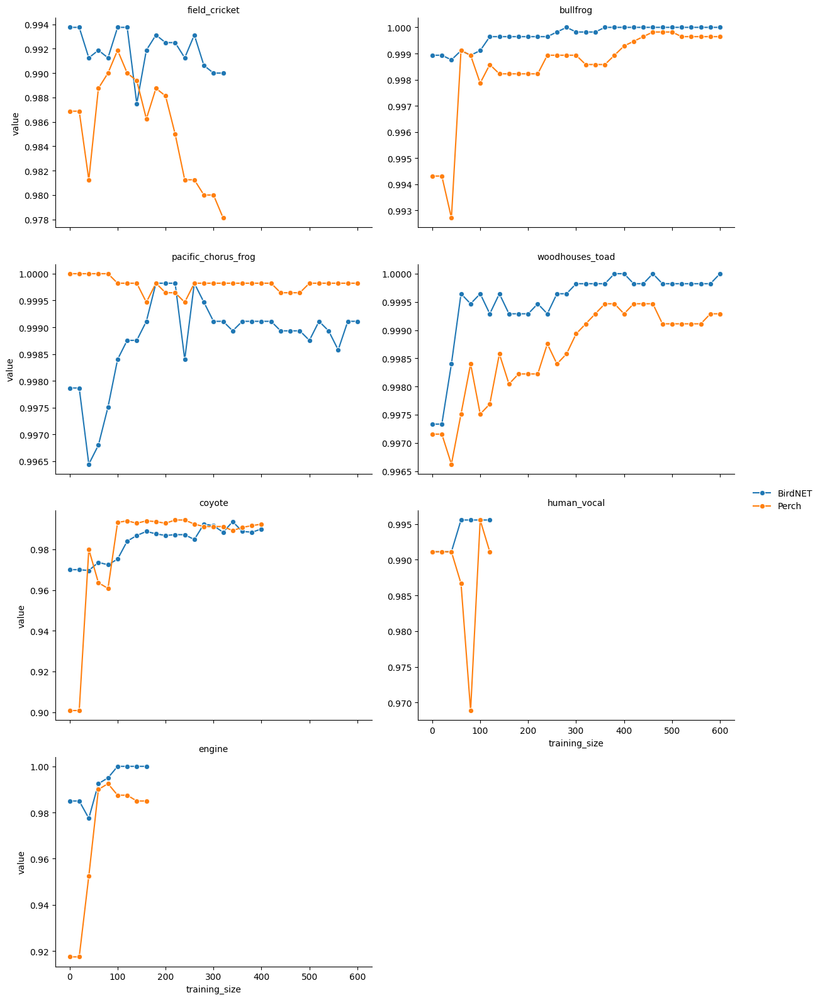

In [5]:
# Read and process all CSV files in the directory
results = [pd.read_csv(os.path.join(RESULTS_DIR, file)).assign(Species=file.split('-')[0])
    for file in os.listdir(RESULTS_DIR) if file.endswith(".csv")]

if results:
    results_df = pd.concat(results, ignore_index=True)
    results_df['training_size'] = results_df['train_size'].str.extract(r'_([^_]+)$').astype(int)

    df_melted = results_df.melt(id_vars=["Species", "training_size"], value_vars=["BirdNET", "Perch"], 
                                var_name="model", value_name="value")
    
    g = sns.FacetGrid(df_melted, col="Species", col_wrap=2, sharey=False, sharex=True, height=4, aspect=1.5)
    g.map_dataframe(sns.lineplot, x="training_size", y="value", hue="model", marker="o")
    g.add_legend()
    g.set_titles("{col_name}")
    g.tight_layout()
    plt.show()

else:
    print("No CSV files are there.")  